NAME: Manon LECLERCQ (B2b) et Maxime LUCE (A1a)


<b>Le fichier Jupyter et les images se trouvent sur Github https://github.com/MaximeLuce/color-image et ont été envoyés par mail au chargé de TD du groupe B2b avant la fin du temps imparti.</b>

⚠️ <b>Attention, l'éxecution complète du notebook prend plusieurs heures en raison du grand nombre d'images tests et de leurs tailles.</b>

# Introduction

La quantification de couleurs, ou réduction du nombre de couleurs dans une image, est une problématique centrale en traitement d’images. Elle consiste à représenter une image à l’aide d’un ensemble réduit de couleurs, tout en préservant au mieux son apparence visuelle. L’objectif de ce devoir est de mettre en œuvre un algorithme permettant de générer automatiquement une palette de couleurs optimale pour une image donnée. Cette palette devra être plus restreinte que le nombre de couleurs initialement présentes dans l’image, tout en restant la plus représentative possible de sa composition chromatique.

On retrouce ce processus dans de nombreux domaines d’application : compression d’images, affichage sur des périphériques à faible capacité graphique, création de versions simplifiées d’images pour l’impression ou le web, ou encore génération automatique de palettes pour le design graphique. Il est également utilisé dans des logiciels de traitement d’image comme Photoshop, Gimp ou Paint, et plus généralement dans tous les domaines où l’on cherche à simplifier une image sans en altérer la perception.

Sur le plan informatique, cette problématique soulève quelques questions algorithmiques : comment identifier les couleurs dominantes d’une image ? Comment choisir un bon compromis entre fidélité visuelle et nombre de couleurs utilisées ? Comment formaliser et mesurer la "représentativité" d’une palette ?

Ce devoir s’inscrit dans le prolongement du TD#4, où nous avons étudié le codage des couleurs en composantes rouge, verte et bleue (RGB). Nous allons ici approfondir cette notion en mettant en œuvre un algorithme de quantification de couleurs, en utilisant notamment les outils fournis par le langage Python et le module Pillow. Ce travail permet ainsi de mieux comprendre les enjeux liés à la représentation visuelle, à l’optimisation de données et à la perception humaine des couleurs.

Nous verrons dans un premier temps les fonctions générales qui seront utilisées durant tout le devoir, puis nous implémenterons une méthode naïve de quantification des couleurs et nous évoquerons ses limites, avant de mettre en place d'autres méthodes plus robustes utilisées dans les logiciels de traitement des images. Enfin, nous nous intéresserons au prétraitement des images avant de conclure quant aux performances des méthodes développées au corus de ce devoir.

# Sommaire


- [Introduction](#)
- [Sommaire](#)
- [Fonctions générales](#)
  - [Importation des modules](#)
    - Création et enregistrement de l'image test
  - [Récupération de toutes les couleurs constituant l'image et fréquences associées](#)
    - Test de couleurs_presentes
  - [Affichage de la palette](#)
    - Test : affichage de la palette des 4 couleurs constitutives de l'image test
  - [Recoloriage de l'image](#)
    - Test de la fonction recoloriage
- [Méthode de validation de notre approche](#)
  - [Calcul du score global d'erreur du recoloriage](#)
    - Test de la fonction score sur notre carré test de 4 couleurs initialement
  - [Affichage de la différence entre les deux images](#)
    - Test de la fonction difference sur notre carré de 4 couleurs : pour notre palette de 4 couleurs
- [Complexités spatiale et temporelle](#)
  - [Génération d'une image de taille variable avec des couleurs aléatoires](#)
    - Test de la génération aléatoire d'une image
  - [Complexité temporelle](#)
    - Test de la complexité temporelle
  - [Complexité spatiale](#)
    - [Approche quantitative](#)
    - [Détermination de la complexité théorique](#)
      - Méthode Naïve
      - Median Cut
      - Octree
      - K-Means
      - Fourier
    - Synthèse : complexité spatiale de nos algorithmes
- [Distances](#)
  - [Euclidienne](#)
    - Test de la fonction distance euclidienne
  - [Distance en espace CIELAB (Lab) : \$\Delta E 76\$](#)
    - Test de la fonction distance \$\Delta E 76\$
  - [Distance \$\Delta E 2000\$](#)
    - Test de la fonction distance \$\Delta E 2000\$
  - Synthèse comparative des différentes distances
- [Méthode naïve](#)
  - Chargement des images avec PIL
  - [Choix d'une palette de k couleurs : la méthode naïve](#)
    - Tri des couleurs par fréquence décroissante d'apparition et sélection des k couleurs de la palette
    - Application du recoloriage à l'image contenant le dégradé
  - [Méthode de validation de notre approche](#)
    - Calcul du score global d'erreur
    - Application de notre fonction différence au dégradé de couleurs
    - Quid d'augmenter le nombre de k couleurs arbitrairement ?
- [Median Cut Algorithm](#)
  - Test de la fonction Median Cut et recoloriage
- [Octree Algorithm](#)
  - Test de la méthode Octree
- [K-Means Algorithm](#)
  - Test de la méthode K-Means
- [Traitement avec Fourier](#)
  - Fourier en niveau de gris
  - Fourier sur YCbCr
  - Fourier en RGB
- [Traitement d'images par filtres](#)
  - [Flou gaussien](#)
    - Test de la fonction somme_matrice
    - Test du flou gaussien
  - [Filtres de type _sobely3_ et _sobelx3_](#)
    - Amélioration des filtres Sobel
    - Test et application de nos filtres
- [Synthèse comparative des méthodes développées](#)
  - Fonctions de synthèse
  - [Portrait de Lovelace](#)
    - Distance euclidienne
    - Distance \$\Delta E 76\$
    - Distance \$\Delta E 2000\$
  - [Paysage](#)
    - Distance euclidienne
    - Distance \$\Delta E 76\$
    - Distance \$\Delta E 2000\$
  - [Motif répétitif](#)
    - Distance euclidienne
    - Distance \$\Delta E 76\$
    - Distance \$\Delta E 2000\$
  - [Festival](#)
    - Distance \$\Delta E 2000\$
  - [Flowers](#)
    - Distance \$\Delta E 2000\$
  - [Robots](#)
    - Distance \$\Delta E 2000\$
  - [Texture fine](#)
    - Distance \$\Delta E 2000\$
  - [Architecture](#)
    - Distance \$\Delta E 2000\$
  - [Homme](#)
    - Distance \$\Delta E 2000\$
- [Optimisation](#)
    - [K-Means](#)
    - [Median Cut](#)
- [Conclusion](#)

# Fonctions générales

## Importation des modules

In [1]:
from math import sqrt
import math
from PIL import Image, ImageDraw
from IPython.display import display
import pandas as pd

import numpy as np
import matplotlib.pyplot as plt
import time
import random

## Création et enregistrement de l'image test

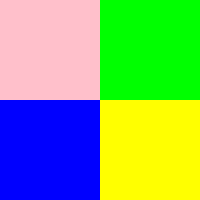

In [2]:
# Taille de l'image
W, H = 200, 200 # 2x2 carrés, chaque carré fait 100x100

# Définition des couleurs RGB que va contenir notre image
colors = [(255, 192, 203),     # Rose
    (0, 255, 0),     # Vert
    (0, 0, 255),     # Bleu
    (255, 255, 0)]    # Jaune


# Créer une nouvelle image RGB blanche
im_test = Image.new('RGB', (W, H), color=(255, 255, 255))
draw = ImageDraw.Draw(im_test)

# Dessiner les 4 carrés
carre = W // 2
positions = [
    (0, 0),              # en haut à gauche
    (carre, 0),          # en haut à droite
    (0, carre),          # en bas à gauche
    (carre, carre) # en bas à droite
]

for i, (x, y) in enumerate(positions):
    draw.rectangle([x, y, x + carre, y + carre], fill=colors[i])

# Sauvegarde de l'image au format PNG
im_test.save("quatre_carres.png")
display(im_test)

## Récupération de toutes les couleurs constituant l'image et fréquences associées

In [3]:
# Identification de toutes les couleurs de l'image et de leur fréquence
# Pour cela, on utilisera un dictionnaire qui stockera un tuple de couleurs pour la clé et la fréquence associée (le nombre de fois qu'on la retrouve dans l'image).
def couleurs_presentes(im):
    """
    Analyse les couleurs présentes dans une image et calcule leur fréquence.
    Parcourt chaque pixel de l'image fournie et recense toutes les couleurs (sous forme de tuples RGB), en comptant le nombre de fois où chaque couleur apparaît.

    Args :
        im (PIL.Image.Image) : L'image à analyser.

    Returns :
        dict : Un dictionnaire où les clés sont des tuples représentant les couleurs RGB,
               et les valeurs sont des entiers représentant la fréquence d'apparition de chaque couleur.
    """
    D = {}
    W, H = im.size
    px = im.load()

    # comptage des couleurs
    for i in range(W):
        for j in range(H):
            r,g,b = px[i, j] # on récupère la couleur de chaque pixel
            if (r,g,b) in D :
                D[(r,g,b)] += 1 # si la couleur du pixel a déjà été vue dans une autre partie de l'image, on augmente sa fréquence de 1
            else:
                D[(r,g,b)] = 1 # sinon, on l'ajoute au dictionnaire et on fixe son nombre de vue à 1 pour commencer
    return D

### Test de couleurs_presentes

In [4]:
dico_couleurs = couleurs_presentes(im_test)
print("Couleurs présentes et fréquences d'apparition :", dico_couleurs,"\n")

print("Nombre de couleurs différentes présentes dans le dégradé de couleurs :", len(dico_couleurs))

Couleurs présentes et fréquences d'apparition : {(255, 192, 203): 10000, (0, 0, 255): 10000, (0, 255, 0): 10000, (255, 255, 0): 10000} 

Nombre de couleurs différentes présentes dans le dégradé de couleurs : 4


On obtient alors bien les 4 couleurs qui nous ont permis de créer l'image de test : la fonction est validée.

## Affichage de la palette

On commence par créer une image blanche vide que l'on divisera horizontalement en k couleurs. Ainsi, les couleurs obtenues dans la liste "palette" seront affectées à une zone de cette image créée.

In [5]:
def afficher_palette(palette):
    """
    Affiche une palette de couleurs sous forme de bandeau horizontal.
    Crée une image composée de rectangles colorés, chacun représentant une couleur issue de la palette.
    Chaque rectangle a la même largeur et est dessiné côte à côte pour former un bandeau.

    Args :
        palette (list): Une liste de tuples où chaque élément est de la forme (couleur, fréquence),
                        avec couleur un tuple RGB (R, G, B). La fréquence est ignorée dans cette fonction.

    Returns :
        None : Affiche l'image dans l'environnement Jupyter via `display()`, mais ne retourne rien.
    """
    # Dimensions de la palette qui s'affichera à l ecran
    largeur_couleur = 500
    hauteur = 100
    k = len(palette)
    largeur = largeur_couleur * k

    # Création d'une image blanche
    bandeau = Image.new("RGB", (largeur, hauteur), "white")
    draw = ImageDraw.Draw(bandeau)

    # Remplissage avec les couleurs
    for i, (couleur, _) in enumerate(palette):
        x0 = i * largeur_couleur
        x1 = x0 + largeur_couleur
        draw.rectangle([x0, 0, x1, hauteur], fill=couleur)

    display(bandeau)

### Test : affichage de la palette des 4 couleurs constitutrices de l'image test

[((255, 192, 203), 10000), ((0, 0, 255), 10000), ((0, 255, 0), 10000), ((255, 255, 0), 10000)]


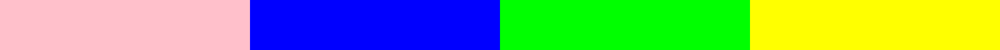

In [6]:
# On récupère uniquement les tuples rgb de notre liste de couleurs
palette_test = list(dico_couleurs.items())
print(palette_test)

# On affiche la palette avec notre fonction
afficher_palette(palette_test)

Les 4 couleurs présentes dans la palette sont désormais affichées !

## Recoloriage de l'image

L'idée ici est de re-colorier une image avec notre palette de couleurs et d'afficher le résultat sous forme d'image PIL.
Ainsi, pour re-colorier chaque pixel, on prend la couleur la plus proche dans la palette en utilisant une fonction de distance (Euclidienne pour commencer).


In [7]:
def recoloriage(img, palette, choix_distance):
    """
    Recolore une image en associant chaque pixel à la couleur la plus proche dans une palette donnée.
    Pour chaque pixel de l'image d'origine, la fonction calcule la distance entre sa couleur et toutes les couleurs de la palette. Elle remplace ensuite la couleur du pixel par celle de la palette ayant la distance minimale.

    Args :
        img (PIL.Image.Image) : L'image à recolorier.
        palette (list) : Une liste de tuples (couleur, fréquence), où `couleur` est un tuple RGB.
        choix_distance (function) : Une fonction prenant deux tuples RGB et retournant une distance numérique entre ces deux couleurs (ex. distance euclidienne, Manhattan, etc.).

    Returns :
        PIL.Image.Image : Une nouvelle image recoloriée, où chaque pixel est remplacé par la couleur la plus proche dans la palette.
    """
    W, H = img.size
    im_recolored = Image.new("RGB", (W, H))  # création de l'image en sortie
    px_new = im_recolored.load()
    px = img.load()

    for i in range(W):
        for j in range(H):
            indice = 0
            distance_opt = choix_distance(palette[0][0], px[i, j])  # distance avec la première couleur de la palette
            for m in range(len(palette)):
                distance = choix_distance(palette[m][0], px[i, j])
                if distance < distance_opt:
                    distance_opt = distance
                    indice = m
            px_new[i, j] = palette[indice][0]

    return im_recolored  # on retourne l'image recoloriée

Pour les besoins du test suivant, on définira ici une fonction distance euclidienne, qui sera reprise et expliquée plus tard dans ce devoir.

In [8]:
# création de la fonction distance euclidienne
def distance_euclid(c1: tuple, c2: tuple) -> float:
    """
    Calcule la distance euclidienne entre deux couleurs RGB.
    Cette distance est définie comme la racine carrée de la somme des carrés des différences entre les composantes rouges, vertes et bleues des deux couleurs.

    Args :
        c1 (tuple) : Première couleur, sous forme de tuple (R, G, B).
        c2 (tuple) : Deuxième couleur, sous forme de tuple (R, G, B).

    Returns :
        float : La distance euclidienne entre les deux couleurs.
    """
    (r1,g1,b1) = c1
    (r2,g2,b2) = c2
    return sqrt((r2-r1)**2 + (g2-g1)**2 + (b2-b1)**2)

### Test de la fonction recoloriage

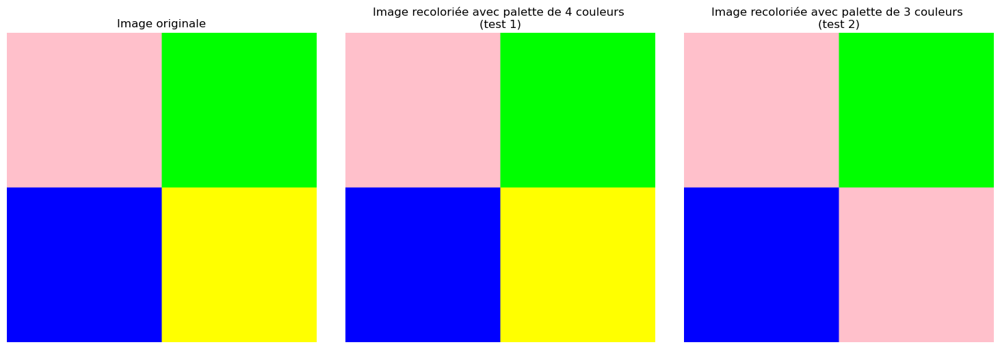

In [9]:
# On choisit ici une palette d'abord de 4 couleurs et ensuite de 3 couleurs afin de voir comment fonctionne notre algorithme
palette_test_2 = palette_test[0:3] # palette de 3 couleurs : rose, vert et bleu

# Affichage de l'image recoloriée
img_recoloriee_test = recoloriage(im_test, palette_test, distance_euclid) # image recoloriée avec palette de 4 couleurs
img_recoloriee_test_2 = recoloriage(im_test, palette_test_2, distance_euclid) # image recoloriée avec palette de 3 couleurs

# Affichage
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(im_test)
axs[0].set_title("Image originale")
axs[0].axis('off')

axs[1].imshow(img_recoloriee_test)
axs[1].set_title("Image recoloriée avec palette de 4 couleurs \n(test 1)")
axs[1].axis('off')

axs[2].imshow(img_recoloriee_test_2)
axs[2].set_title("Image recoloriée avec palette de 3 couleurs \n(test 2)")
axs[2].axis('off')

plt.tight_layout()
plt.show()

On observe que la fonction recoloriage recolorie fidèlement notre image dans le test 1 (au milieu) lorsqu'on lui met les 4 couleurs à disposition. Dans le test 2 (à droite), on ne lui confie uniquement 3 couleurs sur les 4 présentes dans l'image originale. La distance euclidienne en des composantes rgb du jaune étant plus proche de celle du rose que du vert ou du bleu, la fonction recolorie bien le carré jaune en bas à droite de l'image en rose.

La fonction recoloriage est donc validée !

## Méthode de validation de notre approche

Afin de valider (ou non) notre méthode naïve, nous calculerons dans cette partie l'erreur globale entre l'image originale et l'image recoloriée avant de visualiser la différence en affichant une image des erreurs.

### Calcul du score global d'erreur du recoloriage

In [10]:
def score(image_originale, image_recoloriee, choix_distance=distance_euclid):
    """
    Évalue la qualité du recoloriage en comparant chaque pixel de l'image d'origine avec celui de l'image recoloriée.

    La fonction calcule trois mesures d'erreur :
    - L'erreur totale : somme des distances entre chaque paire de pixels (original vs recolorié).
    - L'erreur moyenne : moyenne des distances par pixel.
    - Le pourcentage d'erreur : erreur moyenne normalisée par la distance maximale possible entre deux couleurs RGB.

    Paramètres :
        image_originale (PIL.Image.Image) : L'image d'origine non modifiée.
        image_recoloriee (PIL.Image.Image) : L'image générée après recoloriage.
        choix_distance (function) : Fonction utilisée pour calculer la distance entre deux couleurs.
                                    Par défaut, utilise la distance euclidienne.

    Retour :
        dict : Un dictionnaire contenant :
            - "erreur_totale" (float) : Somme totale des distances.
            - "erreur_moyenne" (float) : Moyenne des distances par pixel.
            - "pourcentage_erreur" (float) : Erreur normalisée entre 0 et 100 (%).
    """
    # On récupère les élements de l'image
    largeur, hauteur = image_originale.size
    pixels_orig = image_originale.load()
    pixels_reco = image_recoloriee.load()

    erreur_totale = 0

    # Parcours de tous les pixels de l'image
    for i in range(largeur):
        for j in range(hauteur):
            couleur1 = pixels_orig[i, j]         # pixel original
            couleur2 = pixels_reco[i, j]         # pixel recolorié
            erreur_totale += choix_distance(couleur1, couleur2)

    # Distance maximale possible entre deux couleurs RGB (du noir au blanc)
    distance_max = choix_distance((0,0,0),(255,255,255))

    # Erreur moyenne par pixel
    erreur_moyenne = erreur_totale / (largeur * hauteur)

    # Erreur normalisée en pourcentage
    pourcentage_erreur = (erreur_moyenne / distance_max) * 100

    return {
        "erreur_totale": round(erreur_totale, 2),
        "erreur_moyenne": round(erreur_moyenne, 2),
        "pourcentage_erreur": round(pourcentage_erreur, 2)
    }

#### Test de la fonction score sur notre carré test de 4 couleurs initialement

In [11]:
resultats = score(im_test, img_recoloriee_test, distance_euclid)
print("Le score du test 1 avec la palette de 4 couleurs \n")
print(f"Erreur globale totale : {resultats['erreur_totale']}")
print(f"Erreur moyenne par pixel : {resultats['erreur_moyenne']}")
print(f"Pourcentage d'erreur : {resultats['pourcentage_erreur']} % \n\n")

print("Le score du test 2 avec la palette de 3 couleurs \n")
resultats = score(im_test, img_recoloriee_test_2, distance_euclid)
print(f"Erreur globale totale : {resultats['erreur_totale']}")
print(f"Erreur moyenne par pixel : {resultats['erreur_moyenne']}")
print(f"Pourcentage d'erreur : {resultats['pourcentage_erreur']} %")

Le score du test 1 avec la palette de 4 couleurs 

Erreur globale totale : 0.0
Erreur moyenne par pixel : 0.0
Pourcentage d'erreur : 0.0 % 


Le score du test 2 avec la palette de 3 couleurs 

Erreur globale totale : 2125511.7
Erreur moyenne par pixel : 53.14
Pourcentage d'erreur : 12.03 %


Remarquons que lorsque l'image a été fidèlement recoloriée (test 1), il n'y a aucune erreur présente : ceci est cohérent. Cependant, dans le cas du test 2, une partie de l'image n'a pas été correctement retranscrite (rose à la place du jaune) : l'erreur n'est donc plus nulle.

### Affichage de la différence entre les deux images

On crée une image RGB représentant la différence entre l'image originale et l'image recoloriée. L'intensité du rouge est proportionnelle à l'erreur.

In [12]:
def difference(image_originale, image_recoloriee, choix_distance):
    """
    Génère une image représentant les différences entre une image originale et une image recoloriée.
    Chaque pixel de l'image retournée est coloré en rouge, avec une intensité proportionnelle à la distance entre les couleurs des pixels correspondants dans les deux images.
    Plus la différence est grande, plus le rouge est intense (max 255). Cette image permet de visualiser les zones où le recoloriage est le moins fidèle.

    Paramètres :
        image_originale (PIL.Image.Image) : L'image de référence (non modifiée).
        image_recoloriee (PIL.Image.Image) : L'image issue du recoloriage.
        choix_distance (function) : Fonction qui calcule une distance entre deux couleurs RGB.

    Retour :
        PIL.Image.Image : Une image en tons de rouge représentant l'erreur, redimensionnée à 50 % pour un affichage plus compact.
    """
    largeur = min(image_originale.width, image_recoloriee.width)
    hauteur = min(image_originale.height, image_recoloriee.height)

    px_orig = image_originale.load()
    px_reco = image_recoloriee.load()

    # Nouvelle image pour visualiser l’erreur (rouge = erreur forte)
    image_erreur = Image.new("RGB", (largeur, hauteur))
    px_error = image_erreur.load()

    for i in range(largeur):
        for j in range(hauteur):
            c1 = px_orig[i, j]       # couleur originale
            c2 = px_reco[i, j]       # couleur recoloriée
            d = int(choix_distance(c1, c2))  # distance euclidienne
            d = min(255, d)          # intensité maximale = 255

            px_error[i, j] = (d, 0, 0)  # rouge = différence

    return image_erreur.resize((largeur//2,hauteur//2))

#### Test de la fonction difference sur notre carré de 4 couleurs : pour notre palette de 4 couleurs

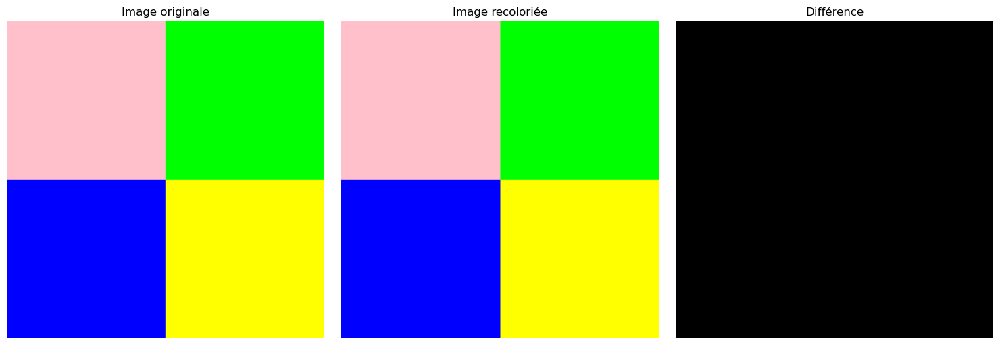

In [13]:
diff_test = difference(im_test, img_recoloriee_test, distance_euclid)

# Affichage
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(im_test)
axs[0].set_title("Image originale")
axs[0].axis('off')

axs[1].imshow(img_recoloriee_test)
axs[1].set_title("Image recoloriée")
axs[1].axis('off')

axs[2].imshow(diff_test)
axs[2].set_title("Différence")
axs[2].axis('off')

plt.tight_layout()
plt.show()

L'image recoloriée étant exactement la même que l'originale, il est cohérent que la différence entre les deux soit nulle (image noire). Prenons maintenant una palette constituée de deux couleurs uniquement.

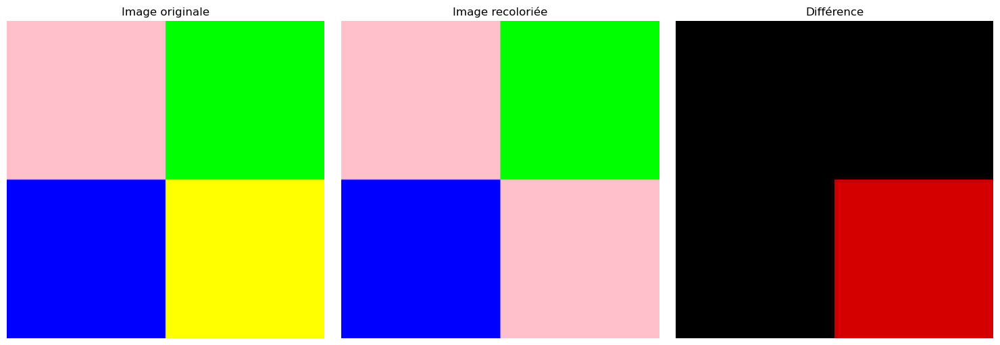

In [14]:
# Affichage de l'image recoloriée
diff_test_2 = difference(im_test, img_recoloriee_test_2, distance_euclid)

fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(im_test)
axs[0].set_title("Image originale")
axs[0].axis('off')

axs[1].imshow(img_recoloriee_test_2)
axs[1].set_title("Image recoloriée")
axs[1].axis('off')

axs[2].imshow(diff_test_2)
axs[2].set_title("Différence")
axs[2].axis('off')

plt.tight_layout()
plt.show()

On obtient bien une différence notable dans le carré jaune recoloriée en rose (en bas à droite de l'image).

Pour des images dont les erreurs sont assez proches, on peut avoir du mal à distinguer les zones qui concentre les erreurs. C'est la raison pour laquelle on propose cette autre fonction.

In [15]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from PIL import Image


def affichage_difference_3D(image_originale, image_recoloriee, choix_distance = distance_euclid):
    """
    Affiche visuellement les différences entre une image originale et une image recoloriée, à la fois en 2D (intensité rouge) et en 3D (barres de hauteur proportionnelle à l'erreur).

    La fonction calcule la distance entre les couleurs correspondantes dans les deux images à chaque pixel. Elle produit :
    - une image 2D montrant les erreurs en rouge (plus la différence est forte, plus le rouge est intense),
    - un graphique 3D (bar3D) où la hauteur de chaque barre représente l'intensité de la différence.

    Paramètres :
        image_originale (PIL.Image.Image) : L'image de référence à comparer.
        image_recoloriee (PIL.Image.Image) : L'image recoloriée à analyser.
        choix_distance (function, optionnel) : Fonction pour calculer la distance entre deux couleurs RGB. Par défaut, utilise la distance euclidienne.

    Retour :
        None : Affiche les visualisations à l'écran, mais ne retourne rien.
    """
    largeur = min(image_originale.width, image_recoloriee.width)
    hauteur = min(image_originale.height, image_recoloriee.height)

    px_orig = image_originale.load()
    px_reco = image_recoloriee.load()

    image_erreur = Image.new("RGB", (largeur, hauteur))
    px_error = image_erreur.load()

# Matrices de 0 créée
    distances = np.zeros((hauteur, largeur))

    for i in range(largeur):
        for j in range(hauteur):
            c1 = px_orig[i, j]
            c2 = px_reco[i, j]
            d = choix_distance(c1, c2)
            distances[j, i] = d  # Note: row = y = j, column = x = i

            d_int = int(min(255, d))
            px_error[i, j] = (d_int, 0, 0)

    # Affiche l'image erreur en 2D
    plt.figure(figsize=(6, 6))
    plt.title("Image des erreurs (rouge = forte différence)")
    plt.imshow(image_erreur.resize((largeur//2, hauteur//2)))
    plt.axis('off')
    plt.show()

    # Plot 3D
    x = np.arange(0, largeur)
    y = np.arange(0, hauteur)
    x, y = np.meshgrid(x, y)
    z = np.zeros_like(distances)
    dx = dy = 1
    dz = distances

    fig = plt.figure(figsize=(10, 7))
    ax = fig.add_subplot(111, projection='3d')
    ax.bar3d(x.ravel(), y.ravel(), z.ravel(), dx, dy, dz.ravel(), shade=True, color='red')
    ax.set_title("3D des erreurs (hauteur = intensité de la différence)")
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Erreur")
    plt.show()

Et on la teste :

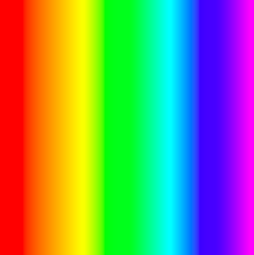

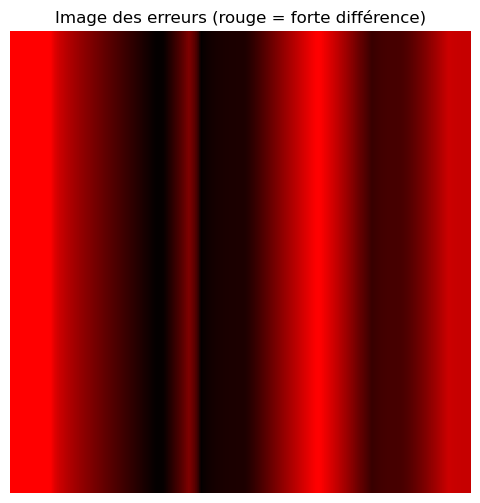

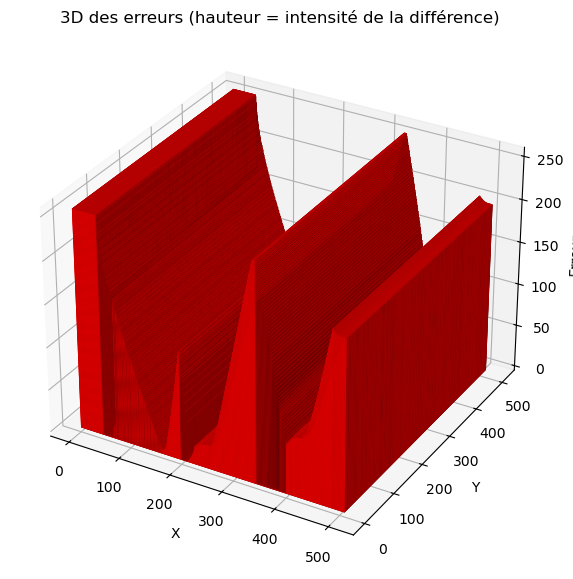

In [16]:
im_test_rainbow = Image.open("rainbow.png")
im_test_rainbow = im_test_rainbow.convert("RGB")  # important pour bien avoir 3 couleurs
px = im_test_rainbow.load()         

W, H = im_test_rainbow.size          # taille de l'image

#im = im.resize((W//2, H//2))

# redimensionnement de l'image
display(im_test_rainbow.resize((W//2, H//2)))             # on affiche l'image dans la cellule

dico_couleurs_rainbow = couleurs_presentes(im_test_rainbow)
palette_test_rainbow = list(dico_couleurs.items())
palette_test_rainbow = palette_test_rainbow[0:7]

img_recoloriee_test_rainbow = recoloriage(im_test_rainbow, palette_test_rainbow, distance_euclid)
# On affiche notre image des erreurs : plus c'est rouge et plus notre recoloriage est mauvais dans cet endroit
affichage_difference_3D(im_test_rainbow, img_recoloriee_test_rainbow, distance_euclid)

Ces deux résultats 2D et 3D sont cohérents.
Pour la suite de nos analyses, on a utilisé la visualisation 2D avec, ponctuellement, une visualisation 3D lorsque l'analyse est plus subtile.

Nos méthodes de validation sont désormais validées !

## Complexités spatiale et temporelle

Les complexités spatiale et temporelle sont des notions fondamentales en algorithmique, car elles permettent d’évaluer l’efficacité d’un algorithme. La complexité temporelle mesure le temps d’exécution en fonction de la taille des données, tandis que la complexité spatiale estime la quantité de mémoire nécessaire.

Ces deux complexités permettront de comparer différents algorithmes et de choisir celui qui sera le plus adapté à notre problème, notamment lorsqu’il s’agit de traiter de grandes quantités de données (taille d'images importante) ou de respecter des contraintes de performance.

### Génération d'une image de taille variable avec des couleurs aléatoires

Pour les besoins de fonctionnement de nos algorithmes de test de complexité de nos différentes méthodes , nous créons une fonction capable de générer aléatoirement une image de dimension W x H.

In [17]:
# Génération d'une image de taille variable avec des couleurs aléatoires
def genere_img(W, H):
    """
    Génère une image RGB aléatoire de dimensions spécifiées.
    Chaque pixel de l'image est attribué à une couleur aléatoire, dont les composantes rouge, verte et bleue sont tirées uniformément entre 0 et 255. Cela permet de créer une image de test variée et non structurée.

    Paramètres :
        W (int) : Largeur de l'image (en pixels).
        H (int) : Hauteur de l'image (en pixels).

    Retour :
        PIL.Image.Image : Une image RGB de dimensions (W x H) remplie de couleurs aléatoires.
    """
    img = Image.new("RGB", (W, H))
    for x in range(W):
        for y in range(H):
            img.putpixel((x, y), tuple(random.randint(0, 255) for _ in range(3)))
    return img

#### Test de la génération aléatoire d'une image

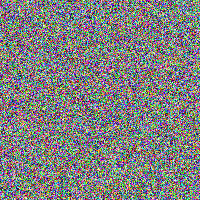

In [18]:
# On choisit arbitrairement de générer une image carrée 100x100
im_aleatoire = genere_img(200,200)
display(im_aleatoire)

On obtient une image contenant des pixels de différentes couleurs, bien générés aléatoirement parmi toutes les composantes RGB possibles : la fonction genere_img est validée !

### Complexité temporelle
L'objectif d'un calcul de complexité algorithmique temporelle est de pouvoir comparer l'efficacité d'algorithmes résolvant le même problème. Dans une situation donnée, cela permet donc d'établir lequel des algorithmes disponibles est le plus optimal.

Dans cette section, nous comparons le temps d'exécution des différents algorithmes sur une même image générée aléatoirement.

<b>NB : Attention ! cette section est à exécuter une fois que l'entiereté du code ait été exécutée car elle nécessite des fonctions qui sont codées par la suite. Nous avons tout de même fait le choix de présenter cette section complexité en amont pour une meilleure lecture de notre devoir. </b>

La fonction complexite_temporelle permet, pour une distance et un algorithme donné, de générer un graphique présentant le temps d'execution du choix de la palette et du recoloriage pour différentes tailles d'images.

In [19]:
def complexite_temporelle(type_algo = "naif", distance=distance_euclid):
     """
    Évalue empiriquement la complexité temporelle d'un algorithme de recoloriage en fonction de la taille de l'image.
    Cette fonction génère des images carrées de tailles croissantes avec des couleurs aléatoires, applique l'algorithme de recoloriage choisi, mesure le temps d'exécution, puis trace une courbe du temps en fonction du nombre total de pixels.

    Paramètres :
        type_algo (str) : Le nom de l'algorithme à tester parmi :
                          - "naif"
                          - "median_cut"
                          - "kmeans"
                          - "fourier_YCbCr"
                          - "octree"
        distance (function) : Fonction utilisée pour calculer la distance entre deux couleurs (par défaut : distance euclidienne).

    Affiche :
        Un graphique matplotlib représentant le temps d'exécution (en secondes) en fonction du nombre total de pixels.
    """
    
     # Mesure du temps d'exécution
     k=8
     nb_iter=10
     n=math.floor(math.log(k)/math.log(2))
    
     taille_images = [16, 32, 64, 96, 128, 160, 192, 224, 275, 300, 350, 400]
     temps = []
     for taille in taille_images:
         img = genere_img(taille, taille) # on prendra des images de taille carrée pour simplifier (mais le nombre de pixelx total restera inchangé que
         # l'image soit carrée ou rectangulaire)
         start = time.time() # départ du chronomètre
        
         if type_algo == "naif":
             img_methode_naive, palette_naive = methode_naive(img, choix_distance,k)
         if type_algo == "median_cut":
             img_median_cut = recoloriage_MedianCut(img, n, choix_distance)
         if type_algo == "kmeans":
            img_k_means = kmeans(img, k, nb_iter, choix_distance)
         if type_algo == "fourier_YCbCr":
             img_fourier_YCbCr, palette_YCbCr = traitement_image_par_mode(img, mode="YCbCr", k=k)
         if type_algo == "fourier_RGB":
            img_fourier_RGB, palette_RGB = traitement_image_par_mode(img, mode="RGB", k=k)
         if type_algo == "octree":
             img_octree, pallette_octree = image_octree(img, k, choix_distance)
            
         end = time.time() # arrêt du chronomètre
         temps.append(end - start) # mesure de la durée totale d'exécution

     # Affichage du graphique
     plt.figure(figsize=(10, 5))
     nb_pixels = [x * x for x in taille_images]
     plt.plot(nb_pixels, temps, marker='o', color='blue')
     plt.xlabel("Nombre de pixels présents dans l'image")
     plt.ylabel("Temps d'exécution (en s)")
     plt.title("Temps d'exécution de Median Cut en fonction de la taille de l'image")
     plt.grid()
     plt.show()

#### Test de la complexité temporelle

In [20]:
#complexite_temporelle("naif", distance_euclid)

La fonction complexite_temp_algos permet, quant à elle, de comparer la complexité temporelle pour les différents algorithmes.

In [21]:
def complexite_temp_algos(choix_distance=distance_euclid):
    """
    Compare les temps d'exécution de différents algorithmes de réduction de palette en fonction de la taille de l'image.
    Pour chaque taille spécifiée, une image carrée à couleurs aléatoires est générée une seule fois et utilisée pour tester  plusieurs algorithmes de recoloriage. Le temps d'exécution de chaque algorithme est mesuré, puis un graphique comparatif est affiché pour évaluer leur complexité empirique.

    Paramètres :
        choix_distance (function) : Fonction de distance utilisée pour la comparaison des couleurs (par défaut : distance_euclid).

    Retour :
        list : Une liste contenant la figure matplotlib générée (permet d'enregistrer ou manipuler la figure en dehors de la fonction).

    Affiche :
        Un graphique en ligne comparant les temps d'exécution en fonction du nombre de pixels de l'image.
    """
    k = 8
    nb_iter = 10
    n = math.floor(math.log(k) / math.log(2))
    taille_images = [16, 32, 64, 96, 128, 160, 192, 224, 275, 300, 350, 400]
    nb_pixels = [x * x for x in taille_images]

    # Générer une image par taille, une seule fois
    images_par_taille = {taille: genere_img(taille, taille) for taille in taille_images}

    # Liste des algorithmes avec leur nom
    algos = [
        ("Median Cut", lambda img: recoloriage_MedianCut(img, n, choix_distance)),
        ("Octree", lambda img: image_octree(img, k, choix_distance)),
        ("K-means", lambda img: kmeans(img, k, nb_iter, choix_distance)),
        ("Méthode naïve", lambda img: methode_naive(img, choix_distance, k)),
        ("Fourier YCbCr", lambda img: traitement_image_par_mode(img, mode="YCbCr", k=k)),
        ("Fourier RGB", lambda img: traitement_image_par_mode(img, mode="RGB", k=k)),
    ]

    fig, ax = plt.subplots(figsize=(12, 6))

    # Boucle sur les algos pour mesurer les temps
    for nom, fonction_algo in algos:
        temps = []
        for taille in taille_images:
            img = images_par_taille[taille]
            start = time.time()
            fonction_algo(img)
            end = time.time()
            temps.append(end - start)
        ax.plot(nb_pixels, temps, marker='o', label=nom)

    # Mise en forme du graphique
    ax.set_xlabel("Nombre de pixels présents dans l'image")
    ax.set_ylabel("Temps d'exécution (en s)")
    ax.set_title("Comparaison des temps d'exécution selon la taille de l'image (même image pour tous les algos)")
    ax.grid()
    ax.legend()
    fig.tight_layout()

    return [fig]

Les figures suivantes ont été obtenues :

<img src="img_notebook/octree_grandes.PNG" />
On observe que l'algorithme Octree explose en temps pour des images assez grandes. Concrètement, lors des tests qui seront présentés dans la section <b>Synthèse comparative des méthodes développées</b>, plusieurs heures sont nécessaires selon les tailles d'images pour que l'algorithme se termine.
Ainsi, Octree n'est pas un algorithme à privilégier pour des images de grandes tailles et un résultat rapide.

<img src="img_notebook/grandes_images_sans_octree.png" />
En retirant Octree de l'affichage, on peut désormais distinguer les différents autres algorithmes. Le plus rapide est bien sûr l'algorithme naïf, suivi de près par Median Cut. Après, il y a l'algorithme de Fourier Grayscale, c'est-à-dire uniquement sur le niveau de gris.
Plus haut encore, on trouve l'algorithme K-Means qui est moins couteux deux autres algorithmes utilisant la transformée de Fourier (Fourier RGB et Fourier YCbCr). Il est normal que le temps d'execution de ces deux derniers algorithmes soient élevés puisqu'ils réalisent une transformée de fourier sur chacune des composantes colorimétriques (3 en l'occurence).

<img src="img_notebook/petites_images.png" />
Pour des petites images, il y a quelques fluctuations mais le constat reste le même entre les différents algorithmes.

## Complexité spatiale

L’évaluation de la complexité spatiale des algorithmes de traitement d’image est essentielle pour déterminer leur efficacité en termes d’utilisation des ressources mémoire. En effet, certains algorithmes peuvent produire des résultats similaires sur le plan visuel tout en consommant des quantités de mémoire très différentes.

Comprendre et comparer cette complexité nous permettra ainsi de conclure sur l'efficacité des nos différents algorithmes.

### Approche quantitative
Nous avons commencé par quantifier le nombre d'opérations pour l'algorithme Median Cut très naivement à l'aide d'un compteur qu'on incrémente à chaque opération. On affiche alors la courbe pour différentes tailles d'image.

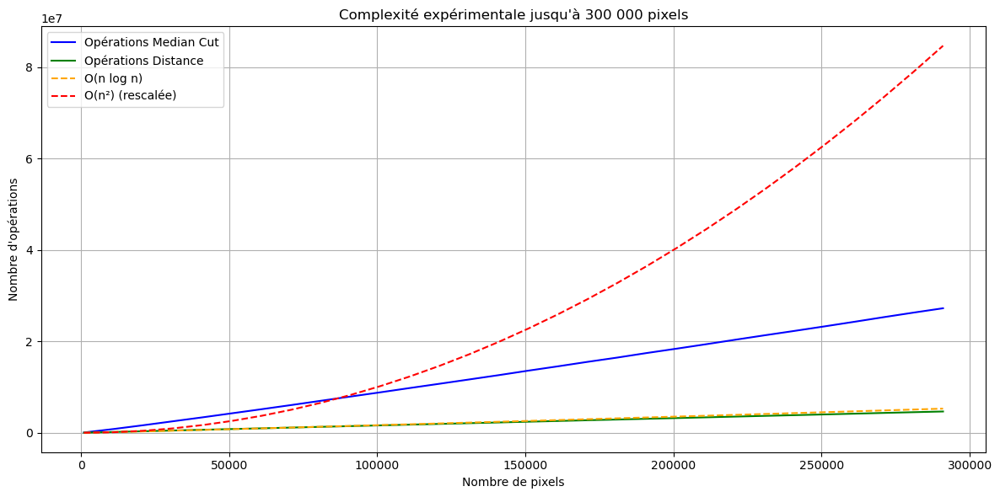

In [22]:
from PIL import Image
import matplotlib.pyplot as plt
import random
import math

compteur_ops = {"median_cut": 0, "distance": 0} # compteur global

# Fonctions identiques

def distance_euclid(c1, c2):
    """Calcule la distance euclidienne entre deux coordonnées de couleur.

    Paramètres:
        c1 (tuple): Un tuple représentant la première couleur (R, G, B).
        c2 (tuple): Un tuple représentant la deuxième couleur (R, G, B).

    Retour:
        float: La distance euclidienne entre les deux couleurs.
    """
    compteur_ops["distance"] += 1
    return sum((a - b) ** 2 for a, b in zip(c1, c2)) ** 0.5

def median_cut(pixels, profondeur):
    """Applique l'algorithme de "median cut" pour réduire le nombre de couleurs dans une liste de pixels.

    L'algorithme divise récursivement l'espace colorimétrique en fonction de la médiane
    de la plage de couleurs la plus étendue.

    Paramètres:
        pixels (list): Une liste de tuples représentant les couleurs des pixels (R, G, B).
        profondeur (int): Le nombre de niveaux de division à effectuer.
                         Une profondeur de 0 retourne la couleur moyenne des pixels.

    Retour:
        list: Une liste de tuples représentant la palette de couleurs résultante.
    """
    if profondeur == 0 or len(pixels) == 0:
        r = sum(p[0] for p in pixels) // len(pixels)
        g = sum(p[1] for p in pixels) // len(pixels)
        b = sum(p[2] for p in pixels) // len(pixels)
        compteur_ops["median_cut"] += len(pixels) * 3
        return [(r, g, b)]
    ranges = [(max(p[i] for p in pixels) - min(p[i] for p in pixels), i) for i in range(3)]
    compteur_ops["median_cut"] += len(pixels) * 6
    _, channel = max(ranges)
    pixels.sort(key=lambda x: x[channel])
    compteur_ops["median_cut"] += len(pixels) * math.log2(len(pixels) + 1)
    median = len(pixels) // 2
    return median_cut(pixels[:median], profondeur - 1) + median_cut(pixels[median:], profondeur - 1)

def recoloriage_MedianCut(im, profondeur):
    """Réduit le nombre de couleurs d'une image en utilisant l'algorithme de "median cut".

    Paramètres:
        im (PIL.Image.Image): L'image à recolorier.
        profondeur (int): Le nombre de niveaux de division pour l'algorithme "median cut".
                          Détermine la taille de la palette de couleurs résultante (2^profondeur).

    Retour:
        PIL.Image.Image: Une nouvelle image avec un nombre de couleurs réduit.
    """
    px = im.load()
    W, H = im.size
    pixels = [px[x, y] for y in range(H) for x in range(W)]
    palette = median_cut(pixels, profondeur)
    new_img = Image.new("RGB", im.size)
    for y in range(H):
        for x in range(W):
            originale = px[x, y]
            _ = min(palette, key=lambda c: distance_euclid(originale, c))
    return new_img

def generate_random_image(num_pixels):
    """Génère une image RVB aléatoire avec le nombre de pixels spécifié.

    Paramètres:
        num_pixels (int): Le nombre total de pixels souhaité pour l'image.

    Retour:
        PIL.Image.Image: Une image RVB aléatoire.
    """
    width = int(math.sqrt(num_pixels))
    height = (num_pixels + width - 1) // width  # pour éviter les pertes
    img = Image.new("RGB", (width, height))
    for x in range(width):
        for y in range(height):
            if y * width + x < num_pixels:
                img.putpixel((x, y), tuple(random.randint(0, 255) for _ in range(3)))
    return img

# Mesure sur une plage large de pixels
profondeur = 4
nb_pixels = list(range(1000, 300001, 10000))  # de 1k à 300k par pas de 10k

ops_median_cut = []
ops_distance = []

for n in nb_pixels:
    img = generate_random_image(n)
    compteur_ops = {"median_cut": 0, "distance": 0}
    recoloriage_MedianCut(img, profondeur)
    ops_median_cut.append(compteur_ops["median_cut"])
    ops_distance.append(compteur_ops["distance"])

# Plot
plt.figure(figsize=(12, 6))
plt.plot(nb_pixels, ops_median_cut, label="Opérations Median Cut", color='blue')
plt.plot(nb_pixels, ops_distance, label="Opérations Distance", color='green')
plt.plot(nb_pixels, [n * math.log2(n + 1) for n in nb_pixels], '--', label="O(n log n)", color='orange')
plt.plot(nb_pixels, [n**2 / 1000 for n in nb_pixels], '--', label="O(n²) (rescalée)", color='red')

plt.xlabel("Nombre de pixels")
plt.ylabel("Nombre d'opérations")
plt.title("Complexité expérimentale jusqu'à 300 000 pixels")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


On peut comparer ce graphique à celui figurant ci-dessous présentant les différents niveaux de complexité et leur niveau d'acceptabiblité pour un usage pratique (plus la complexité est élevée, moins il est pratique de se servir rapidement de l'algorithme et plus les ressources nécessaires à son bon fonctionnement sont imporantes).

 <figure>
  <img src="img_notebook/big_O_complexity.png" />
  <figcaption>Big-O complexity chart</figcaption>
</figure> 

Par ailleurs, on peut évaluer la complexité des algorithmes en fonction de $n$ le nombre d'opérations.

### Détermination de la complexité théorique

#### Méthode Naïve
Principaux éléments mémoire :

- Image d'entrée (PIL) : ~4n octets
- Dictionnaire dico_couleurs : jusqu’à n couleurs uniques
  - chaque clé (tuple RGB) ~60 octets, chaque valeur (int compteur) ~28 octets
  - ~88 × u (avec u ≤ n), donc O(n) → ~88n max
- Palette de k couleurs : k × 60 → négligeable
- Nouvelle image PIL : ~4n octets

Estimation mémoire totale : $\mathcal{O}(n)$
En pratique : ~(4n + 88n + 4n) = ~96n octets dans le pire cas (couleurs très diverses)

#### Median Cut
Principaux éléments mémoire :

- Image originale (PIL) : ~4n octets
- Liste de pixels : pixels = liste de n tuples (R, G, B)
    - n références (8 octets) + n × 60 octets → ~68n octets

- Appels récursifs sur sous-listes (partagées ou dupliquées)
    - En général, pas plus de log(k) sous-listes actives, pas toutes dupliquées
    - Espace supplémentaire négligeable
- Palette (2^profondeur couleurs) : typiquement k × 60 → négligeable
- Nouvelle image PIL : ~4n octets

Estimation mémoire totale : $\mathcal{O}(n)$
En pratique, ~4n (entrée) + 68n (liste) + 4n (image) = ~76n octets

#### Octree
Principaux éléments mémoire :

- Image d’entrée (PIL) : ~4n octets
- Liste des pixels : ~68n octets
- Octree :
    - Au plus 1 nœud par pixel (feuille) → jusqu’à n nœuds
    - Chaque nœud ≈
      - somme_couleur (3 floats) : 3 × 8 = 24 octets
      - nb_pixels : 4 à 8 octets
      - enfants : 8 pointeurs → 8 × 8 = 64 octets
      - autres champs ~40 octets
      - Total ~140 octets par nœud → ~140n octets
- Réducteur : 9 listes contenant des pointeurs → négligeable
- Palette (k couleurs) : négligeable
- Image recolorisée : ~4n octets

Estimation mémoire totale : $\mathcal{O}(n)$
En pratique, ~4n (entrée) + 68n (liste) + 140n (octree) + 4n (image) = ~216n octets

> Octree est le plus coûteux en mémoire.

#### K-Means
Principaux éléments mémoire :

- Image d’entrée (PIL) : 4n octets
- Liste des pixels : ~68n octets
- Clusters : liste de k sous-listes, contenant n pixels au total → O(n)
    - ~68n octets
- Centroïdes (k couleurs) : ~60k octets → négligeable
- Nouvelle image PIL : 4n octets

Estimation mémoire totale : $\mathcal{O}(n)$
En pratique, ~4n (entrée) + 68n (liste) + 68n (clusters) + 4n (image) = ~144n octets

#### Fourier

On peut montrer que l'algorithme utilisé présente une complexité en $\mathcal{O}(n \log n)$ (cf. https://imss-www.upmf-grenoble.fr/prevert/Prog/Complexite/fourier.html)
    
### Synthèse : complexité spatiale de nos algorithmes

| Algorithme    | Complexité mémoire | Estimation en octets | Éléments dominants          |
| ------------- | ------------------ | -------------------- | --------------------------- |
| Méthode naïve | O(n)               | \~96n                | Dictionnaire couleurs       |
| Median Cut    | O(n)               | \~76n                | Liste de pixels + image     |
| Octree        | O(n)               | **\~216n**           | Arbre Octree (noeuds)       |
| K-Means       | O(n)               | \~144n               | Clusters (listes de pixels) |


## Distances

Le choix de la fonction de distance entre couleurs est crucial lorsque l'on souhaite créer une palette de k couleurs à partir d'une image originale, parce que cette distance influe directement sur le rendu visuel final.

La notion de distance entre couleurs peut être utilisée pour réduire le nombre de couleurs d’une image, compresser une image, segmenter une image, évaluer une tolérance ou une transparence.

Dans ce devoir, nous utiliserons trois types de distance : la distance euclidienne en RGB, la distance en espace CIELAB $\Delta E 76$ et la distance $\Delta E 2000$ (utilisée en colorimétrie).

### Euclidienne
$ d = \sqrt{(R_1-R_2)^2 + (G_1 - G_2)^2 + (B_1-B_2)^2}$

In [23]:
def distance_euclid(c1: tuple, c2: tuple) -> float:
    """Calcule la distance euclidienne entre deux couleurs représentées par des tuples.

    Paramètres:
        c1 (tuple): Un tuple de trois entiers représentant la première couleur (Rouge, Vert, Bleu).
        c2 (tuple): Un tuple de trois entiers représentant la deuxième couleur (Rouge, Vert, Bleu).

    Retour:
        float: La distance euclidienne entre les deux couleurs.
    """
    (r1,g1,b1) = c1
    (r2,g2,b2) = c2
    return sqrt((r2-r1)**2 + (g2-g1)**2 + (b2-b1)**2)

#### Test de la fonction distance euclidienne

In [24]:
# test :
rgb1 = (0, 0, 0)
rgb2 = (255, 255, 255)
distance_euclid(rgb1,rgb2)

441.6729559300637

Sachant que la distance maximale euclidienne entre 2 pixels est d'environ 442, notre fonction est validée !

Faisons les test dans l'espace Lab en utilisant des valeurs déjà connues.

In [25]:
# Même point : distance = 0
assert abs(distance_euclid((50, 0, 0), (50, 0, 0))) < 1e-6, "Erreur : distance entre points identiques doit être 0"

# Déplacement unitaire sur chaque axe
assert abs(distance_euclid((0, 0, 0), (1, 0, 0)) - 1) < 1e-6, "Erreur : distance L* incorrecte"
assert abs(distance_euclid((0, 0, 0), (0, 1, 0)) - 1) < 1e-6, "Erreur : distance a* incorrecte"
assert abs(distance_euclid((0, 0, 0), (0, 0, 1)) - 1) < 1e-6, "Erreur : distance b* incorrecte"

# Distance diagonale simple
d = distance_euclid((0, 0, 0), (1, 1, 1))
assert abs(d - sqrt(3)) < 1e-6, f"Erreur : distance diagonale incorrecte ({d} ≠ {sqrt(3)})"

# Symétrie
p1 = (10, 20, 30)
p2 = (40, 50, 60)
assert abs(distance_euclid(p1, p2) - distance_euclid(p2, p1)) < 1e-6, "Erreur : la distance n'est pas symétrique"

print("Tous les tests de distance euclidienne dans l'espace Lab sont passés avec succès.")

Tous les tests de distance euclidienne dans l'espace Lab sont passés avec succès.


Notre fonction distance euclidenne est désormais testée et approuvée !

### Distance en espace CIELAB (Lab) : $\Delta E 76$

$ \rightarrow$ distance euclidienne entre deux couleurs dans l'espace Lab : 
$ d = \sqrt{(L_1-L_2)^2 + (a_1 - a_2)^2 + (b_1-b_2)^2}$

Recherches basées sur le cours de l'Institut d'Optique Graduate School : https://www.labri.fr/perso/granier/Cours/IOGS/color/cours1.pdf et sur l'article https://www.datacolor.com/wp-content/uploads/2023/05/color-management-ebook-4-fr.pdf pour la compréhension de l'espace de couleur CIELAB.

In [26]:
"""
ETAPE 1 : Conversion RGB en coordonnées XYZ
"""

def rgb_en_xyz(r, g, b):
    """Convertit les composantes RGB d'une couleur en coordonnées XYZ.

    Paramètres:
        r (int): La composante rouge (0-255).
        g (int): La composante verte (0-255).
        b (int): La composante bleue (0-255).

    Retour:
        tuple: Un tuple de trois floats représentant les coordonnées XYZ.
    """
    # On commence par normaliser les composantes RGB entre 0 et 1
    r = r / 255.0
    g = g / 255.0
    b = b / 255.0

    # Correction gamma (inverse de la transformation sRGB)
    def gamma(u):
        # Si la composante est supérieure à un seuil, on applique une formule non linéaire
        if u > 0.04045 :
            return ((u + 0.055) / 1.055) ** 2.4
        else :
            return u / 12.92

    # Application de la correction gamma à chaque composante
    r = gamma(r)
    g = gamma(g)
    b = gamma(b)

    # Coefficients basés sur les normes CIE
    x = r * 0.4124 + g * 0.3576 + b * 0.1805
    y = r * 0.2126 + g * 0.7152 + b * 0.0722
    z = r * 0.0193 + g * 0.1192 + b * 0.9505

    return x, y, z


"""
ETAPE 2 : Conversion XYZ en CIELAB
"""
def xyz_en_lab(x, y, z):
    """Convertit les coordonnées XYZ d'une couleur en coordonnées CIELAB.

    Paramètres:
        x (float): La coordonnée X.
        y (float): La coordonnée Y (luminance relative).
        z (float): La coordonnée Z.

    Retour:
        tuple: Un tuple de trois floats représentant les coordonnées CIELAB (L, a, b).
    """
    
    # Valeurs de référence du blanc D65 (illuminant standard)
    Xn, Yn, Zn = 0.95047, 1.00000, 1.08883

    # On normalise les valeurs XYZ en divisant par les valeurs de référence
    x /= Xn
    y /= Yn
    z /= Zn

    # Fonction f(t) utilisée pour la transformation non linéaire
    def f(t):
        if t > 0.008856: # Si t est suffisamment grand, on prend la racine cubique
            return t ** (1/3)
        else:         # Sinon, on applique une fonction affine
            return (7.787 * t) + (16 / 116)

    # Application de f(t) à chaque composante normalisée
    fx = f(x)
    fy = f(y)
    fz = f(z)

    # Formules finales de conversion XYZ → Lab
    L = 116 * fy - 16      # Luminance
    a = 500 * (fx - fy)    # Différence entre rouge et vert
    b = 200 * (fy - fz)    # Différence entre jaune et bleu

    return L, a, b  # On retourne la couleur en espace Lab


"""
ETAPE 3 : Conversion RGB en Lab
"""
def rgb_en_lab(rgb):
    """Convertit un tuple de composantes RGB en coordonnées CIELAB.

    Paramètres:
        rgb (tuple): Un tuple de trois entiers représentant la couleur (Rouge, Vert, Bleu).

    Retour:
        tuple: Un tuple de trois floats représentant les coordonnées CIELAB (L, a, b).
    """
    # On décompose le tuple (R, G, B)
    x, y, z = rgb_en_xyz(*rgb)
    # On convertit XYZ en Lab
    return xyz_en_lab(x, y, z)

"""
ETAPE 4 : Calcul de la distance euclidienne entre deux couleurs Lab
"""

def distance_lab(rgb1, rgb2): # rgb1 de la forme px[i,j]
    """Calcule la distance euclidienne entre deux couleurs RGB dans l'espace colorimétrique CIELAB.

    Paramètres:
        rgb1 (tuple): Un tuple de trois entiers représentant la première couleur (Rouge, Vert, Bleu).
        rgb2 (tuple): Un tuple de trois entiers représentant la deuxième couleur (Rouge, Vert, Bleu).

    Retour:
        float: La distance euclidienne entre les deux couleurs dans l'espace Lab.
    """
    # On convertit les deux couleurs de RGB vers Lab
    l1,a1,b1 = rgb_en_lab(rgb1)
    l2,a2,b2 = rgb_en_lab(rgb2)
    # On applique la formule de distance euclidienne dans l’espace Lab
    return sqrt((l1-l2)**2 +(a1-a2)**2 + (b1-b2)**2)

#### Test de la fonction distance $\Delta E 76$

In [27]:
# Couleurs identiques : distance nulle
assert abs(distance_lab((255, 0, 0), (255, 0, 0))) < 1e-6, "Erreur : la distance entre deux rouges identiques doit être 0"

# Couleurs très différentes : distance élevée
d_red_blue = distance_lab((255, 0, 0), (0, 0, 255))
assert d_red_blue > 100, f"Erreur : distance rouge / bleu trop faible ({d_red_blue})"

# Noir et blanc : distance maximale (dans les extrêmes de luminance)
d_black_white = distance_lab((0, 0, 0), (255, 255, 255))
assert d_black_white > 100, f"Erreur : distance noir / blanc trop faible ({d_black_white})"

# Couleurs proches : distance faible
d_light_gray = distance_lab((200, 200, 200), (210, 210, 210))
assert d_light_gray < 5, f"Erreur : distance entre gris clairs trop élevée ({d_light_gray})"

# Test symétrie (d(a,b) == d(b,a))
a = (123, 200, 45)
b = (20, 10, 200)
assert abs(distance_lab(a, b) - distance_lab(b, a)) < 1e-6, "Erreur : la distance n'est pas symétrique"

print("Tous les tests de distance ΔE 76 sont passés avec succès")

Tous les tests de distance ΔE 76 sont passés avec succès



Cependant, cette distance ne tient pas compte de la sensibilité humaine aux couleurs : il surestime certaines différences (par exemple dans les bleus) et en sous-estime d'autres (dans les gris ou verts).

### Distance $\Delta E 2000$ 

$\Delta E 2000$ (ou $\Delta E00$) tient compte de la non-uniformité de Lab en introduisant une compensation sur la luminosité, la chroma (intensité de couleur) et la teinte (hue), des facteurs de pondération ainsi qu'un facteur de rotation Rt qui corrige certains effets visuels dans les bleus.

La formule est $\Delta E_{00} = \sqrt{
\left(\frac{\Delta L'}{k_L \cdot S_L}\right)^2 \!+\! 
\left(\frac{\Delta C'}{k_C \cdot S_C}\right)^2 \!+\! 
\left(\frac{\Delta H'}{k_H \cdot S_H}\right)^2 \!+\! 
R_T \cdot \frac{\Delta C'}{k_C \cdot S_C} \cdot \frac{\Delta H'}{k_H \cdot S_H}
}
$.

Les formules utilisées dans le code suivant sont tirées de cet article : https://www.normaprint.fr/blog/iso-12647-22013-deltae2000-versus-deltae76/.

In [28]:
from math import sqrt, sin, cos, radians, degrees, atan2, exp

def delta_e_2000(rgb1, rgb2):
    """Calcule la différence de couleur Delta E 2000 entre deux couleurs RGB.

    Cette métrique prend en compte les non-linéarités de la perception humaine
    de la couleur, en utilisant l'espace colorimétrique CIELAB et des corrections
    pour la luminance, la chromaticité et la teinte.

    Paramètres:
        rgb1 (tuple): Un tuple de trois entiers représentant la première couleur (Rouge, Vert, Bleu).
        rgb2 (tuple): Un tuple de trois entiers représentant la deuxième couleur (Rouge, Vert, Bleu).

    Retour:
        float: La différence de couleur Delta E 2000 entre les deux couleurs.
    """
    # Conversion RGB -> Lab
    L1, a1, b1 = rgb_en_lab(rgb1)
    L2, a2, b2 = rgb_en_lab(rgb2)

    """
    Etape 1 : Moyennes et chroma
    """
    moy_L = (L1 + L2) / 2

    # Chroma = √(a² + b²)
    C1 = sqrt(a1**2 + b1**2)
    C2 = sqrt(a2**2 + b2**2)
    moy_C = (C1 + C2) / 2

    """
    Etape 2 : Correction chroma G (facteur de compression de la chroma pour les couleurs vives pour corriger les erreurs perceptuelles)
    """
    G = 0.5 * (1 - sqrt((moy_C**7) / (moy_C**7 + 25**7)))

    """
    Etape 3 : Nouvelles composantes qui permettent de modifier les composantes rouges/vertes (a1 et a2) pour corriger la perception
    """
    a1p = (1 + G) * a1
    a2p = (1 + G) * a2
    C1p = sqrt(a1p**2 + b1**2)
    C2p = sqrt(a2p**2 + b2**2)
    moy_Cp = (C1p + C2p) / 2

    """
    Etape 4 : Calculs d'angle de teinte h
    """
    h1p = degrees(atan2(b1, a1p)) % 360
    h2p = degrees(atan2(b2, a2p)) % 360

    """
    Etape 5 : Différences de teinte : on utilise une distance angulaire corrigée car les teintes sont circulaires (360°)
    """
    delta_hp = h2p - h1p
    if delta_hp > 180:
        delta_hp -= 360
    elif delta_hp < -180:
        delta_hp += 360

    deltaHp = 2 * sqrt(C1p * C2p) * sin(radians(delta_hp / 2))

    """
    Etape 6 : Calcul de la moyenne des delta
    """
    deltaLp = L2 - L1
    deltaCp = C2p - C1p
    moy_Lp = (L1 + L2) / 2

    if abs(h1p - h2p) > 180:
        if h1p + h2p < 360:
            moy_hp = (h1p + h2p + 360) / 2
        else:
            moy_hp = (h1p + h2p - 360) / 2
    else:
        moy_hp = (h1p + h2p) / 2

    """
    Etape 7 : Calcul des pondérations : le coefficient T ajuste la pondération de la teinte selon l'angle moyen
    """
    T = 1 - 0.17 * cos(radians(moy_hp - 30)) \
        + 0.24 * cos(radians(2 * moy_hp)) \
        + 0.32 * cos(radians(3 * moy_hp + 6)) \
        - 0.20 * cos(radians(4 * moy_hp - 63))

    """
    Etape 8 : Facteur de rotation Rt pour corriger une interaction chroma/teinte dans les bleus (zones sensibles à l'oeil humain)
    """
    delta_theta = 30 * exp(-((moy_hp - 275) / 25) ** 2)
    Rc = 2 * sqrt((moy_Cp ** 7) / (moy_Cp ** 7 + 25 ** 7))
    Rt = -sin(radians(2 * delta_theta)) * Rc

    """
    Etape 9 : Facteurs d'échelle pour normaliser les différences L, C, H selon leur importante dans la perception visuelle
    """
    Sl = 1 + (0.015 * (moy_Lp - 50) ** 2) / sqrt(20 + (moy_Lp - 50) ** 2)
    Sc = 1 + 0.045 * moy_Cp
    Sh = 1 + 0.015 * moy_Cp * T

    """
    Etape 10 : Calcul final de la distance
    """
    deltaE = sqrt(
        (deltaLp / Sl) ** 2 +
        (deltaCp / Sc) ** 2 +
        (deltaHp / Sh) ** 2 +
        Rt * (deltaCp / Sc) * (deltaHp / Sh)
    )
    return deltaE


#### Test de la fonction distance $\Delta E 2000$

In [29]:
# Couleurs identiques → distance doit être 0
assert abs(delta_e_2000((255, 0, 0), (255, 0, 0))) < 1e-6, "Test rouge-rouge échoué"
assert abs(delta_e_2000((0, 255, 0), (0, 255, 0))) < 1e-6, "Test vert-vert échoué"
assert abs(delta_e_2000((0, 0, 255), (0, 0, 255))) < 1e-6, "Test bleu-bleu échoué"

# Couleurs très proches → distance faible
d1 = delta_e_2000((255, 0, 0), (254, 1, 0))
assert d1 < 2, f"Test couleurs proches échoué, distance = {d1}"
# Couleurs très différentes → distance grande
d2 = delta_e_2000((255, 0, 0), (0, 255, 0))
assert d2 > 40, f"Test rouge-vert échoué, distance = {d2}"

d3 = delta_e_2000((0, 0, 0), (255, 255, 255))
assert d3 > 90, f"Test noir-blanc échoué, distance = {d3}"

print("Tous les tests Delta E 2000 sont passés avec succès")

Tous les tests Delta E 2000 sont passés avec succès


### Synthèse comparative des différentes distances

In [30]:
# Création du DataFrame avec les sauts de ligne dans les chaînes
data = {
    "Avantages": [
        "Facile à implémenter\nRapide à calculer",
        "Excellente qualité pour le regroupement de couleurs",
        "Précision pour juger si deux couleurs sont visuellement similaires"
    ],
    "Inconvénients": [
        "Ne correspond pas bien à la perception humaine (on perçoit certaines différences de couleurs plus fortement que d'autres)",
        "Il faut convertir chaque couleur RGB en Lab (plus coûteux)",
        "Plus complexe à implémenter\nMoins intuitif"
    ]
}

index = ["Distance Euclidienne en RGB", "Distance DeltaE76", "Distance DeltaE00"]

df = pd.DataFrame(data, index=index)



# Appliquer le style pour permettre les sauts de ligne visibles
styled_df = df.style.set_properties(**{'white-space': 'pre-wrap'})

# Afficher le DataFrame stylisé avec les retours à la ligne visibles
display(styled_df)


,Avantages,Inconvénients
Distance Euclidienne en RGB,Facile à implémenter Rapide à calculer,Ne correspond pas bien à la perception humaine (on perçoit certaines différences de couleurs plus fortement que d'autres)
Distance DeltaE76,Excellente qualité pour le regroupement de couleurs,Il faut convertir chaque couleur RGB en Lab (plus coûteux)
Distance DeltaE00,Précision pour juger si deux couleurs sont visuellement similaires,Plus complexe à implémenter Moins intuitif


# Méthode naïve

## Chargement des images avec PIL

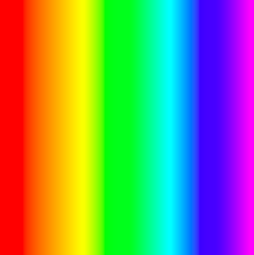

In [31]:
rainbow = Image.open("rainbow.png")
rainbow = rainbow.convert("RGB")  # important pour bien avoir 3 couleurs
px = rainbow.load()         

W, H = rainbow.size          # taille de l'image
r, g, b = px[10, 20]    # on récupère un pixel
px[10, 21] = r, g, b    # on change un pixel

#im = im.resize((W//2, H//2))

# redimensionnement de l'image
display(rainbow.resize((W//2, H//2)))             # on affiche l'image dans la cellule

In [32]:
# liste des couleurs présentes dans l'image
dico_couleurs = couleurs_presentes(rainbow)

print("Nombre de couleurs différentes présentes dans le dégradé de couleurs :", len(dico_couleurs))

Nombre de couleurs différentes présentes dans le dégradé de couleurs : 409


On observe qu'il y a plusieurs centaines de couleurs présentes dans cette image de petite dimension. Seulement, certaines sont tellement proches que l'oeil humain ne sera pas capable de les distinguer. L'objectif ici est de déterminer une palette de k couleurs principalement présentes dans l'image.

## Choix d'une palette de k couleurs : la méthode naïve

Tout d'abord naïvement, on peut se dire que visuellement, notre image de départ semble contenir environ 7-8 couleurs dominantes ; en partant de la gauche vers la droite : rouge, orange, jaune, vert, turquoise, bleu et violet. La première idée est de trier notre dictionnaire des couleurs présentes en fonction de la fréquence d'apparition décroissante de chaque couleur et de retenir les 7-8 couleurs majoritaires.

### Tri des couleurs par fréquence décroissante d'apparition et sélection des k couleurs de la palette

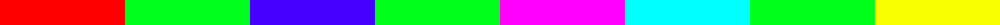

In [33]:
def methode_naive(img, choix_distance=distance_euclid, k=8):
    """Applique une méthode naïve de réduction de couleurs à une image. Cette méthode sélectionne les k couleurs les plus fréquentes dans l'image comme palette, puis recolorie l'image en assignant à chaque pixel la couleur la plus proche dans la palette sélectionnée.

    Paramètres:
        img (PIL.Image.Image): L'image à traiter.
        choix_distance (function) : La fonction de distance à utiliser pour comparer les couleurs. Par défaut, `distance_euclid`.
        k (int): Le nombre de couleurs à inclure dans la palette résultante. Par défaut, 8.

    Retour:
        tuple: Un tuple contenant deux éléments :
            - PIL.Image.Image: L'image recoloriée avec la palette réduite.
            - list: La palette de couleurs sélectionnée (une liste de tuples RGB).
    """
    dico_couleurs = couleurs_presentes(img)
    couleurs_triees = sorted(dico_couleurs.items(), key=lambda item: item[1], reverse=True)
    palette_naive = couleurs_triees[0:k]
    image_recoloriee = recoloriage(img,palette_naive,choix_distance)

    return image_recoloriee, palette_naive
    
# on tri le dictionnaire en fonction des couleurs les plus redondantes dans l'image
couleurs_triees = sorted(dico_couleurs.items(), key=lambda item: item[1], reverse=True)
#print(couleurs_triees)

# on choisit naïvement les 8 couleurs les plus présentes dans l'image
palette_naive = couleurs_triees[0:8]
afficher_palette(palette_naive)

Remarquons que si une couleur est très présente dans une image (le vert ici), la palette ne présentera pas une grande variété de couleurs.

### Application du recoloriage à l'image contenant le dégradé

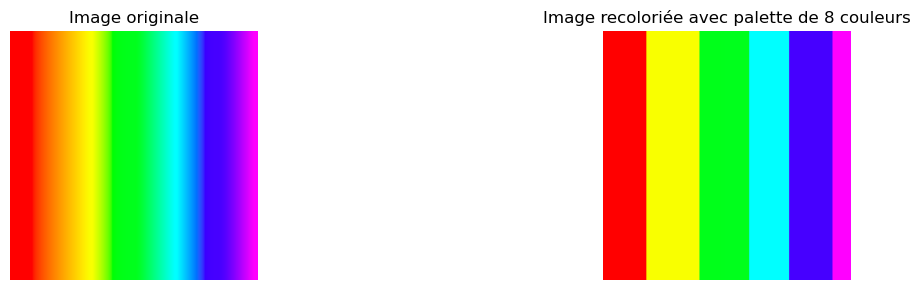

In [34]:
# On affiche notre image recoloriée, en réduisant ses dimensions par deux
rainbow_recoloriee, palette_utilisee = methode_naive(rainbow,distance_euclid,8)

# Affichage
fig, axs = plt.subplots(1, 2, figsize=(15, 3))
axs[0].imshow(rainbow)
axs[0].set_title("Image originale")
axs[0].axis('off')

axs[1].imshow(rainbow_recoloriee)
axs[1].set_title("Image recoloriée avec palette de 8 couleurs")
axs[1].axis('off')

plt.tight_layout()
plt.show()

Nous retrouvons 6 des 7-8 couleurs principales de l'image. En augmentant le nombre de couleurs présentes dans notre palette, on remarque ci-dessous que la couleur verte est toujours très présente dans notre palette et qu'elle masque d'autres couleurs qui seraient davantage pertinentes à prendre en compte.

## Méthode de validation de notre approche

Afin de valider (ou non) notre méthode naïve, nous calculerons dans cette partie l'erreur globale entre l'image originale et l'image recoloriée avant de visualiser la différence en affichant une image des erreurs.

### Calcul du score global d'erreur

In [35]:
score(rainbow,rainbow_recoloriee, distance_euclid)

{'erreur_totale': 11541133.57,
 'erreur_moyenne': 44.37,
 'pourcentage_erreur': 10.05}

## Application de notre fonction différence au dégradé de couleurs

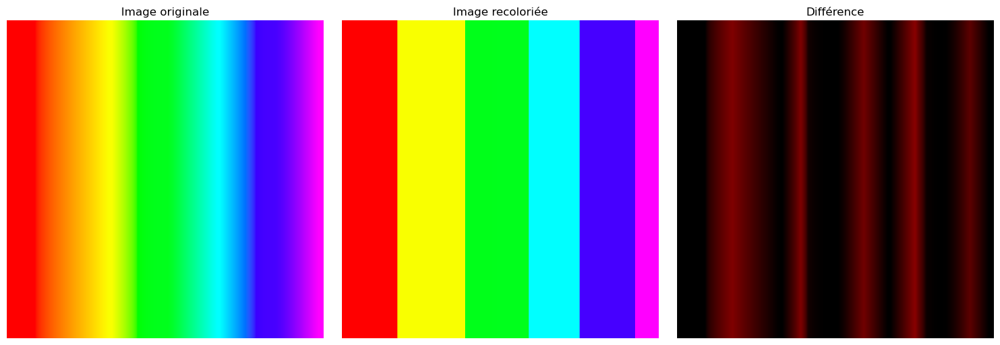

In [36]:
# On affiche notre image des erreurs : plus c'est rouge et plus notre recoloriage est mauvais dans cet endroit
diff = difference(rainbow,rainbow_recoloriee,distance_euclid)

# Affichage
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(rainbow)
axs[0].set_title("Image originale")
axs[0].axis('off')

axs[1].imshow(rainbow_recoloriee)
axs[1].set_title("Image recoloriée")
axs[1].axis('off')

axs[2].imshow(diff)
axs[2].set_title("Différence")
axs[2].axis('off')

plt.tight_layout()
plt.show()

Remarquons que les erreurs sont concentrées au niveau des transitions entre les couleurs, c'est-à-dire là où le dégradé de couleur est le plus fort dans l'image originale.

L'objectif de la suite de ce travail est de minimiser cette erreur afin de reconstituer une image la plus fidèle possible pour l'utilisateur. Une première idée peut être d'augmenter le nombre de couleurs disponibles dans la palette pour le recoloriage.

## Quid d'augmenter le nombre de k couleurs arbitrairement ?

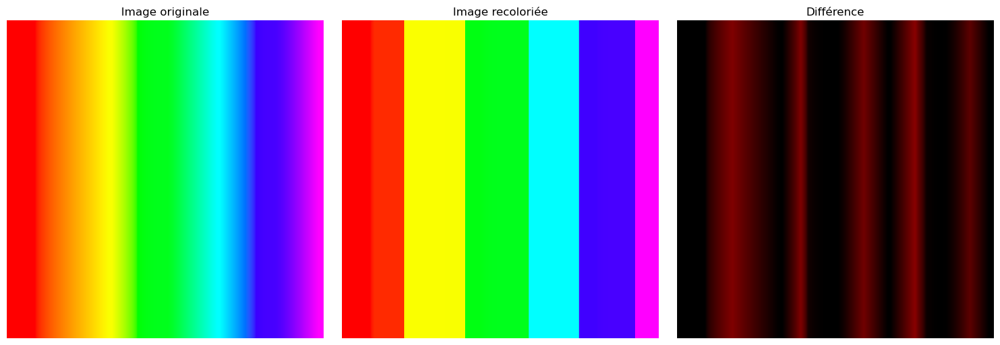

In [37]:
# Définition de la nouvelle palette contenant plus de couleurs
k = 30 # on fixe à 30 couleurs arbitrairement
palette_naive_2 = couleurs_triees[0:k]

# On recolorie notre image
rainbow_reco_2 = recoloriage(rainbow,palette_naive_2, distance_euclid)

diff_rainbow = difference(rainbow,rainbow_recoloriee,distance_euclid)

# Affichage
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(rainbow)
axs[0].set_title("Image originale")
axs[0].axis('off')

axs[1].imshow(rainbow_reco_2)
axs[1].set_title("Image recoloriée")
axs[1].axis('off')

axs[2].imshow(diff_rainbow)
axs[2].set_title("Différence")
axs[2].axis('off')

plt.tight_layout()
plt.show()

On remarque qu'en augmentant le nombre k de couleurs disponibles dans notre palette (k=30 dans cet essai), cette image reconstituée ressemble beaucoup à la précédente : les améliorations ne sont pas exceptionnelles.

Les résultats sont très peu satisfaisants : augmenter arbitrairement le nombre de couleurs disponibles sur la palette n'est pas efficace. Il s'agira donc dans la partie suivante d'optimiser le choix de ces k couleurs en nous basant sur 3 algorithmes différents. Un autre méthode permettra de choisir le nombre k de couleurs optimales utilisées pour le re-coloriage en s'adaptant à la complexité de l'image à traiter.

<B> Amélioration du choix des k couleurs </>

Cette partie a pour objectif d'améliorer nos méthodes de choix des k couleurs afin de minimiser l'erreur entre l'image originale et l'image re-coloriée.
Nous proposerons dans un premier temps 3 nouvelles méthodes afin d'optimiser ce choix : algorithme des k-moyennes (ou K-Means), algorithme du Median Cut et algorithme d'Octree, avant de nous intéresser à un algorithme des K-Means non supervisé afin de choisir le nombre k de manière optimale. Enfin, une synthèse comparée de ces 4 méthodes conclura cette partie.

NB : les tests unitaires de Median Cut, K-Means et Octree ont été générés par IA.

# Median Cut Algorithm

L'objectif de cet algorithme est de réduire le nombre de couleurs en choisissant les "meilleures" couleurs représentatives pour créer une palette optimisée. L'idée est de regrouper les couleurs proches entre elles. Chaque groupe sera représenté par une seule couleur moyenne. POur forcer ces groupes on divise récursivement les couleurs présentes dans l'image.

In [38]:
def _median_cut_recursive(pixels, profondeur):
    """Implémentation récursive de l'algorithme "median cut".

    Cette fonction divise récursivement une liste de pixels en deux groupes en fonction de la médiane de la composante de couleur ayant la plus grande plage.
    Le processus continue jusqu'à atteindre la profondeur spécifiée ou qu'il n'y ait plus de pixels.

    Paramètres:
        pixels (list): Une liste de tuples représentant les couleurs des pixels (R, G, B).
        profondeur (int): Le nombre de niveaux de division restants.

    Retour:
        list: Une liste contenant une seule couleur (la moyenne des pixels) lorsque la profondeur est atteinte ou la liste de pixels est vide. Sinon, retourne la concaténation des palettes résultant des deux divisions.
    """
    if profondeur == 0 or len(pixels) == 0:
        r = sum(p[0] for p in pixels) // len(pixels)
        g = sum(p[1] for p in pixels) // len(pixels)
        b = sum(p[2] for p in pixels) // len(pixels)
        return [(r, g, b)]

    # On choisit la composante qui varie le plus
    ranges = [(max(p[i] for p in pixels) - min(p[i] for p in pixels), i) for i in range(3)]
    _, channel = max(ranges)
    pixels.sort(key=lambda x: x[channel])
    median = len(pixels) // 2

    return _median_cut_recursive(pixels[:median], profondeur - 1) + _median_cut_recursive(pixels[median:], profondeur - 1)

def median_cut(image, profondeur):
    """Applique l'algorithme de "median cut" pour générer une palette de couleurs à partir d'une image.
    L'algorithme divise récursivement l'espace colorimétrique de l'image pour créer une palette de taille 2^profondeur.

    Paramètres:
        image (PIL.Image.Image): L'image à partir de laquelle générer la palette.
        profondeur (int): Le nombre de niveaux de division à effectuer.
                         La taille de la palette résultante sera 2^profondeur.

    Retour:
        list: Une liste de tuples représentant la palette de couleurs (R, G, B).
    """
    px = image.load()
    W, H = image.size
    pixels = [px[x, y] for y in range(H) for x in range(W)]
    return _median_cut_recursive(pixels, profondeur)

On définit une nouvelle fonction qui permettra de recolorier l'image à partir de la palette déterminée par l'algorithme de Median Cut.

In [39]:
# On recolorie l'image avec la nouvelle palette de couleurs
def recoloriage_MedianCut(im, profondeur, choix_distance=distance_euclid):
    """Réduit le nombre de couleurs d'une image en utilisant l'algorithme "median cut" pour générer la palette.
    L'image est ensuite recoloriée en assignant à chaque pixel la couleur la plus proche dans la palette générée.

    Paramètres:
        im (PIL.Image.Image): L'image à recolorier.
        profondeur (int): Le nombre de niveaux de division pour l'algorithme "median cut".
                          Détermine la taille de la palette de couleurs résultante (2^profondeur).
        choix_distance (callable, optional): La fonction de distance à utiliser pour
                                            comparer les couleurs. Par défaut, `distance_euclid`.

    Retour:
        PIL.Image.Image: Une nouvelle image avec un nombre de couleurs réduit.
    """
    px = im.load()
    W, H = im.size

    palette = median_cut(im, profondeur)  # on passe directement l'image

    new_img = Image.new("RGB", im.size)
    for y in range(H):
        for x in range(W):
            originale = px[x, y]
            plus_proche = min(palette, key=lambda c: choix_distance(originale, c))
            new_img.putpixel((x, y), plus_proche)

    return new_img

### Test de la fonction Median Cut et recoloriage

On commence par définir plusieurs fonctions de test : 

In [40]:
def test_median_cut_profondeur_0(im_test):
    palette = median_cut(im_test, 0)
    assert isinstance(palette, list)  # La sortie doit être une liste
    assert len(palette) == 1          # Il ne doit y avoir qu'une seule couleur (profondeur = 0)
    assert all(isinstance(c, tuple) and len(c) == 3 for c in palette)  # Chaque couleur doit être un tuple (R, G, B)


def test_median_cut_profondeur_2(im_test):
    palette = median_cut(im_test, 2)
    assert len(palette) == 4  # Pour une profondeur 2, on attend 2^2 = 4 couleurs
    assert all(isinstance(c, tuple) and len(c) == 3 for c in palette)  # Chaque élément de la palette doit être un tuple RGB


def test_palette_approximation(im_test):
    palette = median_cut(im_test, 2)
    colors_in_img = set(im_test.getdata())  # On extrait les couleurs réelles de l'image
    for color in colors_in_img:
        assert any(distance_euclid(color, c) < 50 for c in palette)  # Chaque couleur réelle doit avoir une couleur proche dans la palette


def test_recoloriage_taille_identique(im_test):
    recolored = recoloriage_MedianCut(im_test, 2)
    assert recolored.size == im_test.size  # L'image recoloriée doit avoir la même taille que l'originale

def test_recoloriage_couleurs_dans_palette(im_test):
    palette = median_cut(im_test, 2)
    recolored = recoloriage_MedianCut(im_test, 2)
    recolored_pixels = list(recolored.getdata())
    assert all(p in palette for p in recolored_pixels)  # Tous les pixels de l'image recoloriée doivent appartenir à la palette

In [41]:
test_median_cut_profondeur_0(im_test)
test_median_cut_profondeur_2(im_test)
test_palette_approximation(im_test)
test_recoloriage_taille_identique(im_test)
test_recoloriage_couleurs_dans_palette(im_test)
print("Tous les tests de Median Cut sont validés !")

Tous les tests de Median Cut sont validés !


# Octree Algorithm

Cette partie présente l'algorithme Octree, efficace également pour quantifier les couleurs d'une image : on obtiendra une palette optimisée de k couleurs.
Le principe de l'algorithme est le suivant :
<ol>
    <li>chaque pixel est inséré dans un arbre de type Octree basé sur ses composantes R, G et B ;
</li>
    <li>l'arbre divise l'espace colorimétrique en cubes de plus en plus petits ("Oct" = jusqu'à 8 enfants par noeud) ;
</li>
    <li>une fois les pixels insérés, on réduit l'arbre à k couleurs en fusionnant les noeuds les moins significatifs ;
</li>
    <li>chaque pixel de l'image est ensuite recoloriée en fonction de la couleur représentée par son noeud dans l'arbre.
</li>
</ol>

On s'appuiera sur les cours/TD portant sur les arbres pour coder notre fonction.

In [42]:
# Crée un noeud vide à un niveau donné dans l'Octree
def creation_noeud(niveau):
    """Crée un noeud vide pour l'Octree à un niveau spécifié.

    Paramètres:
        niveau (int): Le niveau du noeud dans l'Octree (0 pour la racine, 8 pour les feuilles).

    Retour:
        dict: Un dictionnaire représentant le noeud avec les clés suivantes :
            'somme_couleur' : Somme des composantes de couleur (R, G, B).
            'nb_pixels' (int): Nombre de pixels agrégés dans ce noeud.
            'enfants' (list): Liste de 8 sous-noeuds (initialisés à None).
            'niveau' (int): Niveau du noeud dans l'arbre.
            'est_feuille' (bool): Indique si le noeud est une feuille.
            'parent' (dict): Référence au noeud parent.
    """
    return {
        'somme_couleur': np.zeros(3, dtype=np.float64),  # Somme des couleurs (R, G, B)
        'nb_pixels': 0,                                   # Nombre de pixels agrégés
        'enfants': [None] * 8,                            # 8 sous-noeuds pour un Octree
        'niveau': niveau,                                 # Profondeur actuelle dans l’arbre
        'est_feuille': True,                              # Booléen : le noeud est-il terminal ?
        'parent': None                                    # Référence au parent (utile pour fusionner)
    }

# Détermine quel enfant utiliser dans l’Octree en fonction de la couleur et du niveau
def index_octree(couleur, niveau):
    """Détermine l'index de l'enfant dans l'Octree pour une couleur donnée et un niveau.

    Paramètres:
        couleur (tuple): Un tuple de trois entiers représentant une couleur (R, G, B).
        niveau (int): Le niveau actuel dans l'Octree.

    Retour:
        int: L'index de l'enfant (0-7) correspondant à la couleur et au niveau.
    """
    decalage = 7 - niveau                           # On déplace les bits vers la droite selon la profondeur
    r = (couleur[0] >> decalage) & 1               # Bit significatif pour le rouge
    g = (couleur[1] >> decalage) & 1               # Bit significatif pour le vert
    b = (couleur[2] >> decalage) & 1               # Bit significatif pour le bleu
    return (r << 2) | (g << 1) | b                 # On combine les 3 bits pour obtenir un index entre 0 et 7

# Ajoute une couleur dans l’arbre Octree
def ajout_couleur(noeud, couleur, niveau, reduceur):
    """Ajoute une couleur à l'Octree.

    Paramètres:
        noeud (dict): Le noeud actuel de l'Octree.
        couleur (numpy.ndarray): Un tableau NumPy représentant la couleur (R, G, B).
        niveau (int): Le niveau actuel dans l'Octree.
        reduceur (list): Une liste de listes contenant les noeuds à chaque niveau pour la réduction.

    Retour:
        None: La fonction modifie l'Octree en place.
    """
    if niveau == 8:  # Cas de base : on est à la feuille
        noeud['somme_couleur'] += couleur         # On ajoute les composantes R, G, B
        noeud['nb_pixels'] += 1                   # On compte le pixel
        return

    index = index_octree(couleur.astype(int), niveau)  # Calcul de l'index du sous-noeud

    if noeud['enfants'][index] is None:  # Si le sous-noeud n’existe pas encore
        enfant = creation_noeud(niveau + 1)      # On crée un nouveau noeud enfant
        enfant['parent'] = noeud                 # On enregistre son parent
        noeud['enfants'][index] = enfant         # On l’insère dans la liste des enfants
        reduceur[niveau + 1].append(enfant)      # On garde une référence pour la réduction
        noeud['est_feuille'] = False             # Ce noeud n’est plus une feuille

    ajout_couleur(noeud['enfants'][index], couleur, niveau + 1, reduceur)  # Appel récursif

# Récupère toutes les feuilles de l’arbre (noeuds sans enfants)
def collecte_feuilles(noeud):
    """Récupère toutes les feuilles (noeuds sans enfants) de l'Octree.

    Paramètres:
        noeud (dict): Le noeud actuel de l'Octree.

    Retour:
        list: Une liste de dictionnaires, où chaque dictionnaire représente une feuille de l'arbre.
    """
    if noeud['est_feuille']:  # Si le noeud est une feuille
        return [noeud]        # On le retourne sous forme de liste
    feuilles = []
    for enfant in noeud['enfants']:  # On visite tous les enfants
        if enfant:
            feuilles.extend(collecte_feuilles(enfant))  # Récursion
    return feuilles

# Fusionne tous les enfants d’un noeud vers ce noeud
def fusion_enfants(noeud):
    """Fusionne les couleurs et compte les pixels de tous les enfants d'un noeud vers ce noeud.

    Paramètres:
        noeud (dict): Le noeud dont les enfants doivent être fusionnés.

    Retour:
        None: La fonction modifie le noeud en place.
    """
    for enfant in noeud['enfants']:
        if enfant:
            noeud['somme_couleur'] += enfant['somme_couleur']  # On agrège les couleurs
            noeud['nb_pixels'] += enfant['nb_pixels']          # On compte tous les pixels
    noeud['enfants'] = [None] * 8                              # On supprime les références aux enfants
    noeud['est_feuille'] = True                                # Ce noeud devient une feuille

# Construit l’Octree à partir d’une liste de pixels
def construction_arbre(pixels):
    """Construit un Octree à partir d'une liste de pixels.

    Paramètres:
        pixels (list): Une liste de tuples représentant les couleurs des pixels (R, G, B).

    Retour:
        tuple: Un tuple contenant :
            - dict: La racine de l'Octree.
            - list: Une liste de listes contenant les noeuds à chaque niveau pour la réduction.
    """
    racine = creation_noeud(0)               # Création de la racine de l’arbre
    reduceur = [[] for _ in range(9)]        # Une liste de noeuds pour chaque niveau (0 à 8)
    for couleur in pixels:
        ajout_couleur(racine, np.array(couleur), 0, reduceur)  # Ajout de chaque pixel dans l’arbre
    return racine, reduceur

# Réduit l’Octree jusqu’à ce qu’il ne reste que k feuilles
def reduction_arbre(racine, reduceur, k):
    """Réduit l'Octree jusqu'à ce qu'il ne reste que k feuilles (couleurs).

    Paramètres:
        racine (dict): La racine de l'Octree.
        reduceur (list): Une liste de listes contenant les noeuds à chaque niveau pour la réduction.
        k (int): Le nombre désiré de couleurs dans la palette finale.

    Retour:
        list: Une liste de dictionnaires représentant les feuilles restantes de l'arbre.
    """
    feuilles = collecte_feuilles(racine)  # Liste initiale des feuilles
    while len(feuilles) > k:              # Tant qu’on a plus de k couleurs
        for niveau in reversed(range(1, 9)):        # On part du bas de l’arbre
            if reduceur[niveau]:                    # Si on a des noeuds à ce niveau
                noeud = reduceur[niveau].pop()      # On en prend un
                if noeud['parent']:                 # Si ce noeud a un parent
                    fusion_enfants(noeud['parent']) # On fusionne ses enfants dans le parent
                    break
        feuilles = collecte_feuilles(racine)        # Mise à jour des feuilles
    return feuilles

# Calcule la palette finale (moyenne de chaque feuille)
def obtenir_palette(feuilles):
    """Calcule la palette de couleurs finale à partir des feuilles de l'Octree.

    Paramètres:
        feuilles (list): Une liste de dictionnaires représentant les feuilles de l'arbre.

    Retour:
        list: Une liste de tuples représentant la palette de couleurs (R, G, B).
    """
    palette = []
    for noeud in feuilles:
        if noeud['nb_pixels'] > 0:
            moyenne = (noeud['somme_couleur'] / noeud['nb_pixels']).astype(int)  # Moyenne R, G, B
            palette.append(tuple(moyenne))  # On transforme le vecteur en tuple
    return palette

# Cherche la couleur la plus proche dans une palette
def couleur_plus_proche(couleur, palette, choix_distance=distance_euclid):
    """Trouve la couleur la plus proche dans une palette donnée, en utilisant une fonction de distance spécifiée.

    Paramètres:
        couleur (tuple): La couleur pour laquelle on cherche la correspondance la plus proche (R, G, B).
        palette (list): Une liste de tuples représentant la palette de couleurs (R, G, B).
        choix_distance (callable, optional): La fonction utilisée pour calculer la distance entre deux couleurs. Par défaut, utilise la distance euclidienne (`distance_euclid`).

    Retour:
        tuple: La couleur de la palette la plus proche de la couleur donnée.
    """
    couleur = np.array(couleur)
    meilleure = None
    distance_min = float('inf')
    for c in palette:
        dist = choix_distance(couleur, np.array(c))  # Distance euclidienne
        if dist < distance_min:
            distance_min = dist
            meilleure = c
    return meilleure

# Applique l’algorithme Octree à une image avec k couleurs
def image_octree(image, k, choix_distance=distance_euclid):
    """Applique l'algorithme Octree pour réduire le nombre de couleurs dans une image à k.

    Paramètres:
        image (PIL.Image.Image): L'image à traiter.
        k (int): Le nombre de couleurs désiré dans l'image réduite.
        choix_distance (function): La fonction de distance à utiliser pour comparer les couleurs. Par défaut, utilise la distance euclidienne (`distance_euclid`).

    Retour:
        tuple: Un tuple contenant :
            - PIL.Image.Image: Une nouvelle image avec le nombre de couleurs réduit.
            - list: La palette de couleurs résultante.
    """
    pixels = list(image.getdata())                     # Liste des pixels de l’image
    racine, reduceur = construction_arbre(pixels)      # Création de l’arbre
    feuilles = reduction_arbre(racine, reduceur, k)    # Réduction jusqu’à k couleurs
    palette = obtenir_palette(feuilles)                # Palette finale
    nouveaux_pixels = [couleur_plus_proche(p, palette, choix_distance) for p in pixels]  # Recolorisation
    nouvelle_image = Image.new("RGB", image.size)      # Nouvelle image
    nouvelle_image.putdata(nouveaux_pixels)            # Insertion des pixels recolorés
    return nouvelle_image, palette

# Affiche la palette sous forme d’une bande d’aperçu
def affiche_palette(palette, taille=20):
    """Affiche une palette de couleurs sous forme de bande horizontale.

    Paramètres:
        palette (list): Une liste de tuples représentant la palette de couleurs (R, G, B).
        taille (int, optional): La hauteur (et la largeur de chaque couleur) de la bande de palette. Par défaut, 20.

    Retour:
        PIL.Image.Image: Une image représentant la palette de couleurs.
    """
    img = Image.new("RGB", (taille * len(palette), taille))  # Image rectangulaire
    for i, couleur in enumerate(palette):                    # Pour chaque couleur
        for x in range(taille):                              # Remplissage du rectangle
            for y in range(taille):
                img.putpixel((i * taille + x, y), couleur)
    return img


### Test de la méthode Octree

In [43]:
# Vérifie que l'image recolorisée a bien la même taille que l'image d'origine
def test_taille_identique(image_test):
    image_reduite, _ = image_octree(image_test, 8)   # On applique l’algorithme avec 8 couleurs
    assert image_reduite.size == image_test.size     # La taille doit rester la même

# Vérifie que la palette contient exactement k couleurs
def test_palette_exacte(image_test, k):
    _, palette = image_octree(image_test, k)         # On applique Octree avec k couleurs
    assert len(palette) <= k                         # La palette ne doit pas dépasser k couleurs

# Vérifie que les couleurs utilisées dans l'image recolorisée sont bien dans la palette
def test_couleurs_dans_palette(image_test, k):
    image_reduite, palette = image_octree(image_test, k)     # Nouvelle image et palette
    pixels = list(image_reduite.getdata())                   # Liste des pixels recolorisés
    for pixel in pixels:
        assert pixel in palette                              # Chaque pixel doit appartenir à la palette

# Vérifie qu'on peut recolorier avec 1 seule couleur (image monochrome)
def test_monochrome(image_test):
    image_reduite, palette = image_octree(image_test, 1)     # Image avec 1 seule couleur
    pixels = list(image_reduite.getdata())
    couleur = pixels[0]                                      # On prend le premier pixel
    for pixel in pixels:
        assert pixel == couleur                              # Tous les pixels doivent être identiques

# Fonction pour lancer tous les tests d’un coup
def tests_octree(image_test):
    test_taille_identique(image_test)              # Test de taille
    test_palette_exacte(image_test, 8)             # Test de longueur de palette
    test_couleurs_dans_palette(image_test, 8)      # Test de cohérence entre image et palette
    test_monochrome(image_test)                    # Test monochrome
    print("Tous les tests Octree sont validés !")


# Charger une image pour faire les tests
tests_octree(im_test)

Tous les tests Octree sont validés !


# K-Means Algorithm

L'algorithme des K-moyennes (ou K-Means) est très bien adapté au problème de réduction de couleurs dans une image. L'objectif de cet algorithme est le suivant : il regroupe les pixels (représentés par leur valeur RGB) en k clusters, de manière à ce que chaque cluster contienne des couleurs similaires et que la moyenne des pixels de ce groupe devienne une couleur de la palette. Une fois les k couleurs trouvées, on recolorie l’image en remplaçant chaque pixel par la couleur de la moyenne du groupe auquel il appartient.

Dans la suite, on appellera "centroïde" la moyenne des pixels d'un même groupe.

In [44]:
# cette fonction permet de choisir aléatoirement k couleurs initiales parmi celles présentes dans l'image
def initialisation_centroide(liste_pixels, k):
    """Initialise les centroïdes en sélectionnant aléatoirement k couleurs uniques à partir d'une liste de pixels.

    Paramètres:
        liste_pixels (list): Une liste de tuples, chaque tuple représentant une couleur de pixel (R, G, B).
        k (int): Le nombre de centroïdes à initialiser.

    Retour:
        list: Une liste de tuples, chacun représentant un centroïde initial (R, G, B).
    """
    return [random.choice(liste_pixels) for _ in range(k)]

# cette fonction permet d'affecter à chaque pixel la couleur la plus proche
def assigner_cluster(liste_pixels, centroids, choix_distance=distance_euclid):
    """Assigne chaque pixel à un cluster en fonction de la distance à chaque centroïde.

    Paramètres:
        liste_pixels (list): Une liste de tuples, chaque tuple représentant une couleur de pixel (R, G, B).
        centroids (list): Une liste de tuples, chaque tuple représentant un centroïde (R, G, B).
        choix_distance (callable, optional): La fonction de distance à utiliser. Par défaut, utilise la distance euclidienne (`distance_euclid`).

    Retour:
        list: Une liste de listes. Chaque sous-liste contient les pixels assignés à un centroïde spécifique.
    """
    clusters = [[] for _ in centroids]
    for pixel in liste_pixels:
        distances = [choix_distance(pixel, centroid) for centroid in centroids]
        indice_proche = distances.index(min(distances))
        clusters[indice_proche].append(pixel)
    return clusters

# cette fonction permet de recalculer les centroïdes 
def recalcule_centroids(clusters):
    """Recalcule les centroïdes en calculant la couleur moyenne de chaque cluster.
    Si un cluster est vide, un nouveau centroïde aléatoire est généré pour éviter les erreurs.

    Paramètres:
        clusters (list): Une liste de listes. Chaque sous-liste contient les pixels d'un cluster.

    Retour:
        list: Une liste de tuples, chacun représentant un centroïde recalculé (R, G, B).
    """
    centroids = []
    for cluster in clusters:
        if cluster:
            r = sum(pixel[0] for pixel in cluster) // len(cluster)
            g = sum(pixel[1] for pixel in cluster) // len(cluster)
            b = sum(pixel[2] for pixel in cluster) // len(cluster)
            centroids.append((r, g, b))
        else:
            # Cluster vide = nouveau centroïde aléatoire
            centroids.append((random.randint(0, 255), random.randint(0, 255), random.randint(0, 255)))
    return centroids

def kmeans(image, k, max_iter=10, choix_distance=distance_euclid):
    """Applique l'algorithme k-means pour réduire le nombre de couleurs dans une image.

    Paramètres:
        image (PIL.Image.Image): L'image à traiter.
        k (int): Le nombre de clusters (et donc de couleurs) à utiliser.
        max_iter (int, optional): Le nombre maximum d'itérations de l'algorithme. Par défaut, 10.
        choix_distance (callable, optional): La fonction de distance à utiliser.
            Par défaut, utilise la distance euclidienne (`distance_euclid`).

    Retour:
        PIL.Image.Image: Une nouvelle image avec un nombre de couleurs réduit.
    """
    W, H = image.size
    pixels = image.load()

    # Liste de tous les pixels de l'image
    liste_pixels = [pixels[x, y] for y in range(H) for x in range(W)]

    # Initialisation des centroïdes : on commence par choisir aléatoirement k couleurs aléatoires
    centroids = initialisation_centroide(liste_pixels, k)

    for _ in range(max_iter): # on répète la boucle jusqu'à un nombre maximum d'itérations max_iter
        clusters = assigner_cluster(liste_pixels, centroids, distance_euclid) # on affecte à chaque pixel la couleur la plus proche
        new_centroids = recalcule_centroids(clusters) # on recalcule les centroïdes
        if new_centroids == centroids:
            break
        centroids = new_centroids

    # Création de la nouvelle image
    new_image = Image.new("RGB", (W, H))
    new_pixels = new_image.load()

    for y in range(H):
        for x in range(W):
            original = pixels[x, y]
            distances = [choix_distance(original, centroid) for centroid in centroids]
            indice_proche = distances.index(min(distances))
            new_pixels[x, y] = centroids[indice_proche]

    return new_image

### Test de la méthode K-Means

In [45]:
import random
import numpy as np
from PIL import Image

# Test de l'initialisation des centroïdes
def test_initialisation_centroide():
    # On crée une liste de pixels d'exemple
    liste_pixels = [(255, 0, 0), (0, 255, 0), (0, 0, 255)]
    k = 2
    centroids = initialisation_centroide(liste_pixels, k)
    
    # On vérifie que le nombre de centroïdes générés est égal à k
    assert len(centroids) == k, f"Erreur : nombre de centroïdes ({len(centroids)}) différent de {k}"

    # On vérifie que les centroïdes sont bien choisis parmi les pixels
    assert all(centroid in liste_pixels for centroid in centroids), "Erreur : un des centroïdes n'est pas dans les pixels initiaux"

# Test de l'affectation des pixels aux clusters
def test_assigner_cluster():
    # Exemple de pixels et de centroïdes
    liste_pixels = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]
    centroids = [(255, 0, 0), (0, 0, 255)]
    
    clusters = assigner_cluster(liste_pixels, centroids)
    
    # On vérifie qu'il y a autant de clusters que de centroïdes
    assert len(clusters) == len(centroids), f"Erreur : nombre de clusters ({len(clusters)}) différent du nombre de centroïdes ({len(centroids)})"
    
    # On vérifie que chaque pixel est affecté à un seul cluster
    for cluster in clusters:
        for pixel in cluster:
            assert pixel in liste_pixels, f"Erreur : le pixel {pixel} n'est pas dans la liste des pixels initiaux"

# Test du recalcul des centroïdes
def test_recalcule_centroids():
    # Exemple de clusters
    clusters = [
        [(255, 0, 0), (255, 0, 0)],
        [(0, 255, 0), (0, 255, 0)],
        [(0, 0, 255), (0, 0, 255)]
    ]
    
    centroids = recalcule_centroids(clusters)
    
    # On vérifie que le nombre de centroïdes correspond au nombre de clusters
    assert len(centroids) == len(clusters), f"Erreur : nombre de centroïdes ({len(centroids)}) différent du nombre de clusters ({len(clusters)})"
    
    # On vérifie que les centroïdes sont des moyennes des pixels du cluster
    for i, cluster in enumerate(clusters):
        expected_centroid = tuple(
            sum(pixel[j] for pixel in cluster) // len(cluster) for j in range(3)
        )
        assert centroids[i] == expected_centroid, f"Erreur : centroid {i} attendu {expected_centroid}, trouvé {centroids[i]}"

# Test de l'algorithme K-means
def test_kmeans():
    # Création d'une image test simple de 4 pixels avec 2 couleurs
    img_data = [(255, 0, 0), (255, 0, 0), (0, 255, 0), (0, 255, 0)]  # 2 couleurs : rouge et vert
    test_image = Image.new("RGB", (2, 2))
    test_image.putdata(img_data)
    
    # Application de l'algorithme K-means avec 2 couleurs
    k = 2
    new_image = kmeans(test_image, k)
    
    # Vérification que l'image recolorisée a bien 2 couleurs
    new_pixels = list(new_image.getdata())
    assert len(set(new_pixels)) == 2, "Erreur : L'image recolorisée ne contient pas 2 couleurs distinctes"

# Fonction d'exécution des tests pour K-means
def tests_kmeans(image_test, choix_distance):
    test_initialisation_centroide()  # Test de l'initialisation des centroïdes
    test_assigner_cluster()          # Test de l'affectation des clusters
    test_recalcule_centroids()       # Test du recalcul des centroïdes
    test_kmeans()                    # Test de l'algorithme K-means
    print("Tous les tests K-means sont validés !")

# Appel des tests
tests_kmeans(im_test, distance_euclid)

Tous les tests K-means sont validés !


# Traitement avec Fourier

En complément des méthodes précédentes, et eu égard à l'étude des signaux, on peut appliquer une Transformée de Fourier sur les couleurs des pixels de l'image.

Plusieurs approches sont possibles :

- considérer l'image avec un seul canal d'information : on utilise donc la conversion de l'image en niveaux de gris ;
- considérer l'image avec deux canaux d'information : on utilise pour cela la conversion en YCbCr ;
- considérer l'image avec trois canaux d'information : on conserve ainsi le RGB.

A la suite de la mise en place de ces trois méthodes, nous conclurons sur la pertinence d'utiliser l'une ou l'autre de ces méthodes.

On commence par afficher et choisir l'image de test.

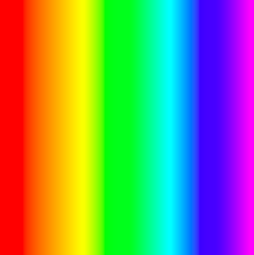

In [46]:
from PIL import Image, ImageDraw
import cmath
import math

# choix de l'image test et affichage de celle-ci
img = Image.open("rainbow.png").convert("RGB")
W, H = img.size
display(img.resize((W // 2, H // 2)))

On implémente ensuite les différentes fonctions nécessaires au calcul de la transformée de Fourier pour chaque canal d'information.

On utilise la <b>Transformartion de Fourier Fapide</b> (<i>FFT</i> en anglais) (https://en.wikipedia.org/wiki/Cooley%E2%80%93Tukey_FFT_algorithm). On la généralise de plus en 2D  en prenant la transformée de Fourier en 1D dans la matrice.

In [47]:
# Retourne la plus petite puissance de 2 supérieure ou égale à n
def puissance_suivante_de_deux(n):
    """Retourne la plus petite puissance de 2 supérieure ou égale à n.

    Paramètres:
        n (int): Le nombre pour lequel on cherche la puissance de 2 supérieure.

    Retour:
        int: La plus petite puissance de 2 supérieure ou égale à n.
    """
    return 1 << (n - 1).bit_length()

# Complète une liste avec des zéros pour atteindre une taille cible
def zero_padding(liste, taille_cible):
    """Complète une liste avec des zéros pour atteindre une taille cible.

    Paramètres:
        liste (list): La liste à compléter.
        taille_cible (int): La taille désirée de la liste.

    Retour:
        list: Une nouvelle liste complétée avec des zéros.
    """
    return liste + [0] * (taille_cible - len(liste))

# Transformée de Fourier rapide (FFT) 1D récursive
def fft1d(signal):
    """Calcule la Transformée de Fourier Rapide (FFT) 1D d'un signal.
    Implémentation récursive de l'algorithme de Cooley-Tukey.

    Paramètres:
        signal (list): Une liste de nombres complexes représentant le signal.

    Retour:
        list: La transformée de Fourier du signal, une liste de nombres complexes.
    """
    n = len(signal)
    if n <= 1:
        return signal  # Cas de base : un seul élément
    pair = fft1d(signal[0::2])  # FFT des éléments pairs
    impair = fft1d(signal[1::2])  # FFT des éléments impairs
    T = [cmath.exp(-2j * math.pi * k / n) * impair[k] for k in range(n // 2)]  # Calcul des coefficients
    return [pair[k] + T[k] for k in range(n // 2)] + [pair[k] - T[k] for k in range(n // 2)]  # Résultat combiné

# Transformée de Fourier inverse (IFFT) 1D
def ifft1d(signal):
    """Calcule la Transformée de Fourier Inverse (IFFT) 1D d'un signal.
    Utilise la FFT pour calculer efficacement l'IFFT.

    Paramètres:
        signal (list): Une liste de nombres complexes représentant le signal dans le domaine fréquentiel.

    Retour:
        list: Le signal transformé dans le domaine temporel, une liste de nombres complexes.
    """
    n = len(signal)
    conjugue = [x.conjugate() for x in signal]  # Conjugué complexe du signal
    direct = fft1d(conjugue)  # FFT du conjugué
    return [x.conjugate() / n for x in direct]  # On redivise par n pour normaliser

# FFT 2D : applique la FFT 1D sur les lignes puis sur les colonnes d'une matrice
def fft2d(matrice):
    """Calcule la Transformée de Fourier Rapide (FFT) 2D d'une matrice.
    Applique la FFT 1D d'abord sur les lignes, puis sur les colonnes.  Gère le padding pour les dimensions qui ne sont pas des puissances de 2.

    Paramètres:
        matrice (list): Une liste de listes de nombres complexes représentant la matrice.

    Retour:
        tuple: Un tuple contenant :
            - list: La matrice transformée dans le domaine fréquentiel.
            - int: La hauteur originale de la matrice.
            - int: La largeur originale de la matrice.
    """
    h = len(matrice)  # Hauteur d'origine
    w = len(matrice[0])  # Largeur d'origine
    h_p = puissance_suivante_de_deux(h)  # Hauteur arrondie à la puissance de 2
    w_p = puissance_suivante_de_deux(w)  # Largeur arrondie à la puissance de 2

    # On complète chaque ligne avec des zéros
    matrice_padded = [zero_padding(ligne, w_p) for ligne in matrice]
    # On ajoute des lignes de zéros pour compléter en hauteur
    for _ in range(h_p - h):
        matrice_padded.append([0] * w_p)

    # FFT 1D sur chaque ligne
    lignes_fft = [fft1d(ligne) for ligne in matrice_padded]
    
    # FFT 1D sur chaque colonne
    colonnes_fft = []
    for col in range(w_p):
        colonne = [lignes_fft[row][col] for row in range(h_p)]
        fft_col = fft1d(colonne)
        for row in range(h_p):
            if col == 0:
                colonnes_fft.append([fft_col[row]])
            else:
                colonnes_fft[row].append(fft_col[row])
    
    # Retourne la matrice transformée + dimensions originales (utile pour l'IFFT)
    return colonnes_fft, h, w

# IFFT 2D : applique l'IFFT 1D sur les colonnes puis sur les lignes
def ifft2d(matrice, h_orig, w_orig):
    """Calcule la Transformée de Fourier Inverse (IFFT) 2D d'une matrice.
    Applique l'IFFT 1D d'abord sur les colonnes, puis sur les lignes.  Tronque le résultat aux dimensions originales avant le padding.

    Paramètres:
        matrice (list): Une liste de listes de nombres complexes représentant la matrice transformée.
        h_orig (int): La hauteur originale de la matrice.
        w_orig (int): La largeur originale de la matrice.

    Retour:
        list: La matrice transformée dans le domaine spatial, tronquée à ses dimensions originales.
    """
    h = len(matrice)
    w = len(matrice[0])

    # IFFT 1D sur chaque colonne
    temp = []
    for col in range(w):
        colonne = [matrice[row][col] for row in range(h)]
        ifft_col = ifft1d(colonne)
        for row in range(h):
            if col == 0:
                temp.append([ifft_col[row]])
            else:
                temp[row].append(ifft_col[row])

    # IFFT 1D sur chaque ligne
    lignes_ifft = [ifft1d(ligne) for ligne in temp]

    # On retourne uniquement la partie de la matrice correspondant aux dimensions d'origine
    return [ligne[:w_orig] for ligne in lignes_ifft[:h_orig]]


En considérant que l'image a été préalablement convertit en matrice, on travaille en norme (<i>amplitude_matrice</i>) et on applique la <i>FFT</i>.

Ensuite, on récupère les $k$ fréquences les plus importantes en amplitude pour former notre palette de couleurs.

Enfin, on recolorie l'image à partir de la palette en choisissant la couleur la plus proche pour une distance donnée.

In [48]:
# Calcule l'amplitude (valeur absolue) de chaque élément dans une matrice complexe
def amplitude_matrice(matrice):
    """Calcule l'amplitude (valeur absolue) de chaque élément d'une matrice.

    Paramètres:
        matrice (list): Une liste de listes de nombres complexes représentant la matrice.

    Retour:
        list: Une nouvelle matrice de flottants représentant les amplitudes des éléments de la matrice d'entrée.
    """
    return [[abs(valeur) for valeur in ligne] for ligne in matrice]

# Transforme une matrice 2D en une liste 1D (aplatissement)
def aplatir(matrice):
    """Transforme une matrice 2D en une liste 1D en concaténant les lignes.

    Paramètres:
        matrice (list): Une liste de listes représentant la matrice 2D.

    Retour:
        list: Une liste 1D contenant tous les éléments de la matrice.
    """
    return [val for ligne in matrice for val in ligne]

# Extrait les k indices des valeurs les plus importantes (en amplitude) dans une matrice
def extraire_k_indices_importants(matrice, k):
    """Extrait les k indices des valeurs les plus importantes (en amplitude) dans une matrice.

    Paramètres:
        matrice (list): Une liste de listes de nombres (complexes ou réels) représentant la matrice.
        k (int): Le nombre d'indices à extraire.

    Retour:
        set: Un ensemble de tuples, où chaque tuple représente les coordonnées (ligne, colonne)
             d'un des k éléments les plus importants de la matrice.
    """
    plat = aplatir(matrice)  # On aplatit la matrice
    # On trie les indices des éléments en fonction de leur valeur décroissante
    indices = sorted(range(len(plat)), key=lambda i: plat[i], reverse=True)[:k]
    largeur = len(matrice[0])  # Largeur de la matrice pour retransformer les indices en coordonnées 2D
    # On convertit les indices 1D en coordonnées (ligne, colonne)
    return {(i // largeur, i % largeur) for i in indices}

# Applique la FFT sur une matrice, conserve seulement les k composantes principales, puis reconstruit l'image
def appliquer_fft_et_reconstruire(matrice, k):
    """Applique la FFT 2D à une matrice, conserve les k composantes de plus grande amplitude, et reconstruit une matrice à partir de ces composantes.

    Paramètres:
        matrice (list): Une liste de listes de nombres représentant une image.
        k (int): Le nombre de composantes de plus grande amplitude à conserver.

    Retour:
        list: Une nouvelle matrice représentant l'image reconstruite, avec des valeurs
              normalisées entre 0 et 255.
    """
    fft_resultat, h, w = fft2d(matrice)  # Applique la FFT 2D
    amplitude = amplitude_matrice(fft_resultat)  # Calcule l'amplitude de chaque coefficient
    indices_importants = extraire_k_indices_importants(amplitude, k)  # Récupère les indices les plus importants

    # Initialise une matrice de même taille remplie de zéros complexes
    filtrée = [[0 for _ in range(len(fft_resultat[0]))] for _ in range(len(fft_resultat))]

    # On copie uniquement les coefficients importants dans la matrice filtrée
    for i, j in indices_importants:
        filtrée[i][j] = fft_resultat[i][j]

    # Applique l'IFFT pour reconstruire l'image à partir des composantes sélectionnées
    reconstruction_complexe = ifft2d(filtrée, h, w)

    # Convertit les valeurs reconstruites en entiers (entre 0 et 255)
    return [[min(255, max(0, int(round(abs(val))))) for val in ligne] for ligne in reconstruction_complexe]

# Extrait les k valeurs de pixels les plus fréquentes dans une matrice (pour créer une palette de couleurs)
def extraire_palette_depuis_matrice(matrice, k):
    """Extrait les k valeurs de pixels les plus fréquentes d'une matrice.

    Paramètres:
        matrice (list): Une liste de listes représentant la matrice.
        k (int): Le nombre de valeurs de pixels les plus fréquentes à extraire.

    Retour:
        list: Une liste des k valeurs de pixels les plus fréquentes.
    """
    freq = {}
    for ligne in matrice:
        for val in ligne:
            freq[val] = freq.get(val, 0) + 1  # Compte la fréquence d'apparition de chaque valeur
    return sorted(freq, key=freq.get, reverse=True)[:k]  # Retourne les k valeurs les plus fréquentes

# Recolore chaque pixel en lui assignant la couleur la plus proche (en valeur absolue) dans la palette
def recolorer_image_depuis_palette(matrice, palette):
    """Recolore une matrice en assignant à chaque valeur la valeur la plus proche dans une palette donnée.

    Paramètres:
        matrice (list): Une liste de listes représentant la matrice à recolorer.
        palette (list): Une liste de valeurs représentant la palette de couleurs.

    Retour:
        list: Une nouvelle matrice avec les valeurs remplacées par les couleurs les plus proches de la palette.
    """
    return [[min(palette, key=lambda c: abs(val - c)) for val in ligne] for ligne in matrice]


En fonction du mode choisi (1 canal en nuance de gris, 2 canaux avec YCbCr et 3 canaux RGB), on convertit notre image en une matrice sur laquelle on va pouvoir appliquer la transformée de Fourier.

In [49]:
# Convertit une image PIL en matrices numériques selon le mode choisi : "grayscale", "RGB" ou "YCbCr"
def convertir_image_en_matrices(image, mode="grayscale"):
    """Convertit une image PIL en matrices numériques selon le mode de couleur spécifié.

    Paramètres:
        image (PIL.Image.Image): L'image à convertir.
        mode (str): Le mode de conversion de couleur. Les valeurs possibles sont :
            - "grayscale" : conversion en niveaux de gris (une matrice 2D).
            - "RGB"       : conversion en espace de couleur RGB (trois matrices 2D pour R, G, B).
            - "YCbCr"     : conversion en espace de couleur YCbCr (trois matrices 2D pour Y, Cb, Cr).
            Par défaut, "grayscale".

    Retour:
        list ou tuple:
            - Si mode est "grayscale", retourne une matrice 2D où chaque élément est un niveau de gris.
            - Si mode est "RGB" ou "YCbCr", retourne un tuple de trois matrices 2D (R, G, B) ou (Y, Cb, Cr).
    """
    px = image.load()  # Accès direct aux pixels de l'image
    w, h = image.size  # Récupération de la largeur et de la hauteur de l'image

    # Mode niveaux de gris : retourne une matrice 2D des niveaux de gris
    if mode == "grayscale":
        return [[px[x, y] for x in range(w)] for y in range(h)]

    # Mode couleur RGB : retourne 3 matrices séparées pour les canaux R, G et B
    elif mode == "RGB":
        R, G, B = [], [], []
        for y in range(h):
            ligne_R, ligne_G, ligne_B = [], [], []
            for x in range(w):
                r, g, b = px[x, y]  # Extraction des composantes rouge, vert, bleu
                ligne_R.append(r)
                ligne_G.append(g)
                ligne_B.append(b)
            R.append(ligne_R)
            G.append(ligne_G)
            B.append(ligne_B)
        return R, G, B

    # Mode YCbCr : retourne 3 matrices séparées pour les composantes Y (luminance), Cb et Cr (chrominance)
    elif mode == "YCbCr":
        image_ycc = image.convert("YCbCr")  # Conversion de l'image en espace YCbCr
        px = image_ycc.load()  # Chargement des pixels convertis
        Y, Cb, Cr = [], [], []
        for y in range(h):
            ligne_Y, ligne_Cb, ligne_Cr = [], [], []
            for x in range(w):
                y_, cb, cr = px[x, y]  # Extraction des composantes Y, Cb, Cr
                ligne_Y.append(y_)
                ligne_Cb.append(cb)
                ligne_Cr.append(cr)
            Y.append(ligne_Y)
            Cb.append(ligne_Cb)
            Cr.append(ligne_Cr)
        return Y, Cb, Cr


De même, en fonction du mode choisi, on reconstruite l'image <i>PIL</i> à partir de la matrice modifiée par le truchement de la <i>FFT</i>.

In [50]:
# Reconstruit une image en niveaux de gris ("L") à partir d'une matrice 2D
def reconstruire_image_grayscale(matrice):
    """Reconstruit une image PIL en niveaux de gris à partir d'une matrice 2D.

    Paramètres:
        matrice (list): Une matrice 2D où chaque élément représente un niveau de gris (0-255).

    Retour:
        PIL.Image.Image: Une image en niveaux de gris reconstruite à partir de la matrice.
    """
    h = len(matrice)         # Hauteur de l'image
    w = len(matrice[0])      # Largeur de l'image
    img = Image.new("L", (w, h))  # Création d'une image en mode "L" (luminance, 8 bits)
    px = img.load()          # Accès direct aux pixels de l'image
    for y in range(h):
        for x in range(w):
            px[x, y] = matrice[y][x]  # Attribution de la valeur de gris au pixel (x, y)
    return img

# Reconstruit une image RGB à partir de 3 matrices séparées : R, G et B
def reconstruire_image_depuis_RGB(R, G, B):
    """Reconstruit une image PIL en couleurs RGB à partir de trois matrices 2D représentant les canaux de couleur.

    Paramètres:
        R (list): Une matrice 2D représentant le canal rouge.
        G (list): Une matrice 2D représentant le canal vert.
        B (list): Une matrice 2D représentant le canal bleu.
            Toutes les matrices doivent avoir les mêmes dimensions.

    Retour:
        PIL.Image.Image: Une image RGB reconstruite à partir des matrices de canaux de couleur.
    """
    h = len(R)               # Hauteur de l'image (même pour G et B)
    w = len(R[0])            # Largeur de l'image
    img = Image.new("RGB", (w, h))  # Création d'une image en mode "RGB"
    px = img.load()
    for y in range(h):
        for x in range(w):
            # On recompose le pixel à partir des 3 canaux
            px[x, y] = (R[y][x], G[y][x], B[y][x])
    return img

# Reconstruit une image RGB à partir de matrices Y, Cb et Cr
def reconstruire_image_YCbCr(Y, Cb, Cr):
    """Reconstruit une image PIL en couleurs RGB à partir de matrices 2D YCbCr.

    Paramètres:
        Y (list): Une matrice 2D représentant le canal de luminance (Y).
        Cb (list): Une matrice 2D représentant le canal de chrominance bleue (Cb).
        Cr (list): Une matrice 2D représentant le canal de chrominance rouge (Cr).
            Toutes les matrices doivent avoir les mêmes dimensions.

    Retour:
        PIL.Image.Image: Une image RGB reconstruite à partir des matrices YCbCr.
    """
    h = len(Y)               # Hauteur
    w = len(Y[0])            # Largeur
    img = Image.new("YCbCr", (w, h))  # Création d'une image en mode YCbCr
    px = img.load()
    for y in range(h):
        for x in range(w):
            # Attribution des composantes Y, Cb, Cr au pixel
            px[x, y] = (Y[y][x], Cb[y][x], Cr[y][x])
    return img.convert("RGB")  # Conversion finale en RGB pour affichage standard


On implémente enfin une fonction qui permet, en fonction du mode choisi, de renvoyer l'image reconstruite.

In [51]:
# Applique un traitement de compression + recolorisation sur une image
# en utilisant la FFT et une palette réduite de k couleurs
def traitement_image_par_mode(image, mode="grayscale", k=6):
    """Applique un traitement de compression et de recolorisation à une image en utilisant la FFT et une palette de couleurs réduite.
    La fonction prend une image en entrée, la convertit selon le mode de couleur spécifié, applique la Transformée de Fourier Rapide (FFT) pour la compression, extrait une palette de couleurs réduite, recolorie l'image avec cette palette, et retourne l'image résultante ainsi que la palette utilisée.

    Paramètres:
        image (PIL.Image.Image): L'image à traiter.
        mode (str): Le mode de couleur à utiliser pour le traitement. Les valeurs possibles sont :
            - "grayscale": Traite l'image en niveaux de gris.
            - "RGB": Traite l'image en utilisant les canaux rouge, vert et bleu.
            - "YCbCr": Traite l'image en utilisant les canaux luminance (Y) et chrominance (Cb, Cr).
            Par défaut, "grayscale".
        k (int): Le nombre de couleurs à inclure dans la palette réduite. Par défaut, 6.

    Retour:
        tuple: Un tuple contenant deux éléments :
            - PIL.Image.Image: L'image traitée (compressée et recoloriée).
            - list: La palette de couleurs utilisée pour la recoloration. La structure de la palette dépend du mode :
                - Pour "grayscale", c'est une liste de niveaux de gris.
                - Pour "RGB" et "YCbCr", c'est une liste concaténée des palettes de chaque canal (R, G, B ou Y, Cb, Cr).
    """
    img = image.convert("RGB")  # Assure que l'image est bien au format RGB

    # --- Mode niveau de gris ---
    if mode == "grayscale":
        img_L = img.convert("L")  # Convertit l'image RGB en niveaux de gris
        matrice = convertir_image_en_matrices(img_L, mode="grayscale")  # Convertit en matrice 2D
        fft = appliquer_fft_et_reconstruire(matrice, k)  # Applique FFT et garde les k composantes principales
        palette = extraire_palette_depuis_matrice(fft, k)  # Récupère les k couleurs les plus fréquentes
        recoloree = recolorer_image_depuis_palette(matrice, palette)  # Recolore l'image avec la palette
        return reconstruire_image_grayscale(recoloree), palette  # Reconstruit l'image finale + palette utilisée

    # --- Mode RGB (3 canaux séparés) ---
    elif mode == "RGB":
        R, G, B = convertir_image_en_matrices(img, mode="RGB")  # Décompose l'image en 3 matrices R, G, B

        # Applique FFT + reconstruction sur chaque canal
        R_fft = appliquer_fft_et_reconstruire(R, k)
        G_fft = appliquer_fft_et_reconstruire(G, k)
        B_fft = appliquer_fft_et_reconstruire(B, k)

        # Extrait les palettes dominantes de chaque canal
        palette_R = extraire_palette_depuis_matrice(R_fft, k)
        palette_G = extraire_palette_depuis_matrice(G_fft, k)
        palette_B = extraire_palette_depuis_matrice(B_fft, k)

        # Recolore chaque canal selon sa palette
        R_recolore = recolorer_image_depuis_palette(R, palette_R)
        G_recolore = recolorer_image_depuis_palette(G, palette_G)
        B_recolore = recolorer_image_depuis_palette(B, palette_B)

        # Concatène les 3 palettes pour référence
        palette = palette_R + palette_G + palette_B

        # Reconstruit l'image RGB recolorisée
        return reconstruire_image_depuis_RGB(R_recolore, G_recolore, B_recolore), palette

    # --- Mode YCbCr (utilisé pour la compression) ---
    elif mode == "YCbCr":
        Y, Cb, Cr = convertir_image_en_matrices(img, mode="YCbCr")  # Décomposition Y, Cb, Cr

        # Applique FFT + reconstruction
        Y_fft = appliquer_fft_et_reconstruire(Y, k)
        Cb_fft = appliquer_fft_et_reconstruire(Cb, k)
        Cr_fft = appliquer_fft_et_reconstruire(Cr, k)

        # Extrait les palettes dominantes
        palette_Y = extraire_palette_depuis_matrice(Y_fft, k)
        palette_Cb = extraire_palette_depuis_matrice(Cb_fft, k)
        palette_Cr = extraire_palette_depuis_matrice(Cr_fft, k)

        # Recolore chaque canal selon sa palette
        Y_recolore = recolorer_image_depuis_palette(Y, palette_Y)
        Cb_recolore = recolorer_image_depuis_palette(Cb, palette_Cb)
        Cr_recolore = recolorer_image_depuis_palette(Cr, palette_Cr)

        # Concatène les 3 palettes
        palette = palette_Y + palette_Cb + palette_Cr

        # Reconstruit une image RGB à partir des données YCbCr recolorées
        return reconstruire_image_YCbCr(Y_recolore, Cb_recolore, Cr_recolore), palette


## Fourier en niveau de gris

> Une image en niveaux de gris est une image dans laquelle la valeur de chaque pixel est un échantillon unique représentant uniquement une quantité de lumière, c'est-à-dire qu'elle ne contient que des informations sur l'intensité. Les images en niveaux de gris sont en noir et blanc ou monochromes et composées exclusivement de nuances de gris. Le contraste va du noir à l'intensité la plus faible au blanc à l'intensité la plus forte.

Via (https://en.wikipedia.org/wiki/Grayscale).
Ce mode de couleur nous permet de voir chaque pixel comme la donnée d'<b>une seule et unique</b> information. C'est sur cette valeur que nous allons appliquer notre transformée de Fourier.

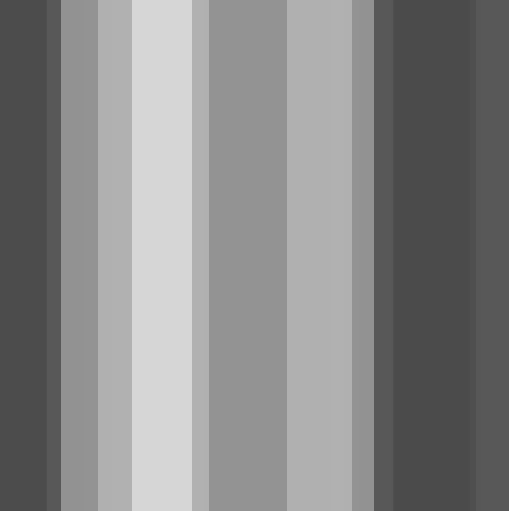

10


In [52]:
image_recoloriee, palette_utilisee = traitement_image_par_mode(img, mode="grayscale", k=10)
display(image_recoloriee)
print(len(palette_utilisee))

## Fourier sur YCbCr

Le mode YCbCr permet de décrire un pixel avec deux canaux :
- la luminance Y
- la couleur
    - Cb : distance au bleu (b)
    - Cr : distance au rouge(r)
(https://en.wikipedia.org/wiki/YCbCr)

On applique alors la transformée de Fourier uniquement sur la composante Y (similaire à l'algorithme utilisé pour la compression JPEG). (https://lehollandaisvolant.net/science/jpg/)


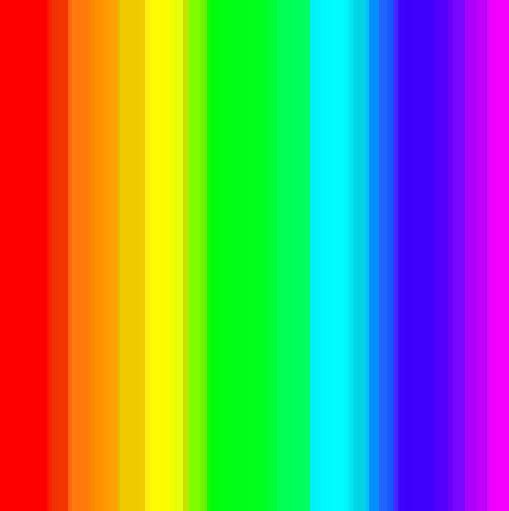

32


In [53]:
image_recoloriee, palette_utilisee = traitement_image_par_mode(img, mode="YCbCr", k=32)
display(image_recoloriee)
print(len(palette_utilisee)//3)

## Fourier en RGB

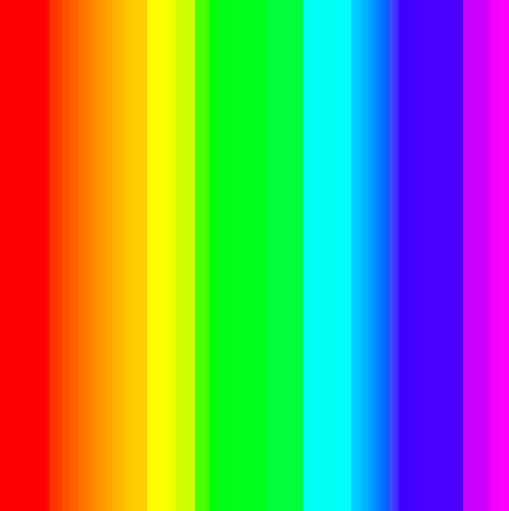

32


In [54]:
image_recoloriee, palette_utilisee = traitement_image_par_mode(img, mode="RGB", k=32)
display(image_recoloriee)
print(len(palette_utilisee)//3)

# Traitement d'images par filtres

Le prétraitement des images s'avère parfois utile afin de lisser les couleurs : il permettrait alors de choisir de meilleures couleurs représentatives et d'extraire de l'image des informations intéressanres (contours, formes,...). En particulier, dans cette partie, nous allons créer différents _filtres_ dont le but sera de transformer les valeurs des pixels afin de par exemple réduire le bruit que les images peuvent contenir (à savoir les variations locales de valeur). L'objectif est de comparer les améliorations (ou détériorations) des images entre elles.

La plupart de ces méthodes étant couteuses en temps, nous travaillerons sur une version en niveau de gris.

Commeçons par implémenter une fonction de conversion d'image en niveaux de gris (soit la moyenne des triplets `(r,g,b)` ou en utilisant la formule suivante : 

$ C_{gray} = (0.3 \times R) + (0.59 \times G) + (0.11 \times B)$

In [55]:
def conversion_gris(image):
    """Convertit une image couleur en niveaux de gris.

    Paramètres :
        image : PIL.Image.Image
            L'image à convertir.

    Retour :
        PIL.Image.Image
            Une nouvelle image en niveaux de gris.
    """
    px = image.load()
    W, H = image.size
    for x in range(0, W):
        for y in range(0, H):
            m = int(0.30*px[x, y][0] + 0.59*px[x, y][1] + 0.11*px[x, y][2])
            px[x, y] = (m, m, m)
    return image

### Test de la fonction conversion_gris

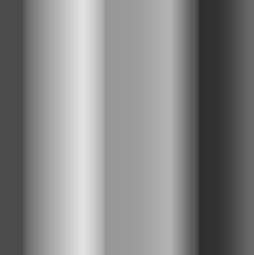

In [56]:
degrade = Image.open("rainbow.png").convert("RGB")
result = conversion_gris(degrade)
display(result.resize((W//2, H//2)))

## Flou gaussien

Nous commençons avec le filtre dit de _Flou Gaussien_, basé sur une opération dite de _convolution_, permettant d'appliquer une fonction de distribution gaussienne aux voisins d'un pixel et d'en faire la moyenne. Autrement dit il s'agira de réaliser la moyenne pondérée de chaque pixel en réalisant la moyenne du pixel et de ses voisins en utilisant par exemple la matrice ci-dessous (dont les valeurs sont définies par la distribution gaussienne donnée en annexe pour une matrice $3 \times 3$) :

$G(x) = \frac{1}{\sqrt[]{2 \pi } \sigma} e^{- \frac{x^{2}}{2 \sigma ^{2}}}$

Cela a pour effet d’atténuer les détails fins et de lisser les variations rapides de l’intensité, tout en conservant une certaine homogénéité visuelle. 

Le flou gaussien est couramment utilisé pour réduire le bruit dans une image avant l'application d'autres traitements, comme la détection de contours (par exemple avec l’algorithme de Canny), la segmentation ou le seuillage.

Commençons par définir une fonction qui calcul la somme des valeurs d'une matrice (de type `gauss3`).

In [57]:
# On définit le noyau de flou gaussien 3x3
gauss3 = [[1,2,1],
          [2,4,2],
          [1,2,1]]

# On définit un deuxième noyau de flou gaussien :

gauss7 = [[1,1,2,2,2,1,1],
          [1,2,2,4,2,2,1],
          [2,2,4,8,4,2,2],
          [2,4,8,16,8,4,2],
          [2,2,4,8,4,2,2],
          [1,2,2,4,2,2,1],
          [1,1,2,2,2,1,1]]

def somme_matrice(m: list = []) -> float:
    somme = 0
    for i in m:
        for j in i:
            somme += j
    return somme

### Test de la fonction somme_matrice

In [58]:
assert somme_matrice(gauss3) == 16
assert somme_matrice(gauss7) == 140

In [59]:
def convolution(image, m: list) -> None:
    """Applique une opération de convolution à une image.

    Paramètres :
        image : PIL.Image.Image
            L'image sur laquelle appliquer la convolution.
        m : list[list[int]]
            Le masque de convolution (noyau). Doit être une matrice carrée ou rectangulaire.

    Retour :
        PIL.Image.Image
            Une nouvelle image résultant de l'opération de convolution.
    """
    w = len(m)
    h = len(m[0])
    wp = int((w - 1) / 2)
    hp = int((h - 1) / 2)
    W, H = image.size

    somme_m = somme_matrice(m)

    imflou = image.copy()
    pxflou = imflou.load()

    px = image.load()
    pixels_copy = [[px[x, y] for y in range(H)] for x in range(W)]

    for x in range(wp, W - wp):
        for y in range(hp, H - hp):
            r_sum = g_sum = b_sum = 0
            for a in range(-wp, wp + 1):
                for b in range(-hp, hp + 1):
                    r, g, b_ = pixels_copy[x + a][y + b]
                    coeff = m[a + wp][b + hp]
                    r_sum += r * coeff
                    g_sum += g * coeff
                    b_sum += b_ * coeff
            r = int(r_sum / somme_m)
            g = int(g_sum / somme_m)
            b = int(b_sum / somme_m)
            pxflou[x, y] = (r, g, b)
            
    return imflou

### Test du flou gaussien

Pour tester notre flou gaussien, on choisira une image respectant certains critères : des détails fins (texte), des bords nets, des zones de contraste très élevé (noir/blanc ou couleurs très différentes) et quelques zones à faible contraste pour voir comment le flou agit selon les contextes.

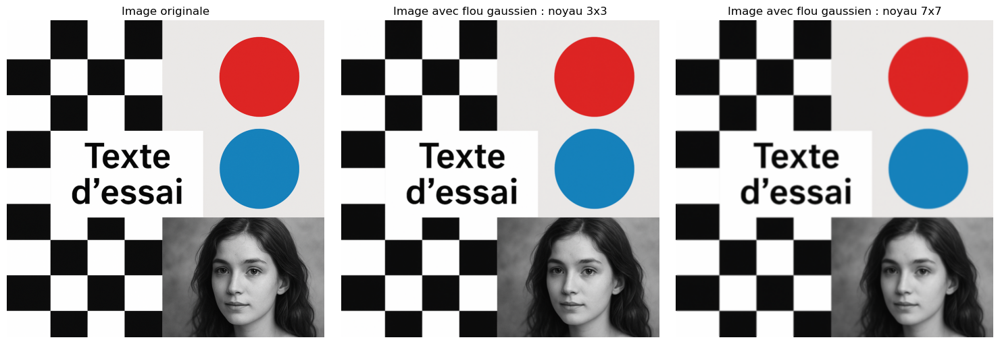

In [60]:
# On ouvre l'image de test
image_test_flou = Image.open("test_flou_gaussien.png").convert("RGB")
# On applique le flou gaussien
im_flou = convolution(image_test_flou, gauss3)
im_flou_2 = convolution(image_test_flou, gauss7)

# Affichage
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(image_test_flou)
axs[0].set_title("Image originale")
axs[0].axis('off')

axs[1].imshow(im_flou)
axs[1].set_title("Image avec flou gaussien : noyau 3x3")
axs[1].axis('off')

axs[2].imshow(im_flou_2)
axs[2].set_title("Image avec flou gaussien : noyau 7x7")
axs[2].axis('off')

plt.tight_layout()
plt.show()

Nos images ont bien été floutées : les bords ne sont plus très marqués, que ce soit les cercles, le texte d'essai ou le damier. Les détails de la photo sont beaucoup moins perceptibles et ont été adoucis grâce à la moyenne réalisée des pixels voisins autour de chaque pixel central.

Cependant, les deux images ne sont pas similaires visuellement : cela réside dans la taille du noyau utilisé, qui joue un rôle crucial dans l'intensité et l'étendue du flou appliqué. Dans ce contexte, deux noyaux de tailles différentes ont été utilisés : un noyau 3x3 et un noyau 7x7. Le noyau 3x3 (image centrale) est plus petit et applique un flou relativement léger en considérant un voisinage restreint autour de chaque pixel. Ce type de flou est moins prononcé, ce qui permet de conserver davantage de détails de l'image tout en lissant les transitions. En revanche, le noyau 7x7 est plus grand (image de droite), ce qui permet de prendre en compte un plus grand nombre de pixels voisins. Cela entraîne un flou beaucoup plus intense, avec une adoucissement notable des détails fins (cheveux de la juene fille) et une réduction de la netteté des bords. De plus, la répartition des poids dans ces noyaux est différente : le noyau 7x7 a des valeurs plus marquées au centre de la matrice (8-16), ce qui accentue le flou au centre de l'image, tandis que le noyau 3x3 distribue les poids de manière plus uniforme (2-4). En conséquence, l'image traitée avec un noyau 7x7 présente un flou plus prononcé et une perte plus importante des détails fins comparée à celle traitée avec un noyau 3x3.

Comparons maintenant notre floutage avec celui de PIL.

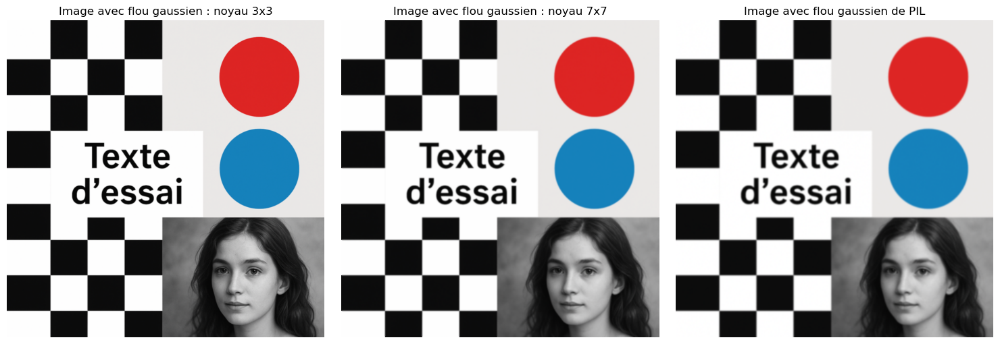

In [61]:
from PIL import Image, ImageFile, ImageDraw, ImageChops, ImageFilter
im_pil = image_test_flou.filter(ImageFilter.GaussianBlur)

# Affichage
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(im_flou)
axs[0].set_title("Image avec flou gaussien : noyau 3x3")
axs[0].axis('off')

axs[1].imshow(im_flou_2)
axs[1].set_title("Image avec flou gaussien : noyau 7x7")
axs[1].axis('off')

axs[2].imshow(im_pil)
axs[2].set_title("Image avec flou gaussien de PIL")
axs[2].axis('off')

plt.tight_layout()
plt.show()

Remarquons que le flou gaussien de type PIL (image de droite) est plus prononcé que celui appliqué avec les noyaux gauss3 ou gauss7 en raison de la normalisation automatique des noyaux dans PIL, qui assure que la somme des coefficients est égale à 1, garantissant un flou plus uniforme et plus puissant. Après quelques recherches, nous savons que PIL adapte dynamiquement le rayon du flou, ce qui offre un meilleur contrôle sur l'intensité du flou appliqué à l'image, contrairement aux noyaux statiques (gauss3 et gauss7) qui ne permettent pas une telle flexibilité.

Ces différences auront probablement un impact sur le traitement de l'image en rendant le flou appliqué avec PIL plus efficace et plus ajustable, ce qui peut être utile pour des applications nécessitant un flou plus fort ou plus ciblé. Les noyaux gauss3 et gauss7 risquent de donner un flou moins homogène et moins prononcé, limitant leur utilité pour des effets visuels plus subtils ou plus nets.

Comparons notre méthode avec d'autres types de filtres.

## Filtres de type _sobely3_ et _sobelx3_

In [62]:
# Définition des noyaux sobel
sobely3 = [[-1, 0, 1],
           [-2, 0, 2],
           [-1, 0, 1]]

sobelx3 = [[-1, -2, -1],
           [0, 0, 0],
           [1, 2, 1]]

# On réalise la détection de contour de l'image dans le sens des X ou Y avec la fonction de convolution Sobel
def convolution_sobel(image, m: list, f=1):
    """Applique un filtre de Sobel à une image pour détecter les contours.

    Paramètres :
        image : PIL.Image.Image
            L'image sur laquelle appliquer le filtre de Sobel.
        m : list[list[int]]
            Le masque de convolution de Sobel (noyau).  Doit être une matrice carrée ou rectangulaire.
        f : int, optionnel
            Facteur multiplicatif appliqué au résultat de la convolution. Par défaut, 1.

    Retour :
        PIL.Image.Image
            Une nouvelle image en niveaux de gris représentant les contours détectés.
            Les valeurs de pixels sont normalisées entre 0 et 255.
    """
    # Convertir l'image en niveaux de gris si ce n'est pas déjà le cas
    image = image.convert("L")
    px = image.load()
    W, H = image.size
    w = len(m)
    h = len(m[0])
    wp = int((w - 1) / 2)
    hp = int((h - 1) / 2)

    # Création d'une nouvelle image vide
    new_image = Image.new("L", image.size)
    new_px = new_image.load()

    min_val = float('inf')
    max_val = float('-inf')
    result = [[0 for _ in range(H)] for _ in range(W)]

    # Appliquer la convolution et stocker les résultats bruts
    for x in range(wp, W - wp):
        for y in range(hp, H - hp):
            sum = 0
            for a in range(-wp, wp + 1):
                for b in range(-hp, hp + 1):
                    sum += px[x + a, y + b] * m[a + wp][b + hp]

            result[x][y] = sum
            min_val = min(min_val, sum)
            max_val = max(max_val, sum)

    # Normalisation des valeurs dans [0, 255]
    for x in range(W):
        for y in range(H):
            val = result[x][y]
            norm_val = int(255 * (val - min_val) / (max_val - min_val)) if max_val != min_val else 0
            new_px[x, y] = norm_val

    return new_image

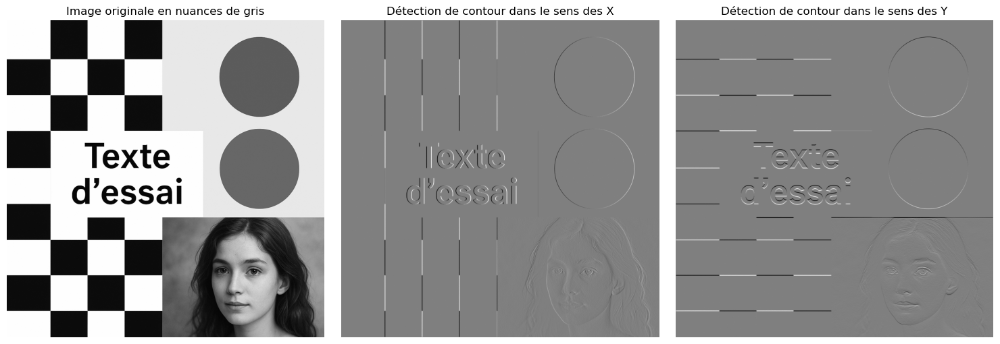

In [63]:
image_test_flou = Image.open("test_flou_gaussien.png").convert("RGB")

# On la convertit en niveau de gris
image_test_flou = conversion_gris(image_test_flou)

# Appliquer la convolution Sobel avec les noyaux
test_conv_y = convolution_sobel(image_test_flou, sobely3, f=1)
test_conv_x = convolution_sobel(image_test_flou, sobelx3, f=1)

# Affichage des images
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Affichage de l'image originale
axs[0].imshow(image_test_flou)
axs[0].set_title("Image originale en nuances de gris")
axs[0].axis('off')

# Affichage de l'image après détection de contours dans le sens des X
axs[1].imshow(test_conv_x, cmap='gray')
axs[1].set_title("Détection de contour dans le sens des X")
axs[1].axis('off')

# Affichage de l'image après détection de contours dans le sens des Y
axs[2].imshow(test_conv_y, cmap='gray')
axs[2].set_title("Détection de contour dans le sens des Y")
axs[2].axis('off')

plt.tight_layout()
plt.show()

On voit maintenant les détails des contours dans les directions X et Y !

Lorsqu'on applique les filtres sobely3 et sobelx3 avec un facteur de normalisation ou de pondération de 1, on ne réalise pas un flou mais un filtrage de détection des bords (voir https://en.wikipedia.org/wiki/Kernel_(image_processing)). En effet, les noyaux Sobel (que ce soit sobely3 ou sobelx3) sont utilisés pour détecter les bords d'une image en calculant les gradients des pixels dans la direction verticale ou horizontale : sobely3 est un noyau qui détecte les bords verticaux dans l'image (en analysant la variation d'intensité des pixels dans la direction verticale) et sobelx3 est un noyau qui détecte les bords horizontaux dans l'image (en analysant la variation des pixels dans la direction horizontale).

En appliquant ces noyaux avec un facteur de normalisation de 1, l'image ne subit pas un flou classique mais une détection des bords, où chaque pixel est affecté en fonction de son changement d'intensité par rapport à ses voisins dans la direction spécifiée. Le flou appliqué ici ne correspond donc pas au flou classique (comme le flou gaussien), mais plutôt à une accentuation des transitions de l'intensité lumineuse, ce qui permet de mettre en évidence les contours ou bords dans une image.

### Amélioration des filtres Sobel

L'idée est désormais d'améliorer la fonction précédentes afin de visualiser davantage les contours présents dans l'image.

Commençons par fusionner les deux directions en calculant un gradient global :
$ G = \sqrt{G_x^2 + G_y^2}$

In [64]:
# Calcul de la magnitude du gradient
def magnitude_gradient(gx_img, gy_img):
    """Calcule la magnitude du gradient à partir des composantes X et Y du gradient.

    Paramètres :
        gx_img : PIL.Image.Image
            L'image représentant la composante du gradient en X.
        gy_img : PIL.Image.Image
            L'image représentant la composante du gradient en Y.

    Retour :
        PIL.Image.Image
            Une nouvelle image en niveaux de gris représentant la magnitude du gradient.
            Les valeurs de pixels sont normalisées entre 0 et 255.
    """
    W, H = gx_img.size
    px_gx = gx_img.load()
    px_gy = gy_img.load()

    # Tableau pour stocker les magnitudes
    magnitude = [[0 for _ in range(H)] for _ in range(W)]
    max_val = 0

    # Calcul des magnitudes et récupération du maximum
    for x in range(W):
        for y in range(H):
            mag = math.sqrt(px_gx[x, y]**2 + px_gy[x, y]**2)
            magnitude[x][y] = mag
            max_val = max(max_val, mag)

    # Création de l'image de sortie
    new_image = Image.new("L", (W, H))
    new_px = new_image.load()

    for x in range(W):
        for y in range(H):
            norm = int(255 * magnitude[x][y] / max_val) if max_val != 0 else 0
            new_px[x, y] = norm

    return new_image

Définissons ensuite un seuillage afin d'améliorer la lisibilité en binarisant les contours. Il transforme une image en niveaux de gris (comme celle de la magnitude du gradient) en image binaire : blanc s'il y a un contour, noir sinon.

In [65]:
# Seuil binaire
def seuillage(image, seuil=100):
    """Applique un seuillage binaire à une image en niveaux de gris.

    Paramètres :
        image : PIL.Image.Image
            L'image à seuiller.
        seuil : int, optionnel
            La valeur de seuil. Les pixels avec une valeur supérieure au seuil
            deviennent blancs (255), les autres deviennent noirs (0). Par défaut, 100.

    Retour :
        PIL.Image.Image
            Une nouvelle image binaire (niveaux de gris 0 ou 255).
    """
    image = image.copy()
    px = image.load()
    W, H = image.size
    for x in range(W):
        for y in range(H):
            if px[x, y] > seuil:
                px[x, y] = 255
            else :
                px[x, y] = 0
    return image

### Test et application de nos filtres

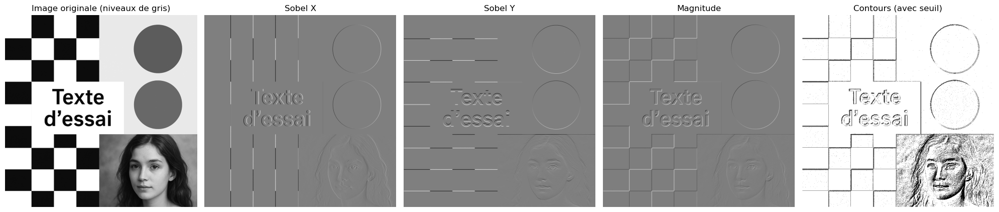

In [66]:
img = Image.open("test_flou_gaussien.png")
gx = convolution_sobel(img, sobelx3)
gy = convolution_sobel(img, sobely3)
mag = magnitude_gradient(gx, gy)
mag_thresh = seuillage(mag, seuil=142) # Attention à ne pas choisir un seuil trop élevé ni trop faible

fig, axs = plt.subplots(1, 5, figsize=(20, 5))

images = [img.convert("L"), gx, gy, mag, mag_thresh]
titles = ["Image originale (niveaux de gris)", "Sobel X", "Sobel Y", "Magnitude", "Contours (avec seuil)"]

for ax, im, title in zip(axs, images, titles):
    ax.imshow(im, cmap='gray')
    ax.set_title(title)
    ax.axis("off")

plt.tight_layout()
plt.show()

Ici, la magnitude a permis de faire apparaître les contours en nuances de gris en combinant les filtres sobel dans les deux directions de l'espace en 2D.

Mais après seuillage, on voit uniquement les zones à fort contraste : le seuillage a donc supprimé les petits détails, le bruit et les variations faibles de contraste afin de mettre en évidence uniquement les contours forts (on a conservé les bords nets et bien définis comme les cercles et le quadrillage du damier). L'objectif ici est de préparer l'image pour d'autres traitements comme la détection de formes, la lecture de texte et le comptage d’objets.

Ici, nous avons pris un seuillage de 142 mais qui pourra être légèrement diminué (140 par exemple) : en effet, on remarque des "petits points noirs" à l'intérieur des cases du damier, dans les cercles et dans le fond de l'image de la jeune fille, ce qui signifie que le seuillage prend en compte d'autres détails plus fins qu'il n'est pas nécessaire de prendre en compte lorsque l'on souhaite obtenir uniquement les contours principaux de l'image.

Nous avons désormais défini toutes les fonctions nécessaires au développement d'une synthèse comparative de nos algorithmes. Dans cette dernière partie, nous analyserons leurs réponses pour différents types d'images et nous dresserons enfin un tableau récapitulatif des usages privilégiés de ces algorithmes.

# Synthèse comparative des méthodes développées 

Afin d'obtenir une synthèse comparative robuste, il nous faut un panel d'images varité couvrant différents cas d'usage. Nous allons utiliser une sélection d'images-types, classées par caractéristiques visuelles pour tester les algorithmes sur divers défis :
- image à palette restreinte : illustrations vectorielles, dessins simplifiés
- image naturelle complexe : photographies de paysages haute résolution
- image avec couleurs saturées et/ou vives 
- image à textures fines ou bruitées
- image artistique et/ou abstraite

## Fonctions de synthèse

La fonction score_synthese permet de synthétiser les différents scores obtenus pour une certaine image par les différents algorithmes. Elle sera utilisée après chaque test d'image.

In [67]:
def score_synthese(image_originale, img1, img2, img3, img4, img5, img6, algos, choix_distance=distance_euclid):
    
    # Liste des images recoloriées
    images_recolorees = [img1, img2, img3, img4, img5, img6]

    # On récupère les élements de l'image
    largeur, hauteur = image_originale.size
    pixels_orig = image_originale.load()
    
    # Distance maximale possible entre deux couleurs RGB (du noir au blanc)
    distance_max = choix_distance((0, 0, 0), (255, 255, 255))
    erreurs_totale = []
    erreurs_moyenne = []
    pourcentages_erreur = []

    for k in range(len(images_recolorees)):
        image_recoloriee = images_recolorees[k]
        pixels_reco = image_recoloriee.load()

        erreur_totale = 0
        for i in range(largeur):
            for j in range(hauteur):
                couleur1 = pixels_orig[i, j]         # pixel original
                couleur2 = pixels_reco[i, j]         # pixel recolorié
                erreur_totale += choix_distance(couleur1, couleur2)
        
        erreurs_totale.append(erreur_totale)
        erreur_moyenne = erreur_totale / (largeur * hauteur)
        erreurs_moyenne.append(erreur_moyenne)
        pourcentage_erreur = (erreur_moyenne / distance_max) * 100
        pourcentages_erreur.append(pourcentage_erreur)

        print(f"------ {algos[k]} ------")
        print(f"erreur_totale : {round(erreur_totale, 2)}")
        print(f"erreur_moyenne : {round(erreur_moyenne, 2)}")
        print(f"pourcentage_erreur : {round(pourcentage_erreur, 2)}")


## Portrait de Lovelace

Maintenant que nous disposons de tous les outils nécessaires à notre analyse, nous commencons par tester nos algorithmes avec la distance euclidienne, la distance la plus intuitive à utiliser pour commencer, sur le portrait de la femme qui a donné naissance à l'informatique contemporaine <b>Ada Lovelace</b>.

### Distance euclidienne

On commence par générer l'image recoloriée pour les 6 algorithmes que nous avons implémentés :
<ol>
    <li>Median Cut</li>
    <li>Octree</li>
    <li>K-Means</li>
    <li>Méthode Naïve</li>
    <li>Fourier YCbCr</li>
    <li>Fourier RGB</li>
</ol>
et on affiche les résultats.

<b> Couleurs</b>

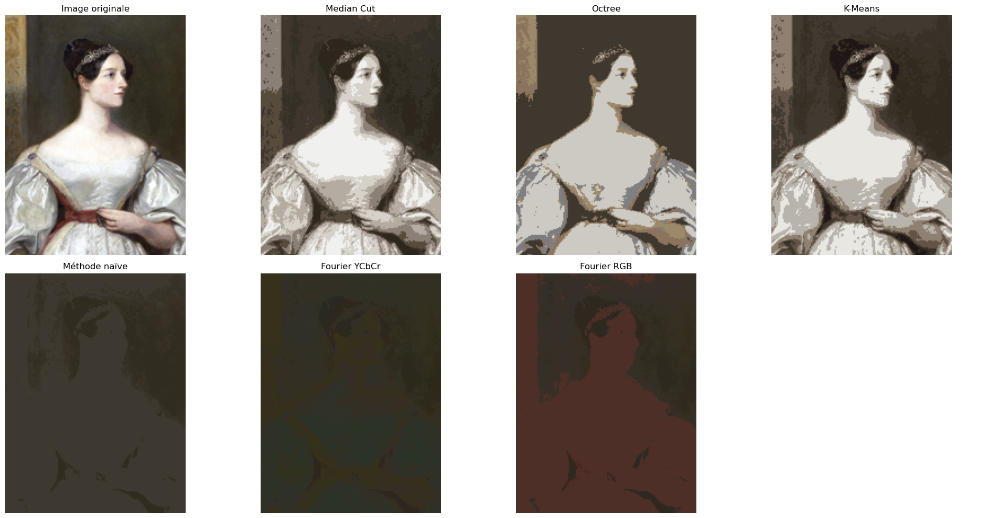

In [68]:
k=8
nb_iter=10
n=math.floor(math.log(k)/math.log(2))
choix_distance = distance_euclid
img_lovelace = Image.open("lovelace.png").convert("RGB")

img_lovelace_euclid_median_cut = recoloriage_MedianCut(img_lovelace, n, choix_distance)
img_lovelace_euclid_octree, pallette_octree = image_octree(img_lovelace, k, choix_distance)
img_lovelace_euclid_k_means = kmeans(img_lovelace, k, nb_iter, choix_distance)

img_lovelace_euclid_methode_naive, palette_naive = methode_naive(img_lovelace, choix_distance,k)
img_lovelace_euclid_fourier_YCbCr, palette_YCbCr = traitement_image_par_mode(img_lovelace, mode="YCbCr", k=k) 
img_lovelace_euclid_fourier_RGB, palette_RGB = traitement_image_par_mode(img_lovelace, mode="RGB", k=k) 

images_lovelace_euclid = [img_lovelace.convert("RGB"), img_lovelace_euclid_median_cut, img_lovelace_euclid_octree, img_lovelace_euclid_k_means,
          img_lovelace_euclid_methode_naive, img_lovelace_euclid_fourier_YCbCr, img_lovelace_euclid_fourier_RGB]

#images = [img.convert("RGB"), img.convert("RGB"), img.convert("RGB"), img.convert("RGB"),
#          img.convert("RGB"), img.convert("RGB"), img.convert("RGB")]

titles = ["Image originale", "Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_lovelace_euclid)):
    axs[i].imshow(images_lovelace_euclid[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

Qualitativement, on remarque que seuls les algorithmes Median Cut et K-Means semblent restituer fidèlement l'image originale pour la distance euclidienne.

A contrario, les méthodes naïve et de Fourier fournissent un résultat médiocre pour ce type d'image, ie. un portait sombre ou des images artistiques.

Quant à l'agorithme Octree, les formes et couleurs principales sont restituées mais l'ensemble manque de finesse.

Pour compléter cette analyse visuelle, intéressons-nous à la différence numérique (quantitative) entre les images recoloriées et l'image originale grâce au calcul d'erreur.

<b> Différence </b>

La méthode <i>difference</i> présentée plus haut permet de superposer les erreurs entre les images originale et recoloriée. Rappelons que plus une zone est rouge et plus l'erreur commise par l'algorithme lors du recoloriage est importante (pour la distance choisie).

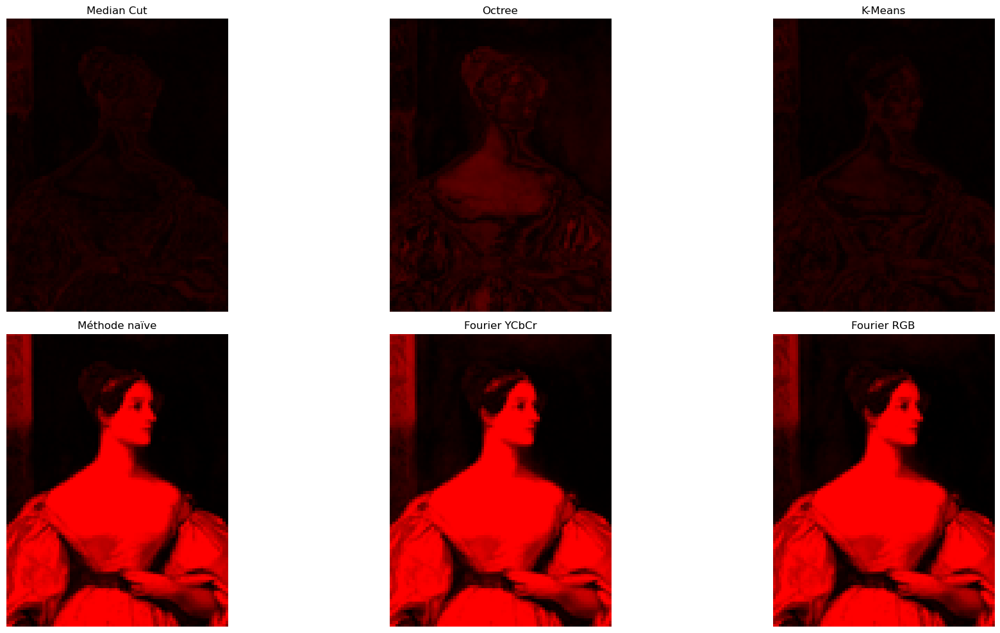

In [69]:


diff_lovelace_euclid_median_cut = difference(img_lovelace, img_lovelace_euclid_median_cut, choix_distance)
diff_lovelace_euclid_octree = difference(img_lovelace, img_lovelace_euclid_octree, choix_distance)
diff_lovelace_euclid_k_means = difference(img_lovelace, img_lovelace_euclid_k_means, choix_distance)

diff_lovelace_euclid_methode_naive = difference(img_lovelace, img_lovelace_euclid_methode_naive, choix_distance)
diff_lovelace_euclid_fourier_YCbCr = difference(img_lovelace, img_lovelace_euclid_fourier_YCbCr, choix_distance)
diff_lovelace_euclid_fourier_RGB = difference(img_lovelace, img_lovelace_euclid_fourier_RGB, choix_distance)

images_diff_lovelace_euclid = [diff_lovelace_euclid_median_cut, diff_lovelace_euclid_octree, diff_lovelace_euclid_k_means,
          diff_lovelace_euclid_methode_naive, diff_lovelace_euclid_fourier_YCbCr, diff_lovelace_euclid_fourier_RGB]

#images = [img.convert("RGB"), img.convert("RGB"), img.convert("RGB"), img.convert("RGB"),
#          img.convert("RGB"), img.convert("RGB"), img.convert("RGB")]

titles = ["Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 3, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_diff_lovelace_euclid)):
    axs[i].imshow(images_diff_lovelace_euclid[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

Ces images confirment nos premières impressions : l'erreur semble plus importante pour les algorithmes naïf, Fourier YCbCr et Fourier RGB. D'autre part, les deux algorithmes avec le moins d'erreur sont Median-Cut et K-Means et Octree se situe entre les deux.

On remarque cependant qu'il est difficile de différencier Median Cut et K-Means avec cette visualisation. C'est la raison pour laquelle on utilise la méthode <i>score_synthese</i> qui quantifie l'erreur.

In [70]:
score_synthese(img_lovelace, img_lovelace_euclid_median_cut, img_lovelace_euclid_octree, img_lovelace_euclid_k_means, img_lovelace_euclid_methode_naive, img_lovelace_euclid_fourier_YCbCr, img_lovelace_euclid_fourier_RGB, ["Median Cut", "Octree", "Kmeans", "Naive", "YCbCr", "RGB"], distance_euclid)

------ Median Cut ------
erreur_totale : 532600.28
erreur_moyenne : 15.63
pourcentage_erreur : 3.54
------ Octree ------
erreur_totale : 1000653.76
erreur_moyenne : 29.36
pourcentage_erreur : 6.65
------ Kmeans ------
erreur_totale : 583754.3
erreur_moyenne : 17.13
pourcentage_erreur : 3.88
------ Naive ------
erreur_totale : 4144815.53
erreur_moyenne : 121.62
pourcentage_erreur : 27.54
------ YCbCr ------
erreur_totale : 4574439.66
erreur_moyenne : 134.23
pourcentage_erreur : 30.39
------ RGB ------
erreur_totale : 4225203.35
erreur_moyenne : 123.98
pourcentage_erreur : 28.07


Désormais, cela ne fait plus aucun doute, c'est l'algorithme K-Means qui minimise l'erreur (3.48% d'erreur contre 3.54% pour Median Cut).

Ce résultat dépend il de la distance choisie ? Les distances $\Delta E 76$ et $\Delta E 2000$ permettent normalement de retranscrire plus fidèlement la perseption de l'oeil humain. Les résultats seront-ils différents ?

Réitérons le procédé avec la distance $\Delta E 76$, c'est-à-dire la distance euclidenne dans l'espace LAB de couleurs.

### Distance $\Delta E 76$

<b> Couleurs</b>

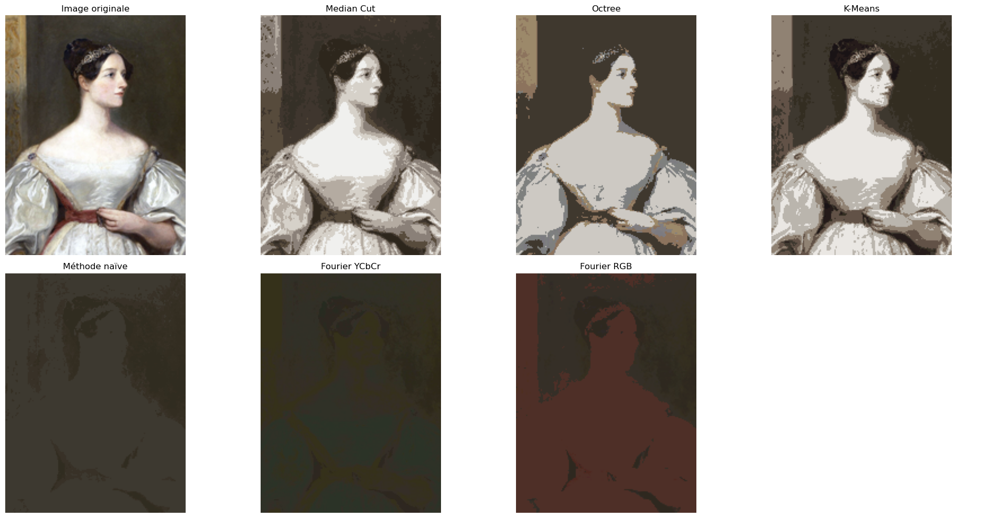

In [71]:
k=8
nb_iter=10
n=math.floor(math.log(k)/math.log(2))
choix_distance = distance_lab
img_lovelace = Image.open("lovelace.png").convert("RGB")

img_lovelace_76_median_cut = recoloriage_MedianCut(img_lovelace, n, choix_distance)
img_lovelace_76_octree, pallette_octree = image_octree(img_lovelace, k, choix_distance)
img_lovelace_76_k_means = kmeans(img_lovelace, k, nb_iter, choix_distance)

img_lovelace_76_methode_naive, palette_naive_lovelace_76_ = methode_naive(img_lovelace, choix_distance,k)
img_lovelace_76_fourier_YCbCr, palette_lovelace_76_YCbCr = traitement_image_par_mode(img_lovelace, mode="YCbCr", k=k) 
img_lovelace_76_fourier_RGB, palette_lovelace_76_RGB = traitement_image_par_mode(img_lovelace, mode="RGB", k=k) 

images_lovelace_76 = [img_lovelace.convert("RGB"), img_lovelace_76_median_cut, img_lovelace_76_octree, img_lovelace_76_k_means,
          img_lovelace_76_methode_naive, img_lovelace_76_fourier_YCbCr, img_lovelace_76_fourier_RGB]

#images = [img.convert("RGB"), img.convert("RGB"), img.convert("RGB"), img.convert("RGB"),
#          img.convert("RGB"), img.convert("RGB"), img.convert("RGB")]

titles = ["Image originale", "Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_lovelace_76)):
    axs[i].imshow(images_lovelace_76[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

Qualitativement, les algorithmes qui semblent restituer au mieux l'image originale sont ceux de Median Cut et de K-means. Ils sont suivis par Octree quand la méthode naïve et Fourier n'optent pas pour la bonne palette de couleur. Cependant, ces derniers restituent fidèlement les formes principales de l'image.

<b> Différence </b>

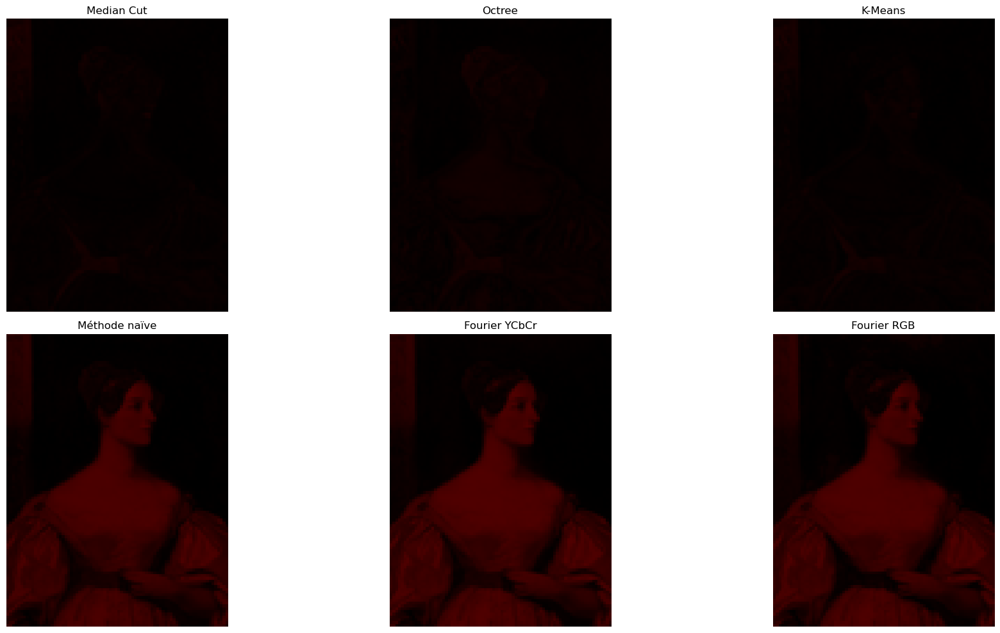

In [72]:


diff_lovelace_e76_median_cut = difference(img_lovelace, img_lovelace_76_median_cut, choix_distance)
diff_lovelace_e76_octree = difference(img_lovelace, img_lovelace_76_octree, choix_distance)
diff_lovelace_e76_k_means = difference(img_lovelace, img_lovelace_76_k_means, choix_distance)

diff_lovelace_e76_methode_naive = difference(img_lovelace, img_lovelace_76_methode_naive, choix_distance)
diff_lovelace_e76_fourier_YCbCr = difference(img_lovelace, img_lovelace_76_fourier_YCbCr, choix_distance)
diff_lovelace_e76_fourier_RGB = difference(img_lovelace, img_lovelace_76_fourier_RGB, choix_distance)

diff_lovelace_76 = [diff_lovelace_e76_median_cut, diff_lovelace_e76_octree, diff_lovelace_e76_k_means,
          diff_lovelace_e76_methode_naive, diff_lovelace_e76_fourier_YCbCr, diff_lovelace_e76_fourier_RGB]

titles = ["Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 3, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(diff_lovelace_76)):
    axs[i].imshow(diff_lovelace_76[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

In [73]:
score_synthese(img_lovelace, img_lovelace_76_median_cut, img_lovelace_76_octree, img_lovelace_76_k_means, img_lovelace_76_methode_naive, img_lovelace_76_fourier_YCbCr, img_lovelace_76_fourier_RGB, ["Median Cut", "Octree", "Kmeans", "Naive", "YCbCr", "RGB"], distance_lab)

------ Median Cut ------
erreur_totale : 201561.93
erreur_moyenne : 5.91
pourcentage_erreur : 5.91
------ Octree ------
erreur_totale : 280607.04
erreur_moyenne : 8.23
pourcentage_erreur : 8.23
------ Kmeans ------
erreur_totale : 200170.4
erreur_moyenne : 5.87
pourcentage_erreur : 5.87
------ Naive ------
erreur_totale : 993195.31
erreur_moyenne : 29.14
pourcentage_erreur : 29.14
------ YCbCr ------
erreur_totale : 1075312.79
erreur_moyenne : 31.55
pourcentage_erreur : 31.55
------ RGB ------
erreur_totale : 1057038.61
erreur_moyenne : 31.02
pourcentage_erreur : 31.02


On remarque que les erreurs de chaque algorithme sont plus grandes en utilisant cette distance que la distance euclidienne. Cependant, la conclusion reste inchangée, qualitativement et quantitativement, c'est l'agorithme K-Means qui reconstitue le plus fidèlement l'image.

Il reste enfin à comparer avec la distance $\Delta E 2000$.

### Distance $\Delta E 2000$

<b> Couleurs</b>

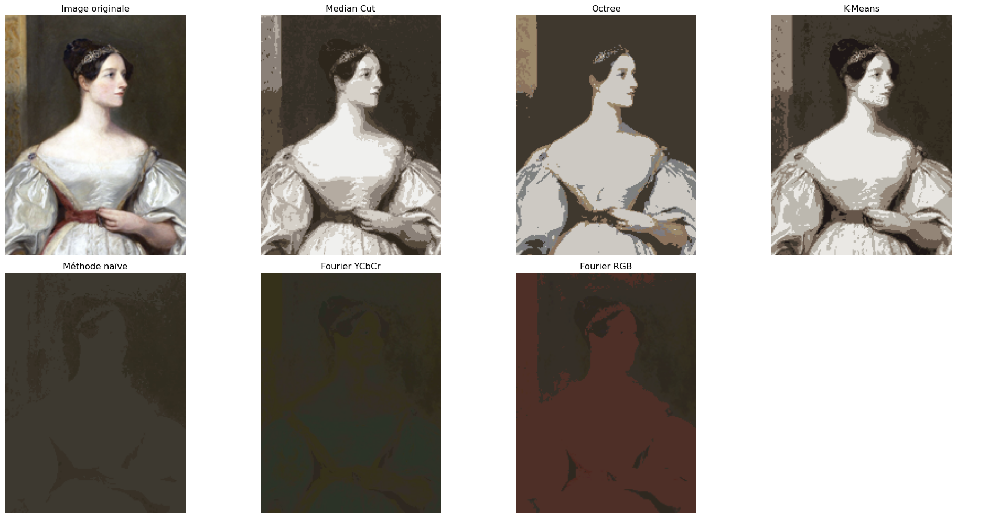

In [74]:
k=8
nb_iter=10
n=math.floor(math.log(k)/math.log(2))
choix_distance = delta_e_2000
img_lovelace = Image.open("lovelace.png").convert("RGB")

img_lovelace_2000_median_cut = recoloriage_MedianCut(img_lovelace, n, choix_distance)
img_lovelace_2000_octree, pallette_octree = image_octree(img_lovelace, k, choix_distance)
img_lovelace_2000_k_means = kmeans(img_lovelace, k, nb_iter, choix_distance)

img_lovelace_2000_methode_naive, palette_naive_lovelace_76_ = methode_naive(img_lovelace, choix_distance,k)
img_lovelace_2000_fourier_YCbCr, palette_lovelace_76_YCbCr = traitement_image_par_mode(img_lovelace, mode="YCbCr", k=k) 
img_lovelace_2000_fourier_RGB, palette_lovelace_76_RGB = traitement_image_par_mode(img_lovelace, mode="RGB", k=k) 

images_lovelace_2000 = [img_lovelace.convert("RGB"), img_lovelace_2000_median_cut, img_lovelace_2000_octree, img_lovelace_2000_k_means,
          img_lovelace_2000_methode_naive, img_lovelace_2000_fourier_YCbCr, img_lovelace_2000_fourier_RGB]

#images = [img.convert("RGB"), img.convert("RGB"), img.convert("RGB"), img.convert("RGB"),
#          img.convert("RGB"), img.convert("RGB"), img.convert("RGB")]

titles = ["Image originale", "Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_lovelace_2000)):
    axs[i].imshow(images_lovelace_2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

Qualitativement, les résultats sont visuellement proches de ceux fournis par la distance $\Delta E 76$.

<b> Différence</b>

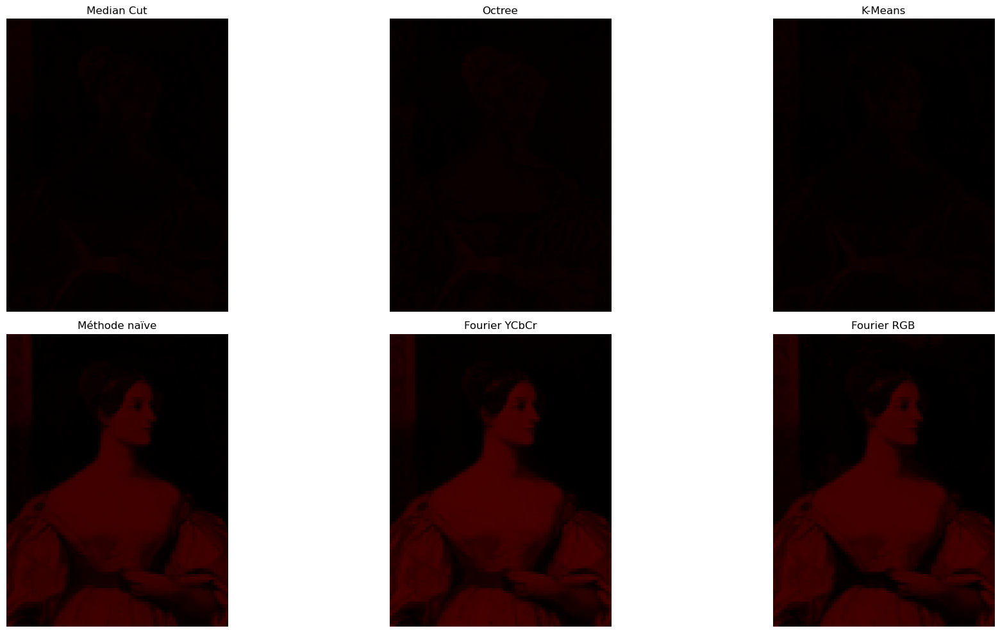

In [75]:


diff_lovelace_2000_median_cut = difference(img_lovelace, img_lovelace_2000_median_cut, choix_distance)
diff_lovelace_2000_octree = difference(img_lovelace, img_lovelace_2000_octree, choix_distance)
diff_lovelace_2000_k_means = difference(img_lovelace, img_lovelace_2000_k_means, choix_distance)

diff_lovelace_2000_methode_naive = difference(img_lovelace, img_lovelace_2000_methode_naive, choix_distance)
diff_lovelace_2000_fourier_YCbCr = difference(img_lovelace, img_lovelace_2000_fourier_YCbCr, choix_distance)
diff_lovelace_2000_fourier_RGB = difference(img_lovelace, img_lovelace_2000_fourier_RGB, choix_distance)

diff_lovelace_2000 = [diff_lovelace_2000_median_cut, diff_lovelace_2000_octree, diff_lovelace_2000_k_means,
          diff_lovelace_2000_methode_naive, diff_lovelace_2000_fourier_YCbCr, diff_lovelace_2000_fourier_RGB]

titles = ["Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 3, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(diff_lovelace_2000)):
    axs[i].imshow(diff_lovelace_2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

In [76]:
score_synthese(img_lovelace, img_lovelace_2000_median_cut, img_lovelace_2000_octree, img_lovelace_2000_k_means, img_lovelace_2000_methode_naive, img_lovelace_2000_fourier_YCbCr, img_lovelace_2000_fourier_RGB, ["Median Cut", "Octree", "Kmeans", "Naive", "YCbCr", "RGB"], delta_e_2000)

------ Median Cut ------
erreur_totale : 172743.97
erreur_moyenne : 5.07
pourcentage_erreur : 5.07
------ Octree ------
erreur_totale : 221488.08
erreur_moyenne : 6.5
pourcentage_erreur : 6.5
------ Kmeans ------
erreur_totale : 167045.67
erreur_moyenne : 4.9
pourcentage_erreur : 4.9
------ Naive ------
erreur_totale : 909651.22
erreur_moyenne : 26.69
pourcentage_erreur : 26.69
------ YCbCr ------
erreur_totale : 994747.29
erreur_moyenne : 29.19
pourcentage_erreur : 29.19
------ RGB ------
erreur_totale : 976168.49
erreur_moyenne : 28.64
pourcentage_erreur : 28.64



Les résultats pour cette distance sont qualitativement et quantitativement proches de la distance $\Delta E 76$ et la conclusion est identique :

> <b>Pour ce type d'image (portrait sombre, artistique), l'algorithme des K-Means est celui qui minise l'erreur entre l'image originale et recoloriée.
On nuance cette conclusion par la complexité spatiale et temporelle élevée de cet algorithme.
Pour un résultat plus rapide et une erreur similaire, l'agorithme Median Cut semble bien mieux adapté. </b>

Notons tout de même que les erreurs sont plus faibles avec la distance $\Delta E 2000$ que $\Delta E 76$ mais que restent plus importantes qu'avec la distance euclidienne. Cependant, il faut tenir compte du résultat visuel qui est moins bon avec la distance euclidienne. Cela s'explique par le fait que travailler dans l'espace CIELAB des couleurs permet de pondérer visuellement les couleurs perceptibles par l'oeil humain.

C'est la raison pour laquelle la distance $\Delta E 2000$ est la distance qui semble la plus adaptée pour faire du traitement d'images puisqu'elle tient de la perception colorimétrique de l'oeil humain. Pour s'en assurer et confirmer notre hypothèse, nous réitererons par la suite l'expérience précédente en affichant le résultat de nos algorithmes pour les 3 distances différentes.

## Paysage

Travaillons désormais avec une image de paysage, d'une très haute résolution et de grande taille. Malheureusement, certains algorithmes étant très longs à s'exécuter (Octree), nous avons fait le choix de compresser l'image originale afin de réduire la quantité de données à traiter par les algorithmes. La palette de couleurs disponibles dans cette image étant très importante, il reste intéressant, malgré cette compression, d'observer comment chaque algorithme parvient à retranscrire la grande quantité d'informations dans l'image recoloriée, présentes initialement dans l'image originale.

### Distance euclidienne

<b> Couleurs</b>

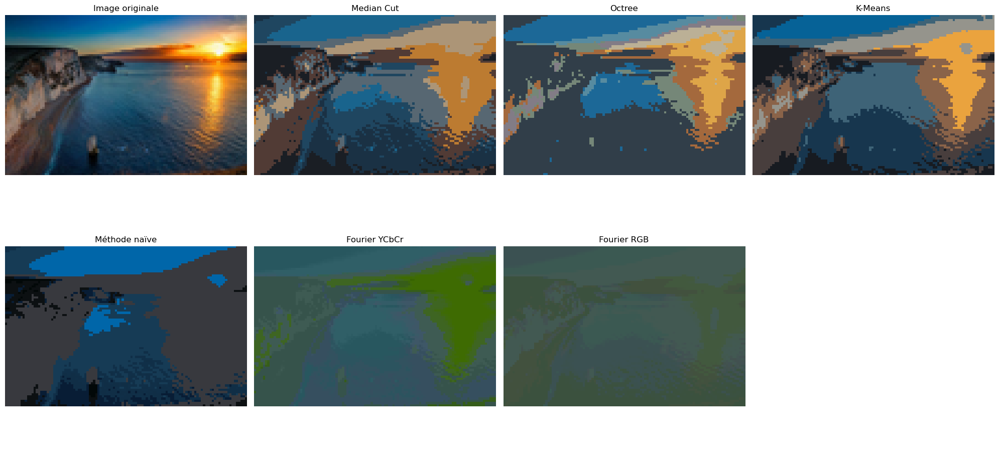

In [77]:
k=8
nb_iter=10
n=math.floor(math.log(k)/math.log(2))
choix_distance = distance_euclid
img_paysage = Image.open("paysage.png").convert("RGB")

img_paysage_euclid_median_cut = recoloriage_MedianCut(img_paysage, n, choix_distance)
img_paysage_euclid_octree, pallette_octree = image_octree(img_paysage, k, choix_distance)
img_paysage_euclid_k_means = kmeans(img_paysage, k, nb_iter, choix_distance)

img_paysage_euclid_methode_naive, palette_naive = methode_naive(img_paysage, choix_distance,k)
img_paysage_euclid_fourier_YCbCr, palette_YCbCr = traitement_image_par_mode(img_paysage, mode="YCbCr", k=k) 
img_paysage_euclid_fourier_RGB, palette_RGB = traitement_image_par_mode(img_paysage, mode="RGB", k=k) 

images_paysage_euclid = [img_paysage.convert("RGB"), img_paysage_euclid_median_cut, img_paysage_euclid_octree, img_paysage_euclid_k_means,
          img_paysage_euclid_methode_naive, img_paysage_euclid_fourier_YCbCr, img_paysage_euclid_fourier_RGB]

titles = ["Image originale", "Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_paysage_euclid)):
    axs[i].imshow(images_paysage_euclid[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

Tout d'abord, qualitativement, remarquons qu'avec une petite palette de couleurs (k=8 ici), l'image reste visuellement très mal restituée. La méthode naïve ne tient même plus compte de la couleur du soleil et de ses reflets. De son côté, Fourier semble tenir compte des détails et des différentes parties constituant l'image, bien que les couleurs choisies pour le recoloriage soient ternes.

Ensuite, concernant les 3 algorithmes Median Cut, Octree et K-Means, les palettes de couleurs sont similaires. La partie droite de l'image (soleil et reflets) semble mieux restituée au niveau des couleurs et de leur dégradé par K-Means et Octree tandis que les parties gauche et basse de l'image (falaise et houle de l'eau) sont plus fidèles sur la reconstitution par Median Cut.

Globalement, K-Means semble être le compromis idéal pour restituer l'image la plus fidèle à l'oeil, pour la distance euclidienne. Notons par ailleurs qu'un nombre plus important de couleurs présentes dans la palette aurait probablement permis une image de bonne qualité par K-Means.

<b> Différence</b>

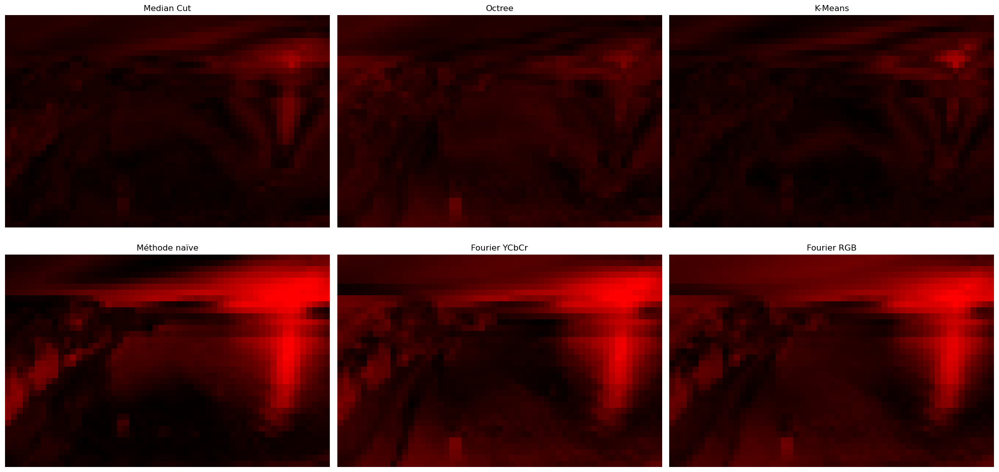

In [78]:


diff_paysage_euclid_median_cut = difference(img_paysage, img_paysage_euclid_median_cut, choix_distance)
diff_paysage_euclid_octree = difference(img_paysage, img_paysage_euclid_octree, choix_distance)
diff_paysage_euclid_k_means = difference(img_paysage, img_paysage_euclid_k_means, choix_distance)

diff_paysage_euclid_methode_naive = difference(img_paysage, img_paysage_euclid_methode_naive, choix_distance)
diff_paysage_euclid_fourier_YCbCr = difference(img_paysage, img_paysage_euclid_fourier_YCbCr, choix_distance)
diff_paysage_euclid_fourier_RGB = difference(img_paysage, img_paysage_euclid_fourier_RGB, choix_distance)

diff_paysage_euclid = [diff_paysage_euclid_median_cut, diff_paysage_euclid_octree, diff_paysage_euclid_k_means,
          diff_paysage_euclid_methode_naive, diff_paysage_euclid_fourier_YCbCr, diff_paysage_euclid_fourier_RGB]

titles = ["Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 3, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(diff_paysage_euclid)):
    axs[i].imshow(diff_paysage_euclid[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

In [79]:
score_synthese(img_paysage, img_paysage_euclid_median_cut, img_paysage_euclid_octree, img_paysage_euclid_k_means, img_paysage_euclid_methode_naive, img_paysage_euclid_fourier_YCbCr, img_paysage_euclid_fourier_RGB, ["Median Cut", "Octree", "Kmeans", "Naive", "YCbCr", "RGB"], distance_euclid)

------ Median Cut ------
erreur_totale : 254866.42
erreur_moyenne : 31.74
pourcentage_erreur : 7.19
------ Octree ------
erreur_totale : 317347.63
erreur_moyenne : 39.52
pourcentage_erreur : 8.95
------ Kmeans ------
erreur_totale : 227844.26
erreur_moyenne : 28.37
pourcentage_erreur : 6.42
------ Naive ------
erreur_totale : 513976.77
erreur_moyenne : 64.01
pourcentage_erreur : 14.49
------ YCbCr ------
erreur_totale : 567166.68
erreur_moyenne : 70.63
pourcentage_erreur : 15.99
------ RGB ------
erreur_totale : 571203.48
erreur_moyenne : 71.13
pourcentage_erreur : 16.11


Ces images de différence nous permettent de confirmer notre observation initiale, à savoir que le soleil, ses rayons et les reflets sur l'eau ont plus de difficulté à être reconstitués.

Concernant les scores, ils restent globalement plus élevés que l'image précédente (ce qui semble logique si l'on tient compte de la complexité de l'image originale). C'est l'algorithme de K-Means qui minimise les erreurs.
Remarquons de nouveau une parfaite cohérente entre les résultats qualitatif et quantitatif pour la distance euclidienne, comme pour le portrait de Lovelace.

Effectuons cette fois-ci le test avec la distance $\Delta E 76$, distance euclidienne dans l'espace de couleurs CIELAB, afin de poursuivre notre étude de l'impact de la distance sur le résultat de notre algorithme.

### Distance $\Delta E 76$

<b> Couleurs</b>

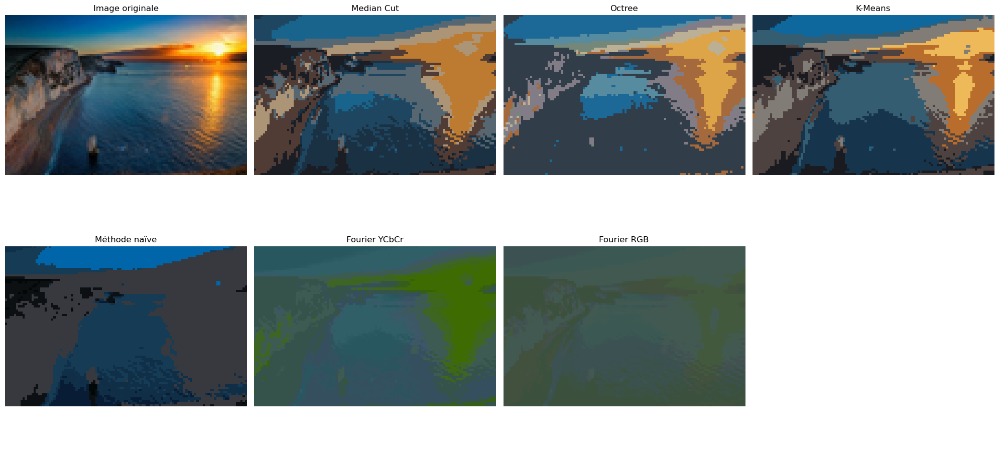

In [80]:
k=8
nb_iter=10
n=math.floor(math.log(k)/math.log(2))
choix_distance = distance_lab
img_paysage = Image.open("paysage.png").convert("RGB")

img_paysage_e76_median_cut = recoloriage_MedianCut(img_paysage, n, choix_distance)
img_paysage_e76_octree, pallette_octree = image_octree(img_paysage, k, choix_distance)
img_paysage_e76_k_means = kmeans(img_paysage, k, nb_iter, choix_distance)

img_paysage_e76_methode_naive, palette_naive = methode_naive(img_paysage, choix_distance,k)
img_paysage_e76_fourier_YCbCr, palette_YCbCr = traitement_image_par_mode(img_paysage, mode="YCbCr", k=k) 
img_paysage_e76_fourier_RGB, palette_RGB = traitement_image_par_mode(img_paysage, mode="RGB", k=k) 

images_paysage_e76 = [img_paysage.convert("RGB"), img_paysage_e76_median_cut, img_paysage_e76_octree, img_paysage_e76_k_means,
          img_paysage_e76_methode_naive, img_paysage_e76_fourier_YCbCr, img_paysage_e76_fourier_RGB]

titles = ["Image originale", "Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_paysage_e76)):
    axs[i].imshow(images_paysage_e76[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

A première vue, c'est K-Means qui semble restituer les détails les plus importants de l'image, suivi par Median Cut. Notons tout de même une chose : Octree restitue les détails fins au niveau des nuances et du dégradé de couleurs dans le ciel et à la surface de l'eau, au détriment de la forme générale de l'image.

D'autre part, Fourier restitue très bien la forme globale des éléments présents dans l'image au détriment du contraste et d'un choix optimal de la palette de couleurs. Fourier YCbCr présente même du vert alors que cette couleur n'est pas présente originellement.

<b> Différence</b>

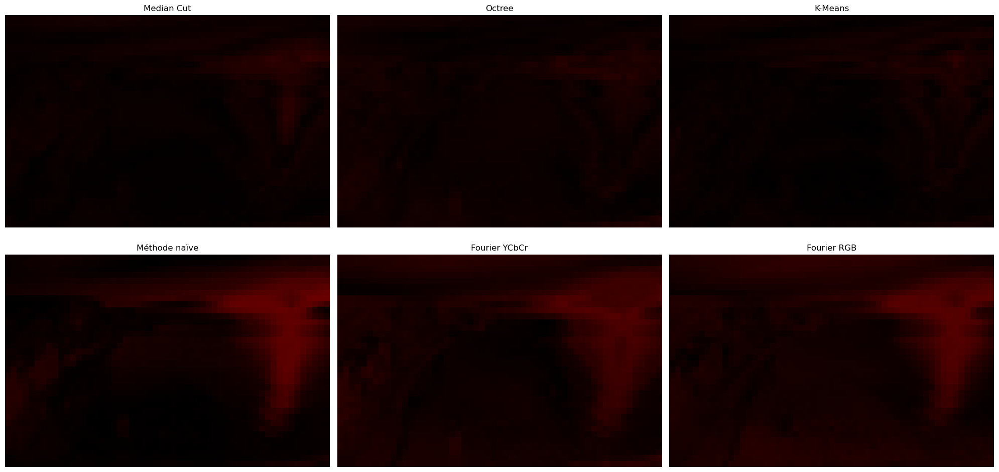

In [81]:


diff_paysage_e76_median_cut = difference(img_paysage, img_paysage_e76_median_cut, choix_distance)
diff_paysage_e76_octree = difference(img_paysage, img_paysage_e76_octree, choix_distance)
diff_paysage_e76_k_means = difference(img_paysage, img_paysage_e76_k_means, choix_distance)

diff_paysage_e76_methode_naive = difference(img_paysage, img_paysage_e76_methode_naive, choix_distance)
diff_paysage_e76_fourier_YCbCr = difference(img_paysage, img_paysage_e76_fourier_YCbCr, choix_distance)
diff_paysage_e76_fourier_RGB = difference(img_paysage, img_paysage_e76_fourier_RGB, choix_distance)

diff_paysage_e76 = [diff_paysage_e76_median_cut, diff_paysage_e76_octree, diff_paysage_e76_k_means,
          diff_paysage_e76_methode_naive, diff_paysage_e76_fourier_YCbCr, diff_paysage_e76_fourier_RGB]

titles = ["Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 3, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(diff_paysage_e76)):
    axs[i].imshow(diff_paysage_e76[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

In [82]:
score_synthese(img_paysage, img_paysage_e76_median_cut, img_paysage_e76_octree, img_paysage_e76_k_means, img_paysage_e76_methode_naive, img_paysage_e76_fourier_YCbCr, img_paysage_e76_fourier_RGB, ["Median Cut", "Octree", "Kmeans", "Naive", "YCbCr", "RGB"], distance_lab)

------ Median Cut ------
erreur_totale : 92460.19
erreur_moyenne : 11.51
pourcentage_erreur : 11.51
------ Octree ------
erreur_totale : 113636.41
erreur_moyenne : 14.15
pourcentage_erreur : 14.15
------ Kmeans ------
erreur_totale : 84450.62
erreur_moyenne : 10.52
pourcentage_erreur : 10.52
------ Naive ------
erreur_totale : 179306.22
erreur_moyenne : 22.33
pourcentage_erreur : 22.33
------ YCbCr ------
erreur_totale : 211087.89
erreur_moyenne : 26.29
pourcentage_erreur : 26.29
------ RGB ------
erreur_totale : 236313.85
erreur_moyenne : 29.43
pourcentage_erreur : 29.43


Au niveau des erreurs, Kmeans est à nouveau l'algorithme qui, numériquement, restitue le plus fidèlement l'image. A nouveau, parfaite cohérence entre les résultats qualitatifs et quantitatifs pour cette distance.

Les erreurs sont davantage importantes avec cette distance qu'avec la distance euclidienne, ce qui reste également cohérent avec la conclusion que nous avions faite avec le portrait de Lovelace.

### Distance $\Delta E 2000$

<b> Couleur</b>

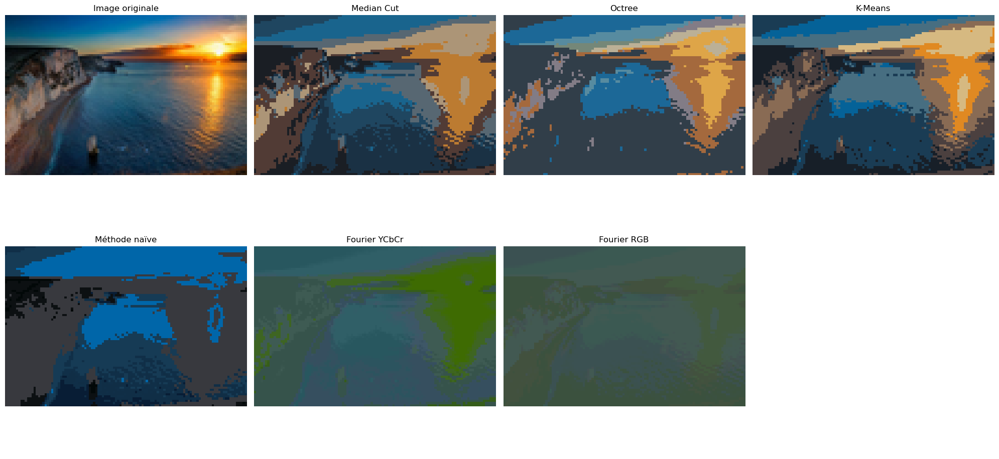

In [83]:
k=8
nb_iter=10
n=math.floor(math.log(k)/math.log(2))
choix_distance = delta_e_2000
img_paysage = Image.open("paysage.png").convert("RGB")

img_paysage_e2000_median_cut = recoloriage_MedianCut(img_paysage, n, choix_distance)
img_paysage_e2000_octree, pallette_octree = image_octree(img_paysage, k, choix_distance)
img_paysage_e2000_k_means = kmeans(img_paysage, k, nb_iter, choix_distance)

img_paysage_e2000_methode_naive, palette_naive = methode_naive(img_paysage, choix_distance,k)
img_paysage_e2000_fourier_YCbCr, palette_YCbCr = traitement_image_par_mode(img_paysage, mode="YCbCr", k=k) 
img_paysage_e2000_fourier_RGB, palette_RGB = traitement_image_par_mode(img_paysage, mode="RGB", k=k) 

images_paysage_e2000 = [img_paysage.convert("RGB"), img_paysage_e2000_median_cut, img_paysage_e2000_octree, img_paysage_e2000_k_means,
          img_paysage_e2000_methode_naive, img_paysage_e2000_fourier_YCbCr, img_paysage_e2000_fourier_RGB]

titles = ["Image originale", "Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_paysage_e2000)):
    axs[i].imshow(images_paysage_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

Comme précédemment, K-Means permet de visualiser la forme générale de l'image : on reconnaît bien le coucher de soleil sur la photo même si nous n'avons pas connaissance de l'originale. Cependant, c'est Median Cut qui apporte le plus de détails quant à l'étendue d'eau et à la falaise. Cette fois-ci, seul le dégradé de couleurs du ciel donné par Octree semble acceptable.

Faisons une expérience et montrons à une personne extérieure toutes les images reconsituées. Fourier RGB, bien que les couleurs ne soient pas restituées correctement, est l'image qui permet d'identifier le plus rapidement la scène originale, c'est-à-dire un coucher de soleil sur la mer au bord d'une falaise. C'est probablement le contraste fait par l'algorithme entre les couleurs qui permet à l'oeil humain de s'affranchir des couleurs vives afin d'identifier cette scène naturelle. Fourier YCbCr reste moins pratique pour cela du fait de la couleur verte présente dans certaines zones.

<b> Différence</b>

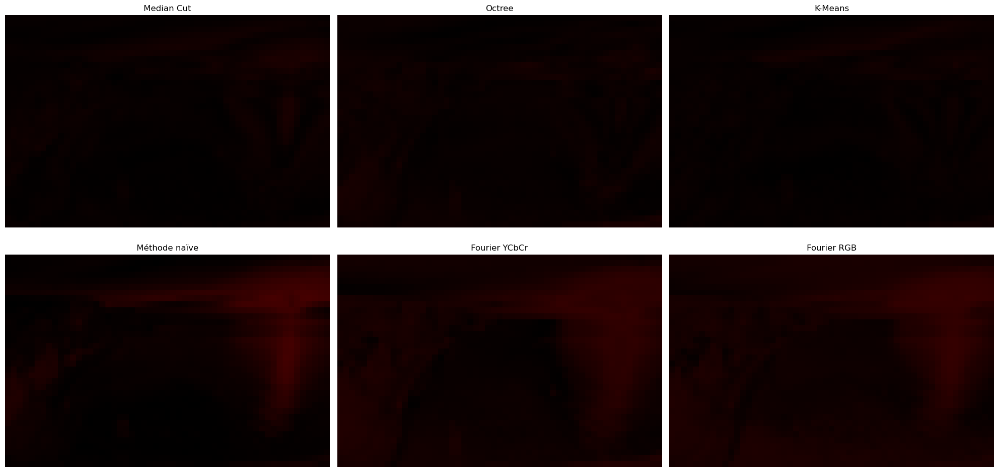

In [84]:


diff_paysage_e2000_median_cut = difference(img_paysage, img_paysage_e2000_median_cut, choix_distance)
diff_paysage_e2000_octree = difference(img_paysage, img_paysage_e2000_octree, choix_distance)
diff_paysage_e2000_k_means = difference(img_paysage, img_paysage_e2000_k_means, choix_distance)

diff_paysage_e2000_methode_naive = difference(img_paysage, img_paysage_e2000_methode_naive, choix_distance)
diff_paysage_e2000_fourier_YCbCr = difference(img_paysage, img_paysage_e2000_fourier_YCbCr, choix_distance)
diff_paysage_e2000_fourier_RGB = difference(img_paysage, img_paysage_e2000_fourier_RGB, choix_distance)

diff_paysage_e2000 = [diff_paysage_e2000_median_cut, diff_paysage_e2000_octree, diff_paysage_e2000_k_means,
          diff_paysage_e2000_methode_naive, diff_paysage_e2000_fourier_YCbCr, diff_paysage_e2000_fourier_RGB]

titles = ["Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 3, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(diff_paysage_e2000)):
    axs[i].imshow(diff_paysage_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

In [85]:
score_synthese(img_paysage, img_paysage_e2000_median_cut, img_paysage_e2000_octree, img_paysage_e2000_k_means, img_paysage_e2000_methode_naive, img_paysage_e2000_fourier_YCbCr, img_paysage_e2000_fourier_RGB, ["Median Cut", "Octree", "Kmeans", "Naive", "YCbCr", "RGB"], delta_e_2000)

------ Median Cut ------
erreur_totale : 65140.37
erreur_moyenne : 8.11
pourcentage_erreur : 8.11
------ Octree ------
erreur_totale : 79675.78
erreur_moyenne : 9.92
pourcentage_erreur : 9.92
------ Kmeans ------
erreur_totale : 59421.05
erreur_moyenne : 7.4
pourcentage_erreur : 7.4
------ Naive ------
erreur_totale : 125363.96
erreur_moyenne : 15.61
pourcentage_erreur : 15.61
------ YCbCr ------
erreur_totale : 166862.36
erreur_moyenne : 20.78
pourcentage_erreur : 20.78
------ RGB ------
erreur_totale : 186913.88
erreur_moyenne : 23.28
pourcentage_erreur : 23.28


A nouveau, l'erreur est minimisée pour K-Means et reste plus faible que pour la distance $\Delta E 76$. Ainsi, cette distance semble réellement un bon compromis entre la minimisation des erreurs au niveau des couleurs retranscrites (quantitativement) et l'aspect visuelle de l'image recoloriée.

De plus, quantitativement, nous cherchions à classer les algorithmes les uns par rapport aux autres. Remarquons que ce classement reste le même peu importe la distance : K-Means est toujours meilleur et les méthodes naïve et de Fourier sont en fin de classement. Ainsi, on pourra s'affranchir dans la suite de la nature de la distance pour établir nos classements. 

## Motif répétitif

Il est également intéressant de s'intéresser à des images à palette restreinte afin de voir quel est l'algorithme qui permet le meilleur constraste et la meilleure définition des formes. En effet, les motifs répétitifs permettent de repérer plus facilement les défauts que l’algorithme pourrait créer, comme des ondulations. Ainsi, comme ces images sont simples et prévisibles, il est plus facile de vérifier si le traitement donne de bons résultats.

Dans cette partie, nous commenterons rapidement les distances euclidienne et $\Delta E 76$ eu égard aux remarques précédentes et nous développerons plus en détail notre analyse avec la distance $\Delta E 2000$.

### Distance euclidienne

<b> Couleur</b>

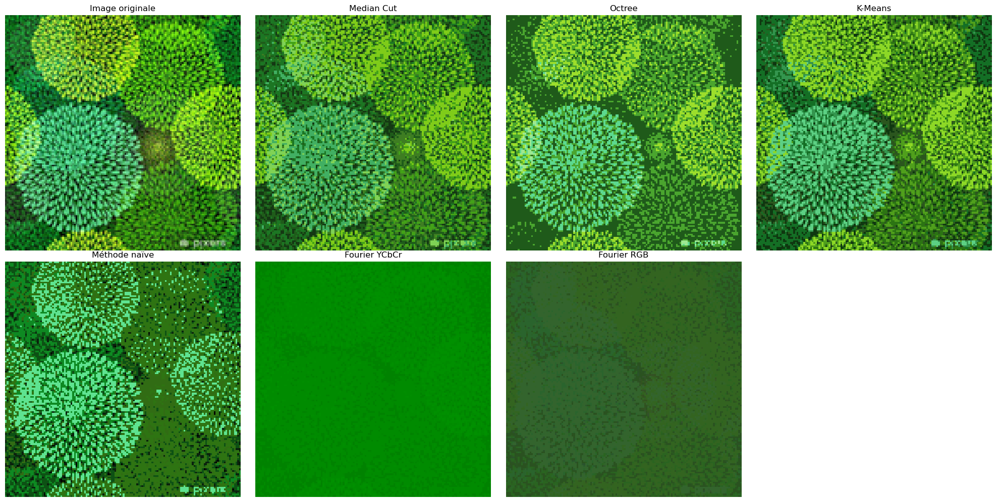

In [86]:
k=8
nb_iter=10
n=math.floor(math.log(k)/math.log(2))
choix_distance = distance_euclid
img_repetitif = Image.open("motif_repetitif.png").convert("RGB")

img_repetitif_euclid_median_cut = recoloriage_MedianCut(img_repetitif, n, choix_distance)
img_repetitif_euclid_octree, pallette_octree = image_octree(img_repetitif, k, choix_distance)
img_repetitif_euclid_k_means = kmeans(img_repetitif, k, nb_iter, choix_distance)

img_repetitif_euclid_methode_naive, palette_naive = methode_naive(img_repetitif, choix_distance,k)
img_repetitif_euclid_fourier_YCbCr, palette_YCbCr = traitement_image_par_mode(img_repetitif, mode="YCbCr", k=k) 
img_repetitif_euclid_fourier_RGB, palette_RGB = traitement_image_par_mode(img_repetitif, mode="RGB", k=k) 

images_repetitif_euclid = [img_repetitif.convert("RGB"), img_repetitif_euclid_median_cut, img_repetitif_euclid_octree, img_repetitif_euclid_k_means,
          img_repetitif_euclid_methode_naive, img_repetitif_euclid_fourier_YCbCr, img_repetitif_euclid_fourier_RGB]

titles = ["Image originale", "Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_repetitif_euclid)):
    axs[i].imshow(images_repetitif_euclid[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

A première vue, c'est K-Means qui restitue l'image le plus fidèlement : les différences avec l'image originale sont plutôt difficiles à repérer.

Quant aux autres algorithmes : Octree restitue les détails du premier plan mais pas de l'arrière plan de l'image originale même si les couleurs sont très fidèles à la version originale tandis qu'à contrario, la méthode naïve ne nous donne qu'une image constituée de 4 couleurs mais dont les formes sont plutot bien restituées, même en arrière plan.
Pour ce type d'images, ce sont les deux algorithmes de Fourier qui sont les moins intéressants : les couleurs ne sont pas fidèles à celles originales et rien ne permet de deviner l'image originale si celle-ci n'est pas fournie. 
Enfin, l'algorithme Median Cut reste très intéressant, presque tout autant que K-Means même si la couleur du rond bleu-vert clair au premier plan à gauche est terne par rapport à celle de l'image originale.

En conclusion, K-Means et Median Cut donnent tous deux des résultats presque parfaits quand l'utilisation de Fourier pour ce type d'images est déconseillée.

<b> Différence</b>

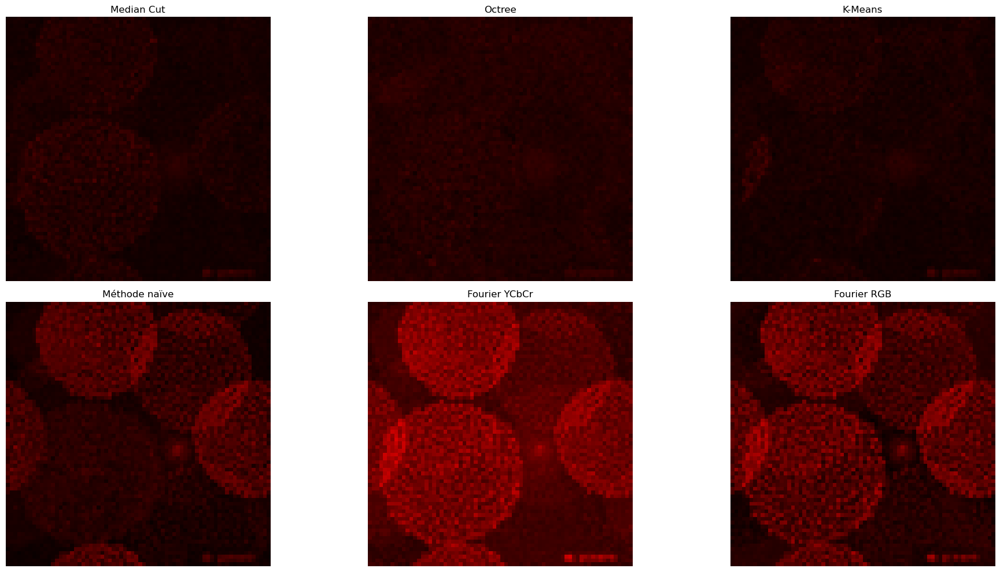

In [87]:


diff_repetitif_euclid_median_cut = difference(img_repetitif, img_repetitif_euclid_median_cut, choix_distance)
diff_repetitif_euclid_octree = difference(img_repetitif, img_repetitif_euclid_octree, choix_distance)
diff_repetitif_euclid_k_means = difference(img_repetitif, img_repetitif_euclid_k_means, choix_distance)

diff_repetitif_euclid_methode_naive = difference(img_repetitif, img_repetitif_euclid_methode_naive, choix_distance)
diff_repetitif_euclid_fourier_YCbCr = difference(img_repetitif, img_repetitif_euclid_fourier_YCbCr, choix_distance)
diff_repetitif_euclid_fourier_RGB = difference(img_repetitif, img_repetitif_euclid_fourier_RGB, choix_distance)

diff_repetitif_euclid = [diff_repetitif_euclid_median_cut, diff_repetitif_euclid_octree, diff_repetitif_euclid_k_means,
          diff_repetitif_euclid_methode_naive, diff_repetitif_euclid_fourier_YCbCr, diff_repetitif_euclid_fourier_RGB]

titles = ["Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 3, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(diff_repetitif_euclid)):
    axs[i].imshow(diff_repetitif_euclid[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

In [88]:
score_synthese(img_repetitif, img_repetitif_euclid_median_cut, img_repetitif_euclid_octree, img_repetitif_euclid_k_means, img_repetitif_euclid_methode_naive, img_repetitif_euclid_fourier_YCbCr, img_repetitif_euclid_fourier_RGB, ["Median Cut", "Octree", "Kmeans", "Naive", "YCbCr", "RGB"], distance_euclid)

------ Median Cut ------
erreur_totale : 547580.26
erreur_moyenne : 27.94
pourcentage_erreur : 6.33
------ Octree ------
erreur_totale : 688811.75
erreur_moyenne : 35.14
pourcentage_erreur : 7.96
------ Kmeans ------
erreur_totale : 497992.78
erreur_moyenne : 25.41
pourcentage_erreur : 5.75
------ Naive ------
erreur_totale : 961737.03
erreur_moyenne : 49.07
pourcentage_erreur : 11.11
------ YCbCr ------
erreur_totale : 1941203.86
erreur_moyenne : 99.04
pourcentage_erreur : 22.42
------ RGB ------
erreur_totale : 1383872.2
erreur_moyenne : 70.61
pourcentage_erreur : 15.99


L'image de différence de Median Cut permet de confirmer notre observation de couleur non optimale pour le rond clair au premier plan car il présente une différence notable avec la couleur de l'image originale.
Octree présente une erreur uniforme et globale sur toute l'image (ce qui est cohérent avce le fait que l'arrière plan ne semble pas bien défini dans l'image recoloriée) tandis que la méthode naïve ne restitue pas les bonnes couleurs mais l'arrière plan est correct.

D'autre part, quantitativement, K-Means suivi de près par Median Cut restent les meilleurs, puis Octree, ensuite la méthode naïve et Fourier. Ce classement quantitatif est le même que le classement quantitatif.

### Distance $\Delta E 76$

<b> Couleur</b>

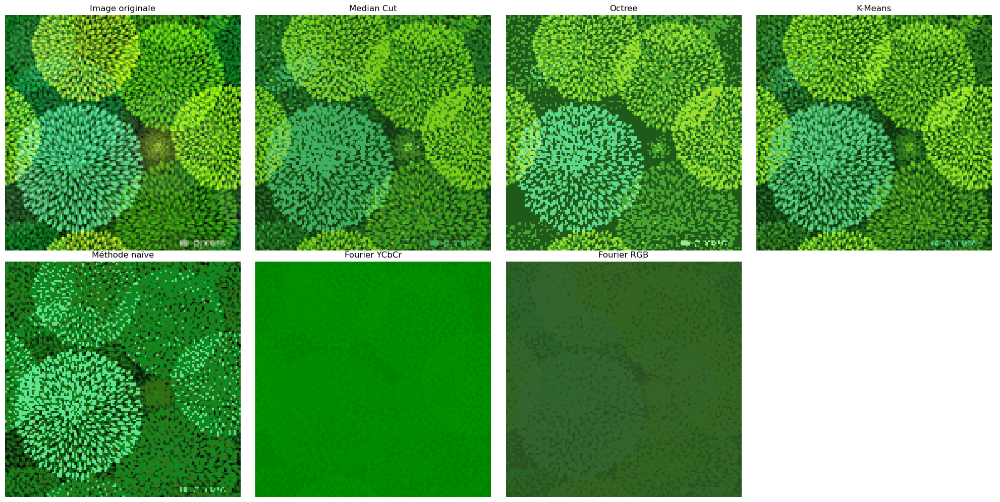

In [89]:
k=8
nb_iter=10
n=math.floor(math.log(k)/math.log(2))
choix_distance = distance_lab
img_repetitif = Image.open("motif_repetitif.png").convert("RGB")

img_repetitif_e76_median_cut = recoloriage_MedianCut(img_repetitif, n, choix_distance)
img_repetitif_e76_octree, pallette_octree = image_octree(img_repetitif, k, choix_distance)
img_repetitif_e76_k_means = kmeans(img_repetitif, k, nb_iter, choix_distance)

img_repetitif_e76_methode_naive, palette_naive = methode_naive(img_repetitif, choix_distance,k)
img_repetitif_e76_fourier_YCbCr, palette_YCbCr = traitement_image_par_mode(img_repetitif, mode="YCbCr", k=k) 
img_repetitif_e76_fourier_RGB, palette_RGB = traitement_image_par_mode(img_repetitif, mode="RGB", k=k) 

images_repetitif_e76 = [img_repetitif.convert("RGB"), img_repetitif_e76_median_cut, img_repetitif_e76_octree, img_repetitif_e76_k_means,
          img_repetitif_e76_methode_naive, img_repetitif_e76_fourier_YCbCr, img_repetitif_e76_fourier_RGB]

titles = ["Image originale", "Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_repetitif_e76)):
    axs[i].imshow(images_repetitif_e76[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

Notre classement qualitatif est le même que le précédent, du meilleur aux moins récommandéx : K-Means, Median Cut, Octree, méthode naïve et les Fouriers.

<b> Différence</b>

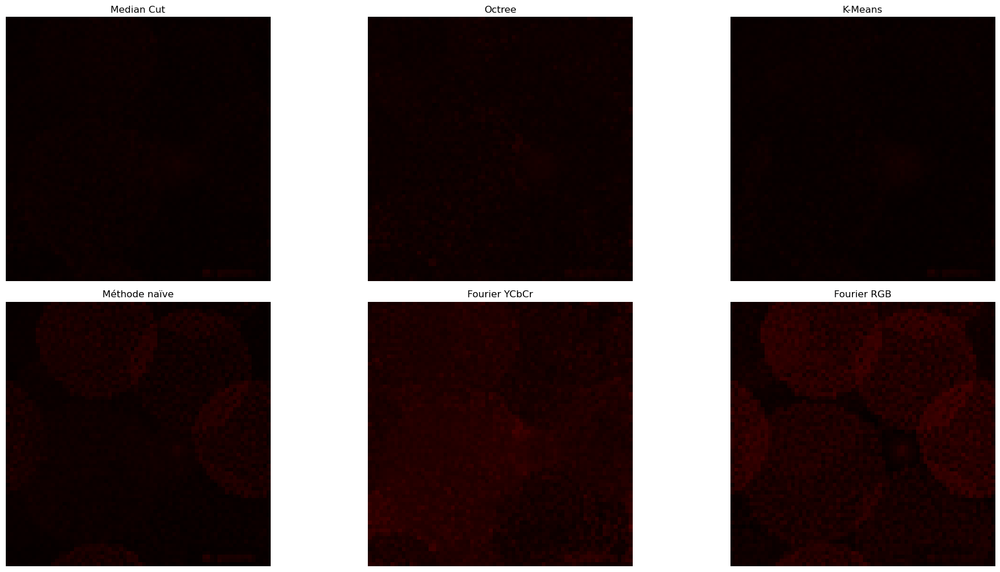

In [90]:


diff_repetitif_e76_median_cut = difference(img_repetitif, img_repetitif_e76_median_cut, choix_distance)
diff_repetitif_e76_octree = difference(img_repetitif, img_repetitif_e76_octree, choix_distance)
diff_repetitif_e76_k_means = difference(img_repetitif, img_repetitif_e76_k_means, choix_distance)

diff_repetitif_e76_methode_naive = difference(img_repetitif, img_repetitif_e76_methode_naive, choix_distance)
diff_repetitif_e76_fourier_YCbCr = difference(img_repetitif, img_repetitif_e76_fourier_YCbCr, choix_distance)
diff_repetitif_e76_fourier_RGB = difference(img_repetitif, img_repetitif_e76_fourier_RGB, choix_distance)

diff_repetitif_e76 = [diff_repetitif_e76_median_cut, diff_repetitif_e76_octree, diff_repetitif_e76_k_means,
          diff_repetitif_e76_methode_naive, diff_repetitif_e76_fourier_YCbCr, diff_repetitif_e76_fourier_RGB]

titles = ["Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 3, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(diff_repetitif_e76)):
    axs[i].imshow(diff_repetitif_e76[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

In [91]:
score_synthese(img_repetitif, img_repetitif_e76_median_cut, img_repetitif_e76_octree, img_repetitif_e76_k_means, img_repetitif_e76_methode_naive, img_repetitif_e76_fourier_YCbCr, img_repetitif_e76_fourier_RGB, ["Median Cut", "Octree", "Kmeans", "Naive", "YCbCr", "RGB"], distance_lab)

------ Median Cut ------
erreur_totale : 195255.44
erreur_moyenne : 9.96
pourcentage_erreur : 9.96
------ Octree ------
erreur_totale : 266578.35
erreur_moyenne : 13.6
pourcentage_erreur : 13.6
------ Kmeans ------
erreur_totale : 177785.9
erreur_moyenne : 9.07
pourcentage_erreur : 9.07
------ Naive ------
erreur_totale : 323172.2
erreur_moyenne : 16.49
pourcentage_erreur : 16.49
------ YCbCr ------
erreur_totale : 583722.52
erreur_moyenne : 29.78
pourcentage_erreur : 29.78
------ RGB ------
erreur_totale : 577031.34
erreur_moyenne : 29.44
pourcentage_erreur : 29.44


Comme dit plus haut, le choix de la distance ne modifie pas le classement donc notre classement quantitatif avec cette distance $\Delta E 76$ est le même que celui avec la distance euclidienne : K-Means, Median Cut, Octree, méthode naïve et les Fouriers.

### Distance $\Delta E 2000$

<b> Couleur</b>

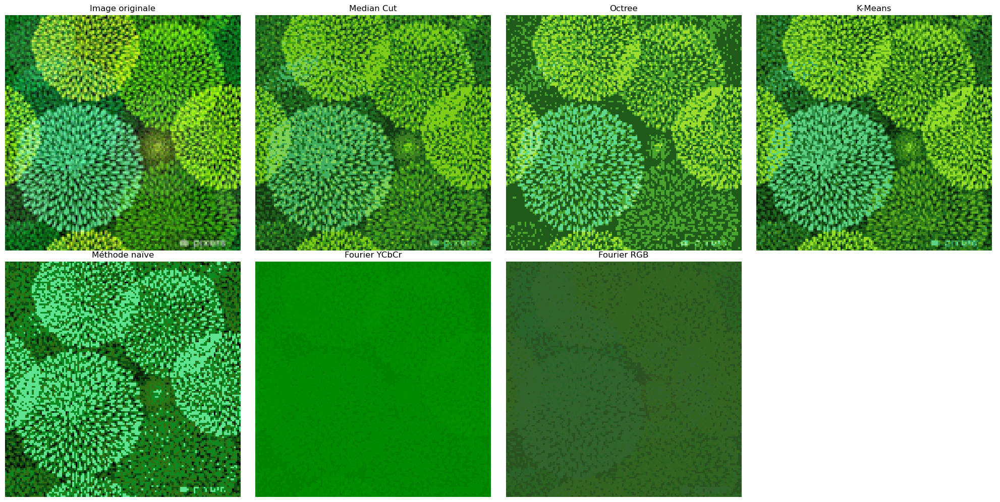

In [92]:
k=8
nb_iter=10
n=math.floor(math.log(k)/math.log(2))
choix_distance = delta_e_2000
img_repetitif = Image.open("motif_repetitif.png").convert("RGB")

img_repetitif_e2000_median_cut = recoloriage_MedianCut(img_repetitif, n, choix_distance)
img_repetitif_e2000_octree, pallette_octree = image_octree(img_repetitif, k, choix_distance)
img_repetitif_e2000_k_means = kmeans(img_repetitif, k, nb_iter, choix_distance)

img_repetitif_e2000_methode_naive, palette_naive = methode_naive(img_repetitif, choix_distance,k)
img_repetitif_e2000_fourier_YCbCr, palette_YCbCr = traitement_image_par_mode(img_repetitif, mode="YCbCr", k=k) 
img_repetitif_e2000_fourier_RGB, palette_RGB = traitement_image_par_mode(img_repetitif, mode="RGB", k=k) 

images_repetitif_e2000 = [img_repetitif.convert("RGB"), img_repetitif_e2000_median_cut, img_repetitif_e2000_octree, img_repetitif_e2000_k_means,
          img_repetitif_e2000_methode_naive, img_repetitif_e2000_fourier_YCbCr, img_repetitif_e2000_fourier_RGB]

titles = ["Image originale", "Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_repetitif_e2000)):
    axs[i].imshow(images_repetitif_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

Avec cette distance, visuellement, Median Cut est beaucoup moins bon que précédemment d'un point de vue colorimétrique quand la différence entre K-Means et l'image originale est quasi-inexistante ; seul un observateur avisé la remarquera.

<b> Différence</b>

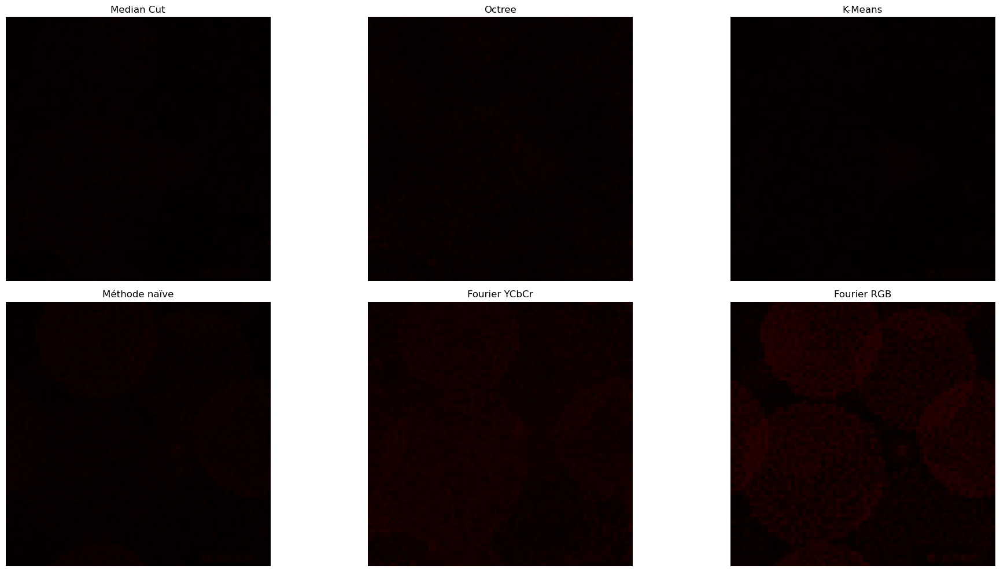

In [93]:


diff_repetitif_e2000_median_cut = difference(img_repetitif, img_repetitif_e2000_median_cut, choix_distance)
diff_repetitif_e2000_octree = difference(img_repetitif, img_repetitif_e2000_octree, choix_distance)
diff_repetitif_e2000_k_means = difference(img_repetitif, img_repetitif_e2000_k_means, choix_distance)

diff_repetitif_e2000_methode_naive = difference(img_repetitif, img_repetitif_e2000_methode_naive, choix_distance)
diff_repetitif_e2000_fourier_YCbCr = difference(img_repetitif, img_repetitif_e2000_fourier_YCbCr, choix_distance)
diff_repetitif_e2000_fourier_RGB = difference(img_repetitif, img_repetitif_e2000_fourier_RGB, choix_distance)

diff_repetitif_e2000 = [diff_repetitif_e2000_median_cut, diff_repetitif_e2000_octree, diff_repetitif_e2000_k_means,
          diff_repetitif_e2000_methode_naive, diff_repetitif_e2000_fourier_YCbCr, diff_repetitif_e2000_fourier_RGB]

titles = ["Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 3, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(diff_repetitif_e2000)):
    axs[i].imshow(diff_repetitif_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

In [94]:
score_synthese(img_repetitif, img_repetitif_e2000_median_cut, img_repetitif_e2000_octree, img_repetitif_e2000_k_means, img_repetitif_e2000_methode_naive, img_repetitif_e2000_fourier_YCbCr, img_repetitif_e2000_fourier_RGB, ["Median Cut", "Octree", "Kmeans", "Naive", "YCbCr", "RGB"], delta_e_2000)

------ Median Cut ------
erreur_totale : 102759.24
erreur_moyenne : 5.24
pourcentage_erreur : 5.24
------ Octree ------
erreur_totale : 144696.77
erreur_moyenne : 7.38
pourcentage_erreur : 7.38
------ Kmeans ------
erreur_totale : 90956.13
erreur_moyenne : 4.64
pourcentage_erreur : 4.64
------ Naive ------
erreur_totale : 158807.26
erreur_moyenne : 8.1
pourcentage_erreur : 8.1
------ YCbCr ------
erreur_totale : 307231.04
erreur_moyenne : 15.68
pourcentage_erreur : 15.68
------ RGB ------
erreur_totale : 371003.41
erreur_moyenne : 18.93
pourcentage_erreur : 18.93


Remarquons que cette distance minimise l'erreur quantitative.

## Festival

### Distance $\Delta E 2000$

<b> Couleur</b>

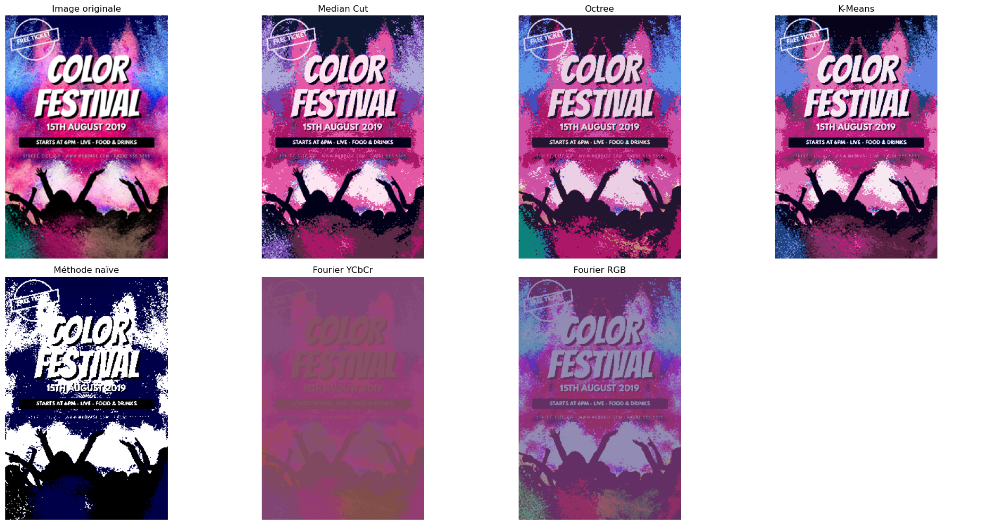

In [95]:
k=8
nb_iter=10
n=math.floor(math.log(k)/math.log(2))
choix_distance = delta_e_2000
img_festival = Image.open("festival.png").convert("RGB")

img_festival_e2000_median_cut = recoloriage_MedianCut(img_festival, n, choix_distance)
img_festival_e2000_octree, pallette_octree = image_octree(img_festival, k, choix_distance)
img_festival_e2000_k_means = kmeans(img_festival, k, nb_iter, choix_distance)

img_festival_e2000_methode_naive, palette_naive = methode_naive(img_festival, choix_distance,k)
img_festival_e2000_fourier_YCbCr, palette_YCbCr = traitement_image_par_mode(img_festival, mode="YCbCr", k=k) 
img_festival_e2000_fourier_RGB, palette_RGB = traitement_image_par_mode(img_festival, mode="RGB", k=k) 

images_festival_e2000 = [img_festival.convert("RGB"), img_festival_e2000_median_cut, img_festival_e2000_octree, img_festival_e2000_k_means,
          img_festival_e2000_methode_naive, img_festival_e2000_fourier_YCbCr, img_festival_e2000_fourier_RGB]

titles = ["Image originale", "Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_festival_e2000)):
    axs[i].imshow(images_festival_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

Tout d'abord, remarquons que tous les algorithmes ont reconstitué une image claire et plus ou moins lisible, à l'exception de Fourier YCbCr, qui n'est cependant pas adpaté pour ce type d'images : les couleurs vives semblent devenir fluorescentes si l'on ne tient pas compte de la présence d'une sorte de voile entre notre oeil et l'image.

La méthode naïve a donné une image plutôt pauvre en couleurs et en détails bien que le prospectus reste suffisamment clair pour transmettre le message souhaité : on comprend encore que c'est un festival qui a lieu en aout 2019 à partir de 18h et qu'on y trouvera de la nourriture et des boissons.
Fourier RGB donne une image de grande qualité bien qu'on ait l'impression d'avoir un filtre entre notre oeil et le prospectus.

Quant aux trois premiers algorithmes, l'image recoloriée est presque parfaite et aurait même pu servir d'image originale ! Notons cependant quelques différences entre eux : le texte "Color Festival" semble un peu plus terne et dans des tons plutôt rosés avec Octree, qui reste cependant le seul algorithme à renvoyer des tâches vertes en bas à gauche de la photo afin d'être fidèle à l'image initiale. Cependant, cet algorithme ayant un temps d'exécution très élevé, en raison de la qualité des autres images, nous préférerons nous tourner vers Median Cut et K-Means.

La différence entre ces deux algorithmes se fait sur les couleurs des nuages colorés en bas et en haut de chaque côté de l'image : K-Means a tendance à uniformiser la couleur de ces nuages quand Median Cut reconstitue vraisemblablement l'explosion de poudre colorée qu'il y a eu. Mais globalement, les deux algorithmes parviennent à reconstituer une image de qualité et qui retranscrit bien la nature de l'événement.

In [96]:
diff_festival_e2000_median_cut = difference(img_repetitif, img_festival_e2000_median_cut, choix_distance)
diff_festival_e2000_octree = difference(img_repetitif, img_festival_e2000_octree, choix_distance)
diff_festival_e2000_k_means = difference(img_repetitif, img_festival_e2000_k_means, choix_distance)

diff_festival_e2000_methode_naive = difference(img_repetitif, img_festival_e2000_methode_naive, choix_distance)
diff_festival_e2000_fourier_YCbCr = difference(img_repetitif, img_festival_e2000_fourier_YCbCr, choix_distance)
diff_festival_e2000_fourier_RGB = difference(img_repetitif, img_festival_e2000_fourier_RGB, choix_distance)

diff_festival_e2000 = [diff_festival_e2000_median_cut, diff_festival_e2000_octree, diff_festival_e2000_k_means,
          diff_festival_e2000_methode_naive, diff_festival_e2000_fourier_YCbCr, diff_festival_e2000_fourier_RGB]

titles = ["Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]

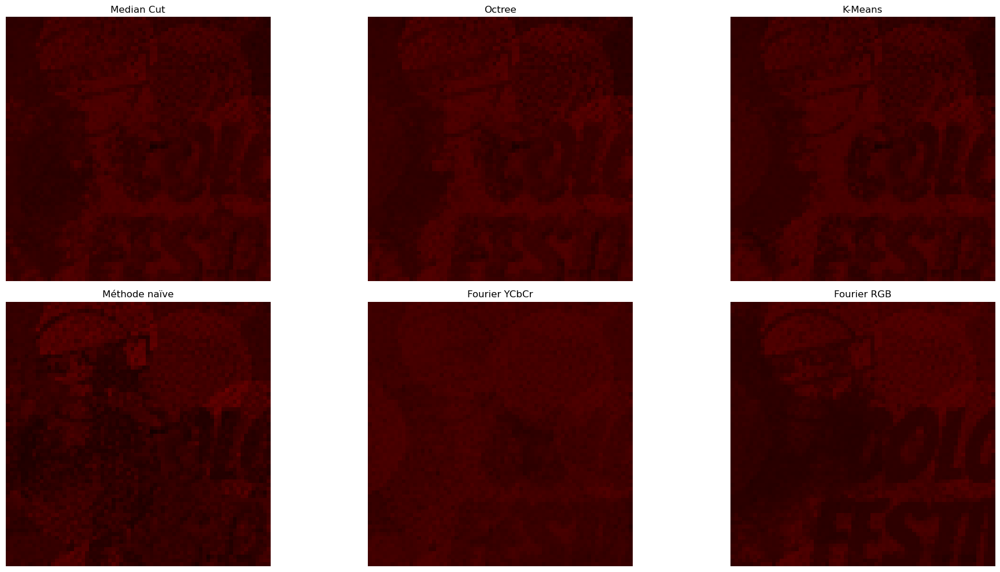

In [97]:
fig, axs = plt.subplots(2, 3, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(diff_festival_e2000)):
    axs[i].imshow(diff_festival_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

In [98]:
score_synthese(img_festival, img_festival_e2000_median_cut, img_festival_e2000_octree, img_festival_e2000_k_means, img_festival_e2000_methode_naive, img_festival_e2000_fourier_YCbCr, img_festival_e2000_fourier_RGB, ["Median Cut", "Octree", "Kmeans", "Naive", "YCbCr", "RGB"], distance_euclid)

------ Median Cut ------
erreur_totale : 3500644.54
erreur_moyenne : 43.8
pourcentage_erreur : 9.92
------ Octree ------
erreur_totale : 3928679.26
erreur_moyenne : 49.15
pourcentage_erreur : 11.13
------ Kmeans ------
erreur_totale : 3242244.05
erreur_moyenne : 40.57
pourcentage_erreur : 9.18
------ Naive ------
erreur_totale : 8702496.16
erreur_moyenne : 108.88
pourcentage_erreur : 24.65
------ YCbCr ------
erreur_totale : 9890472.5
erreur_moyenne : 123.75
pourcentage_erreur : 28.02
------ RGB ------
erreur_totale : 7065169.59
erreur_moyenne : 88.4
pourcentage_erreur : 20.01


Conformément à nos observations, ce sont Median Cut et K-Means qui présentent le moins d'erreurs au niveau du recoloriage, suivis de près par Octree, que nous n'utiliserons pas pour ce genre d'images pour son temps long d'exécution et ses résultats quasi-similaires à d'autres algorithmes.

## Flowers

Suite à l'image verte avec des éclats de couleurs et aux commentaires que nous avions faits sur la retranscription des éléments de premier et de deuxième plan, nous allons dans cette partie utiliser un dessin simplifié, utile pour tester un algorithme car il contient peu de couleurs bien distinctes. Cela permet de repérer facilement les erreurs, comme des changements de couleur non voulus ou des contours flous. Ces images mettent en évidence les défauts de traitement, car la moindre modification visuelle se voit tout de suite. Elles sont idéales pour vérifier si l’algorithme respecte bien les couleurs et les formes d’origine.

Dans cette partie et les suivantes, compte tenu de nos comparaisons précédentes des distances, seuls les tests avec la distance $\Delta E 2000$ seront effectués.

### Distance $\Delta E 2000$

<b> Couleur</b>

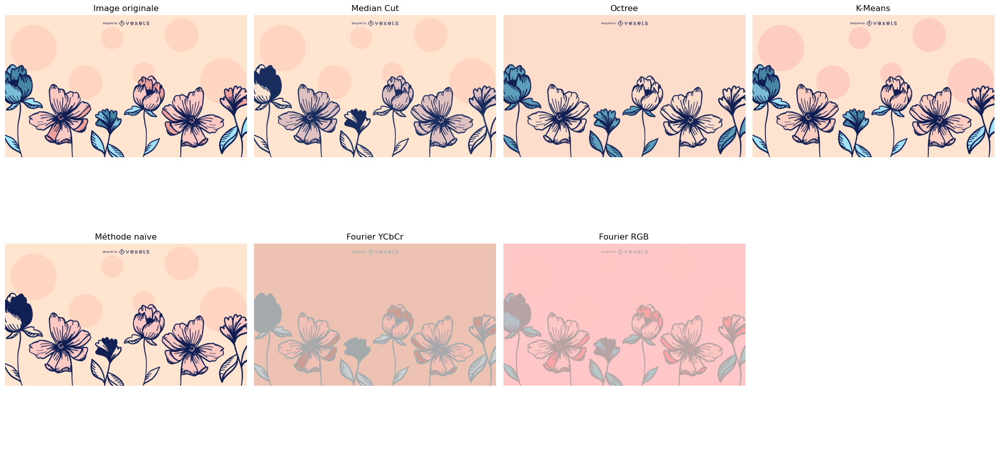

In [99]:
k=8
nb_iter=10
n=math.floor(math.log(k)/math.log(2))
choix_distance = delta_e_2000
img_flowers = Image.open("Flowers.png").convert("RGB")

img_flowers_e2000_median_cut = recoloriage_MedianCut(img_flowers, n, choix_distance)
img_flowers_e2000_octree, pallette_octree = image_octree(img_flowers, k, choix_distance)
img_flowers_e2000_k_means = kmeans(img_flowers, k, nb_iter, choix_distance)

img_flowers_e2000_methode_naive, palette_naive = methode_naive(img_flowers, choix_distance,k)
img_flowers_e2000_fourier_YCbCr, palette_YCbCr = traitement_image_par_mode(img_flowers, mode="YCbCr", k=k) 
img_flowers_e2000_fourier_RGB, palette_RGB = traitement_image_par_mode(img_flowers, mode="RGB", k=k) 

images_flowers_e2000 = [img_flowers.convert("RGB"), img_flowers_e2000_median_cut, img_flowers_e2000_octree, img_flowers_e2000_k_means,
          img_flowers_e2000_methode_naive, img_flowers_e2000_fourier_YCbCr, img_flowers_e2000_fourier_RGB]

titles = ["Image originale", "Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_flowers_e2000)):
    axs[i].imshow(images_flowers_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

Visuellement, tous les algorithmes semblent correctement restituer les contours nets de l'image (bordure des fleurs).

La différence se joue alors sur la retranscription des couleurs. Tout comme dans le motif répétitif (pétales vertes), Octree ne parvient pas à retranscrire les éléments circulaires en arrière-plan qui ne sont pas délimités par un contour bien précis et dont la couleur est similaire à la couleur de fond de l'image.

Median Cut retranscrit fidèlement quant à lui les formes principales de l'image mais les couleurs des fleurs sont ternes et pâles. De la même manière, la méthode naïve retranscrit mal les couleurs : la couleur bleue a été complètement ommise car moins prépondérante dans l'image originale.

Malgré le filtre appliqué par Fourier sur l'image, les différentes couleurs sont bien présentes (surtout avec Fourier RGB), mais la qualité globale de l'image n'est pas satisfaisante.

Enfin, seul un oeil très attentif remarquera que les couleurs de K-Means sont très légèrement différentes de celles de l'image originale. Cette différence étant très minime et l'image étant quasi-parfaitement reconstituée, K-Means a réussi le défi haut la main ! Mais en fonction du rendu souhiaté pour ce type d'images, tous les algorithmes pourraient convenir !

<b> Différence</b>

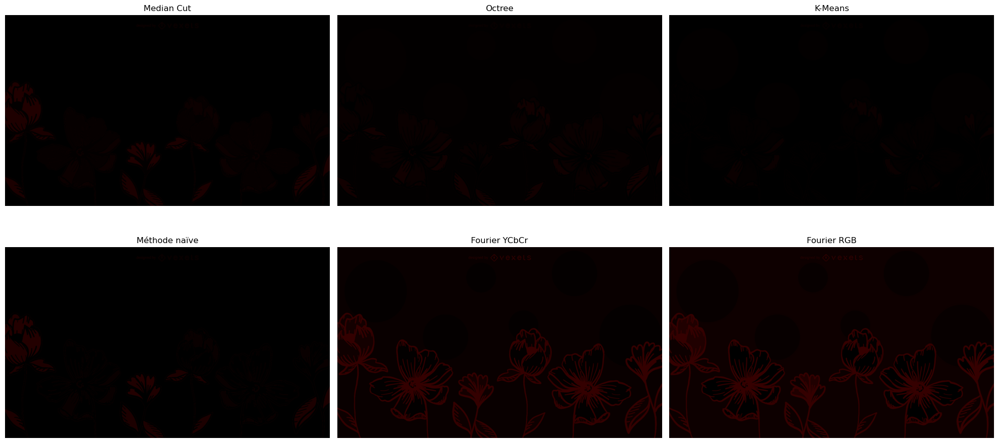

In [100]:


diff_flowers_e2000_median_cut = difference(img_flowers, img_flowers_e2000_median_cut, choix_distance)
diff_flowers_e2000_octree = difference(img_flowers, img_flowers_e2000_octree, choix_distance)
diff_flowers_e2000_k_means = difference(img_flowers, img_flowers_e2000_k_means, choix_distance)

diff_flowers_e2000_methode_naive = difference(img_flowers, img_flowers_e2000_methode_naive, choix_distance)
diff_flowers_e2000_fourier_YCbCr = difference(img_flowers, img_flowers_e2000_fourier_YCbCr, choix_distance)
diff_flowers_e2000_fourier_RGB = difference(img_flowers, img_flowers_e2000_fourier_RGB, choix_distance)

diff_flowers_e2000 = [diff_flowers_e2000_median_cut, diff_flowers_e2000_octree, diff_flowers_e2000_k_means,
          diff_flowers_e2000_methode_naive, diff_flowers_e2000_fourier_YCbCr, diff_flowers_e2000_fourier_RGB]

titles = ["Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 3, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(diff_flowers_e2000)):
    axs[i].imshow(diff_flowers_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

In [101]:
score_synthese(img_flowers, img_flowers_e2000_median_cut, img_flowers_e2000_octree, img_flowers_e2000_k_means, img_flowers_e2000_methode_naive, img_flowers_e2000_fourier_YCbCr, img_flowers_e2000_fourier_RGB, ["Median Cut", "Octree", "Kmeans", "Naive", "YCbCr", "RGB"], delta_e_2000)

------ Median Cut ------
erreur_totale : 3592395.95
erreur_moyenne : 2.72
pourcentage_erreur : 2.72
------ Octree ------
erreur_totale : 5127391.99
erreur_moyenne : 3.88
pourcentage_erreur : 3.88
------ Kmeans ------
erreur_totale : 2249500.89
erreur_moyenne : 1.7
pourcentage_erreur : 1.7
------ Naive ------
erreur_totale : 2596610.87
erreur_moyenne : 1.96
pourcentage_erreur : 1.96
------ YCbCr ------
erreur_totale : 17730987.63
erreur_moyenne : 13.4
pourcentage_erreur : 13.4
------ RGB ------
erreur_totale : 21935133.03
erreur_moyenne : 16.58
pourcentage_erreur : 16.58


Remarquons que les deux Fourier ont du mal à retranscrire les contours : les couleurs semblent davantage "fondues" entre elles.
En excluant Fourier, pour ce type d'images, les erreurs sont toutes très faibles, ce qui montrent qu'avec une palette de 8 couleurs uniquement et nos algorithmes, le résultat obtenu est très satisfaisant !

## Robots

Les images avec des couleurs ternes ou très saturées, et un flou en arrière-plan, sont utiles pour tester comment un algorithme gère les nuances subtiles et la profondeur de champ. Elles permettent de voir si les traitements conservent bien les dégradés doux sans introduire de bruit ou de coupures. Le flou en arrière-plan aide aussi à évaluer si l’algorithme respecte la séparation entre les zones nettes et floues, ce qui est important pour des applications comme la mise au point automatique, la segmentation ou le floutage d’arrière-plan.

### Distance $\Delta E 2000$

<b> Couleurs</b>

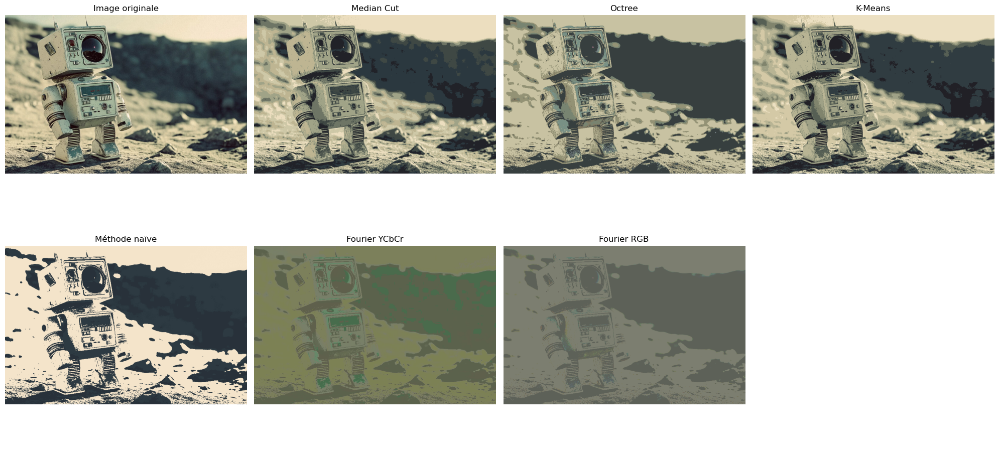

In [102]:
k=8
nb_iter=10
n=math.floor(math.log(k)/math.log(2))
choix_distance = delta_e_2000
img_robots = Image.open("robot.jpg").convert("RGB")

img_robots_e2000_median_cut = recoloriage_MedianCut(img_robots, n, choix_distance)
img_robots_e2000_octree, pallette_octree = image_octree(img_robots, k, choix_distance)
img_robots_e2000_k_means = kmeans(img_robots, k, nb_iter, choix_distance)

img_robots_e2000_methode_naive, palette_naive = methode_naive(img_robots, choix_distance,k)
img_robots_e2000_fourier_YCbCr, palette_YCbCr = traitement_image_par_mode(img_robots, mode="YCbCr", k=k) 
img_robots_e2000_fourier_RGB, palette_RGB = traitement_image_par_mode(img_robots, mode="RGB", k=k) 

images_robots_e2000 = [img_robots.convert("RGB"), img_robots_e2000_median_cut, img_robots_e2000_octree, img_robots_e2000_k_means,
          img_robots_e2000_methode_naive, img_robots_e2000_fourier_YCbCr, img_robots_e2000_fourier_RGB]

titles = ["Image originale", "Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_robots_e2000)):
    axs[i].imshow(images_robots_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

Remarquons tout d'abord que, qualitativement, tous les algorithmes reconstruisent une image de qualité : la scène peut être identifiée correctement à chaque fois. Comme avec les images précédentes, les couleurs rendus par Fourier ne sont pas très fidèles à celles contenues dans l'image originale. 

La méthode naïve reconstruit quant à elle une image de type "argentique", ce qui peut être un rendu recherché et apprécié.

Comme observé avec les images précédentes étudiées, Octree reconstruit très bien le robot, objet présent au premier plan (en tenant également compte des ombres) mais tend à uniformiser l'arrière-plan.

Median Cut et K-Means donnent un résultat très similaire : l'image orginale peut presque être confondue avec les images recoloriées. Si l'objectif est de se rapprocher davantage de l'image initiale, ils semblent être tout à fait adaptés !



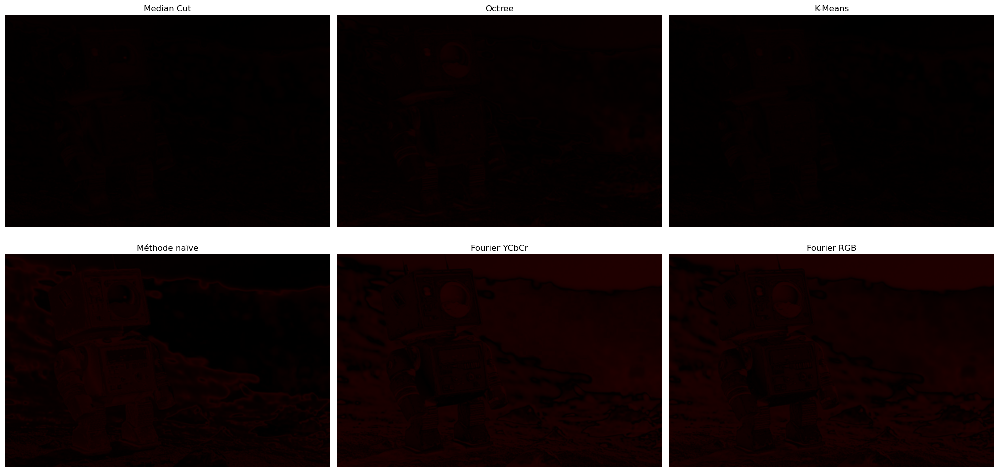

In [103]:
diff_robots_e2000_median_cut = difference(img_robots, img_robots_e2000_median_cut, choix_distance)
diff_robots_e2000_octree = difference(img_robots, img_robots_e2000_octree, choix_distance)
diff_robots_e2000_k_means = difference(img_robots, img_robots_e2000_k_means, choix_distance)

diff_robots_e2000_methode_naive = difference(img_robots, img_robots_e2000_methode_naive, choix_distance)
diff_robots_e2000_fourier_YCbCr = difference(img_robots, img_robots_e2000_fourier_YCbCr, choix_distance)
diff_robots_e2000_fourier_RGB = difference(img_robots, img_robots_e2000_fourier_RGB, choix_distance)

diff_robots_e2000 = [diff_robots_e2000_median_cut, diff_robots_e2000_octree, diff_robots_e2000_k_means,
          diff_robots_e2000_methode_naive, diff_robots_e2000_fourier_YCbCr, diff_robots_e2000_fourier_RGB]

titles = ["Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 3, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(diff_robots_e2000)):
    axs[i].imshow(diff_robots_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

In [104]:
score_synthese(img_robots, img_robots_e2000_median_cut, img_robots_e2000_octree, img_robots_e2000_k_means, img_robots_e2000_methode_naive, img_robots_e2000_fourier_YCbCr, img_robots_e2000_fourier_RGB, ["Median Cut", "Octree", "Kmeans", "Naive", "YCbCr", "RGB"], delta_e_2000)

------ Median Cut ------
erreur_totale : 1791745.99
erreur_moyenne : 4.27
pourcentage_erreur : 4.27
------ Octree ------
erreur_totale : 2827239.42
erreur_moyenne : 6.73
pourcentage_erreur : 6.73
------ Kmeans ------
erreur_totale : 1770123.29
erreur_moyenne : 4.21
pourcentage_erreur : 4.21
------ Naive ------
erreur_totale : 4587743.04
erreur_moyenne : 10.92
pourcentage_erreur : 10.92
------ YCbCr ------
erreur_totale : 7968298.33
erreur_moyenne : 18.97
pourcentage_erreur : 18.97
------ RGB ------
erreur_totale : 7558520.16
erreur_moyenne : 18.0
pourcentage_erreur : 18.0


Aucune différence notable n'est observable ici : les erreurs ne sont pas très importantes visuellement !
On retrouve un meilleur résultat avec K-Means et Median Cut, ce qui est cohérent avec ce que l'on observe qualitativement.

Finalement, lorsque les couleurs sont plutôt ternes et restent dans la même gamme de couleurs, l'oeil humain ne parvient pas à détecter les différences pour certains algorithmes comme K-Means et Median Cut par exemple ; ce qui fait d'eux un choix privilégié pour ce type d'images.

## Texture fine

Étudier des textures fines permet de tester si un algorithme d’image peut bien repérer et conserver les petits détails. Ces textures, comme celles des fibres d'un bois, sont difficiles à analyser car elles changent vite avec la lumière ou le bruit. Elles aident donc à vérifier si l’algorithme est précis et résistant. C’est un bon moyen de voir s’il fait bien la différence entre des zones qui se ressemblent.

### Distance $\Delta E 2000$

<b> Couleur</b>

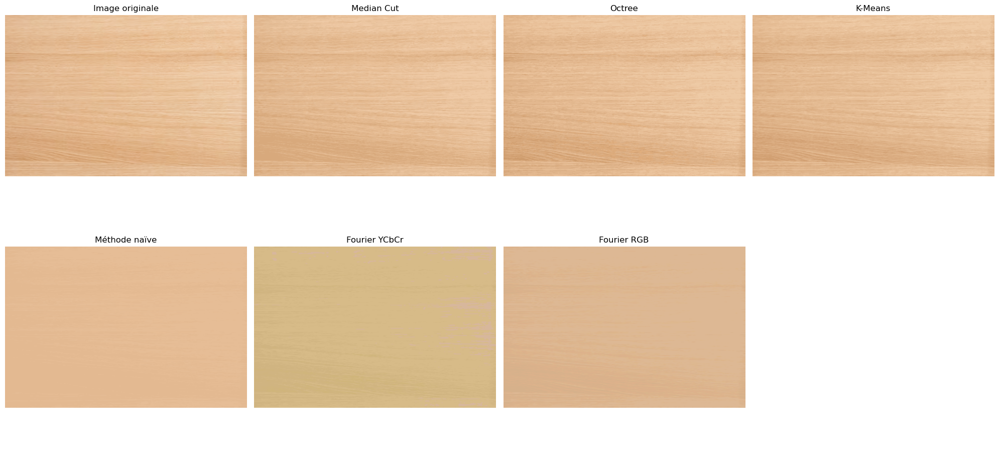

In [105]:
k=8
nb_iter=10
n=math.floor(math.log(k)/math.log(2))
choix_distance = delta_e_2000
img_texture_fine = Image.open("texture_fine.png").convert("RGB")

img_texture_fine_e2000_median_cut = recoloriage_MedianCut(img_texture_fine, n, choix_distance)
img_texture_fine_e2000_octree, pallette_octree = image_octree(img_texture_fine, k, choix_distance)
img_texture_fine_e2000_k_means = kmeans(img_texture_fine, k, nb_iter, choix_distance)

img_texture_fine_e2000_methode_naive, palette_naive = methode_naive(img_texture_fine, choix_distance,k)
img_texture_fine_e2000_fourier_YCbCr, palette_YCbCr = traitement_image_par_mode(img_texture_fine, mode="YCbCr", k=k) 
img_texture_fine_e2000_fourier_RGB, palette_RGB = traitement_image_par_mode(img_texture_fine, mode="RGB", k=k) 

images_texture_fine_e2000 = [img_texture_fine.convert("RGB"), img_texture_fine_e2000_median_cut, img_texture_fine_e2000_octree, img_texture_fine_e2000_k_means,
          img_texture_fine_e2000_methode_naive, img_texture_fine_e2000_fourier_YCbCr, img_texture_fine_e2000_fourier_RGB]

titles = ["Image originale", "Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_texture_fine_e2000)):
    axs[i].imshow(images_texture_fine_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

La méthode naïve et Fourier ne retranscrivent pas bien les détails du bois bien qu'il n'y ait qu'un nombre très faible de couleurs présentes dans l'image originale.

Remarquons cependant qu'en bas à gauche de l'image, c'est Octree qui parvient à reconstruire au mieux les rainures du bois, tout en distinguant dans l'image entière les différents tons de l'image.
Vient ensuite K-Means qui restitue une image de très haute qualité quand Median Cut, cette fois-ci à tendance à lisser les couleurs, notamment dans la partie basse de l'image.

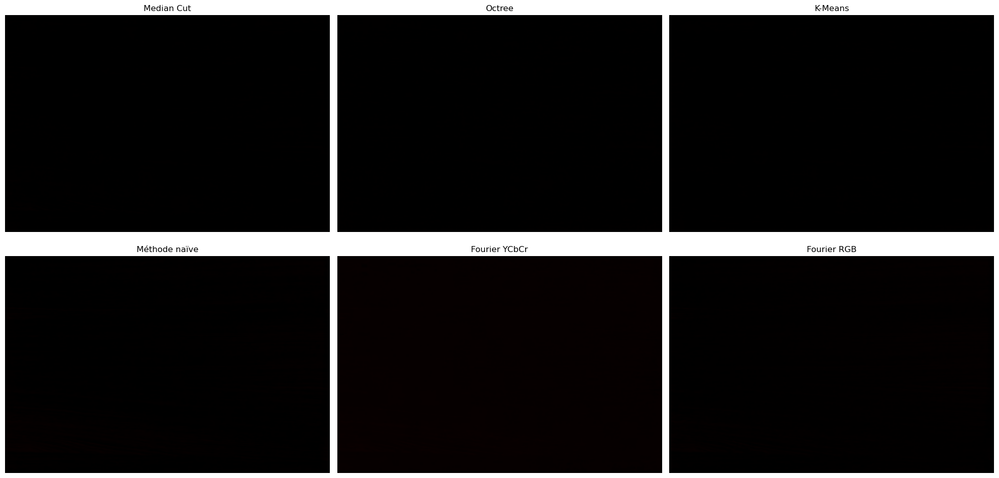

In [106]:
diff_img_texture_fine_e2000_median_cut = difference(img_texture_fine, img_texture_fine_e2000_median_cut, choix_distance)
diff_img_texture_fine_e2000_octree = difference(img_texture_fine, img_texture_fine_e2000_octree, choix_distance)
diff_img_texture_fine_e2000_k_means = difference(img_texture_fine, img_texture_fine_e2000_k_means, choix_distance)

diff_img_texture_fine_e2000_methode_naive = difference(img_texture_fine, img_texture_fine_e2000_methode_naive, choix_distance)
diff_img_texture_fine_e2000_fourier_YCbCr = difference(img_texture_fine, img_texture_fine_e2000_fourier_YCbCr, choix_distance)
diff_img_texture_fine_e2000_fourier_RGB = difference(img_texture_fine, img_texture_fine_e2000_fourier_RGB, choix_distance)

diff_img_texture_fine_e2000 = [diff_img_texture_fine_e2000_median_cut, diff_img_texture_fine_e2000_octree, diff_img_texture_fine_e2000_k_means,
          diff_img_texture_fine_e2000_methode_naive, diff_img_texture_fine_e2000_fourier_YCbCr, diff_img_texture_fine_e2000_fourier_RGB]

titles = ["Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 3, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(diff_img_texture_fine_e2000)):
    axs[i].imshow(diff_img_texture_fine_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

In [107]:
score_synthese(img_texture_fine, img_texture_fine_e2000_median_cut, img_texture_fine_e2000_octree, img_texture_fine_e2000_k_means, img_texture_fine_e2000_methode_naive, img_texture_fine_e2000_fourier_YCbCr, img_texture_fine_e2000_fourier_RGB, ["Median Cut", "Octree", "Kmeans", "Naive", "YCbCr", "RGB"], delta_e_2000)

------ Median Cut ------
erreur_totale : 220772.97
erreur_moyenne : 0.84
pourcentage_erreur : 0.84
------ Octree ------
erreur_totale : 248558.19
erreur_moyenne : 0.95
pourcentage_erreur : 0.95
------ Kmeans ------
erreur_totale : 216047.1
erreur_moyenne : 0.83
pourcentage_erreur : 0.83
------ Naive ------
erreur_totale : 504794.12
erreur_moyenne : 1.93
pourcentage_erreur : 1.93
------ YCbCr ------
erreur_totale : 1743295.86
erreur_moyenne : 6.66
pourcentage_erreur : 6.66
------ RGB ------
erreur_totale : 656391.36
erreur_moyenne : 2.51
pourcentage_erreur : 2.51


L'erreur n'est pas un paramètre très indicatif ici car il semblerait que la méthode naïve ait une erreur très faible bien que l'image recoloriée soit quasiment uniforme (à la limite, Fourier YCbCr est meilleur dans le sens que les rainures du bois sont bien distingués et qu'il nous permet de reconnaître le motif initial.

Pour de textures très fines et des images présentant des détails fins, Octree est le grand vainqueur !

## Architecture


### Distance $\Delta E 2000$

<b> Couleur</b>

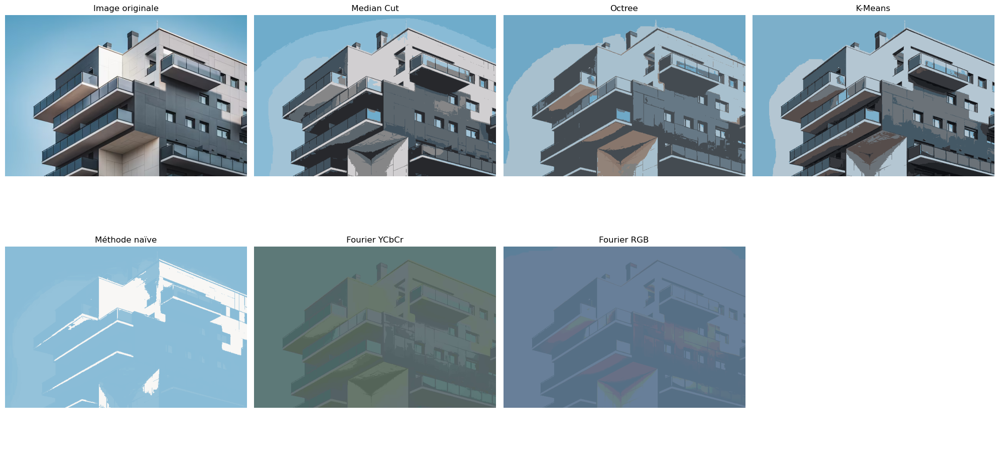

In [108]:
k=8
nb_iter=10
n=math.floor(math.log(k)/math.log(2))
choix_distance = delta_e_2000
img_architecture = Image.open("architecture.png").convert("RGB")

img_architecture_e2000_median_cut = recoloriage_MedianCut(img_architecture, n, choix_distance)
img_architecture_e2000_octree, pallette_octree = image_octree(img_architecture, k, choix_distance)
img_architecture_e2000_k_means = kmeans(img_architecture, k, nb_iter, choix_distance)

img_architecture_e2000_methode_naive, palette_naive = methode_naive(img_architecture, choix_distance,k)
img_architecture_e2000_fourier_YCbCr, palette_YCbCr = traitement_image_par_mode(img_architecture, mode="YCbCr", k=k) 
img_architecture_e2000_fourier_RGB, palette_RGB = traitement_image_par_mode(img_architecture, mode="RGB", k=k) 

images_architecture_e2000 = [img_architecture.convert("RGB"), img_architecture_e2000_median_cut, img_architecture_e2000_octree, img_architecture_e2000_k_means,
          img_architecture_e2000_methode_naive, img_architecture_e2000_fourier_YCbCr, img_architecture_e2000_fourier_RGB]

titles = ["Image originale", "Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_architecture_e2000)):
    axs[i].imshow(images_architecture_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

On remarque que la méthode naive ne permet pas de reconstituer l'image fidèlement. Les images recoloriées avec Fourier YCbCr et Fourier RGB restituent correctement les formes de l'image (les détails fins sont plus détaillés avec Fourier RGB) mais ces deux algorithmes font disparaitre les nuances de couleurs.

Les algorithmes Median Cut, Octree et K-Means proposent une image fidèle et avec des couleurs proches de l'image originale. Cependant, la palette de couleur proposée par Octree est plus terne que celle proposée par Median Cut et K-Means.

Les nuances du ciel sont présentes avec l'image produit avec Median Cut mais absentes pour les autres. Le verre présent sur l'image originale est également mieux reproduit sur l'image provenant de Median Cut.

<b> Différence</b>

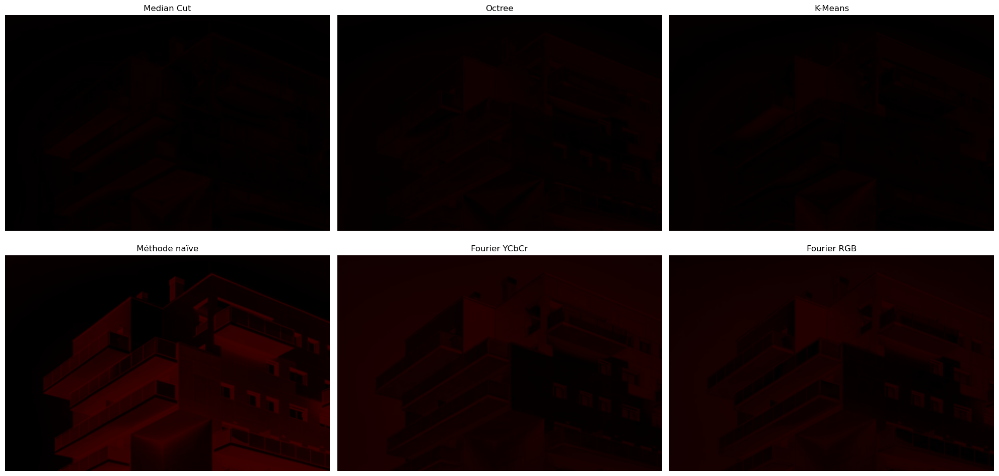

In [109]:
diff_architecture_e2000_median_cut = difference(img_architecture, img_architecture_e2000_median_cut, choix_distance)
diff_architecture_e2000_octree = difference(img_architecture, img_architecture_e2000_octree, choix_distance)
diff_architecture_e2000_k_means = difference(img_architecture, img_architecture_e2000_k_means, choix_distance)

diff_architecture_e2000_methode_naive = difference(img_architecture, img_architecture_e2000_methode_naive, choix_distance)
diff_architecture_e2000_fourier_YCbCr = difference(img_architecture, img_architecture_e2000_fourier_YCbCr, choix_distance)
diff_architecture_e2000_fourier_RGB = difference(img_architecture, img_architecture_e2000_fourier_RGB, choix_distance)

diff_img_architecture_e2000 = [diff_architecture_e2000_median_cut, diff_architecture_e2000_octree, diff_architecture_e2000_k_means,
          diff_architecture_e2000_methode_naive, diff_architecture_e2000_fourier_YCbCr, diff_architecture_e2000_fourier_RGB]

titles = ["Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 3, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(diff_img_architecture_e2000)):
    axs[i].imshow(diff_img_architecture_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

In [110]:
score_synthese(img_architecture, img_architecture_e2000_median_cut, img_architecture_e2000_octree, img_architecture_e2000_k_means, img_architecture_e2000_methode_naive, img_architecture_e2000_fourier_YCbCr, img_architecture_e2000_fourier_RGB, ["Median Cut", "Octree", "Kmeans", "Naive", "YCbCr", "RGB"], delta_e_2000)

------ Median Cut ------
erreur_totale : 1178251.25
erreur_moyenne : 4.51
pourcentage_erreur : 4.51
------ Octree ------
erreur_totale : 1866531.3
erreur_moyenne : 7.15
pourcentage_erreur : 7.15
------ Kmeans ------
erreur_totale : 1442262.08
erreur_moyenne : 5.53
pourcentage_erreur : 5.53
------ Naive ------
erreur_totale : 5517185.2
erreur_moyenne : 21.14
pourcentage_erreur : 21.14
------ YCbCr ------
erreur_totale : 5042189.18
erreur_moyenne : 19.32
pourcentage_erreur : 19.32
------ RGB ------
erreur_totale : 4685642.32
erreur_moyenne : 17.95
pourcentage_erreur : 17.95


Les scores des algorithmes corroborent nos observations : Median Cut, K-Means et Octree sont les algorithmes fournissant une image la plus fidèle alors que les méthodes naive, Fourier YCbCr et Fourier RGB en sont plus éloignées.

En somme, la méthode naive est une méthode à proscrire pour ce type d'image, compte tenu des critères qualitatif et quantitatif. Les algorithmes Median Cut et Octree, quant à eux, se distinguent par une reconstitution fidèle de l'image.

## Homme

### Distance $\Delta E 2000$

<b> Couleur</b>

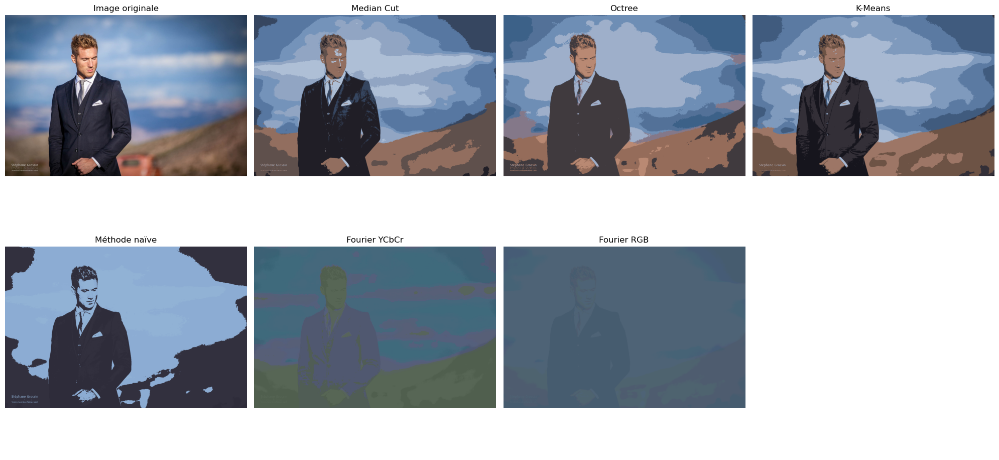

In [111]:
k=8
nb_iter=10
n=math.floor(math.log(k)/math.log(2))
choix_distance = delta_e_2000
img_homme = Image.open("homme.jpg").convert("RGB")

img_homme_e2000_median_cut = recoloriage_MedianCut(img_homme, n, choix_distance)
img_homme_e2000_octree, pallette_octree = image_octree(img_homme, k, choix_distance)
img_homme_e2000_k_means = kmeans(img_homme, k, nb_iter, choix_distance)

img_homme_e2000_methode_naive, palette_naive = methode_naive(img_homme, choix_distance,k)
img_homme_e2000_fourier_YCbCr, palette_YCbCr = traitement_image_par_mode(img_homme, mode="YCbCr", k=k) 
img_homme_e2000_fourier_RGB, palette_RGB = traitement_image_par_mode(img_homme, mode="RGB", k=k) 

images_homme_e2000 = [img_homme.convert("RGB"), img_homme_e2000_median_cut, img_homme_e2000_octree, img_homme_e2000_k_means,
          img_homme_e2000_methode_naive, img_homme_e2000_fourier_YCbCr, img_homme_e2000_fourier_RGB]

titles = ["Image originale", "Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_homme_e2000)):
    axs[i].imshow(images_homme_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

Remarquons tout d'abord que la méthode naive propose une image facilement reconnaissable (on voit clairement un homme en costume) dans un style assez différent, proche du noir et blanc ou de l'argentique. Bien qu'assez éloigné eu égard aux couleurs, il s'agit d'un résultat qui peut être recherché dans certaines circonstances.

A nouveau, les algorithmes de Fourier YCbCr et Fourier RGB proposent une palette terne mais les formes générales sont restituées (surtout pour Fourier YCbCr).

L'algorithme Median Cut propose une reconstitution proche de l'image originale mais une perte d'information engendrant une perte de véracité de l'image (il y a des trous dans la tête).

Enfin, les algorithmes Octree et K-Means proposent les deux images les plus fidèles à l'image originale. On remarque cependant que celle propoée par Octree a davantage lissé les formes du costume mais a apporté plus de détails et de couleurs au visage de l'homme. A contrario, l'image proposée par K-Means contient plus de détails de formes au niveau du costume mais propose un visage plus terne.

<b> Différence</b>

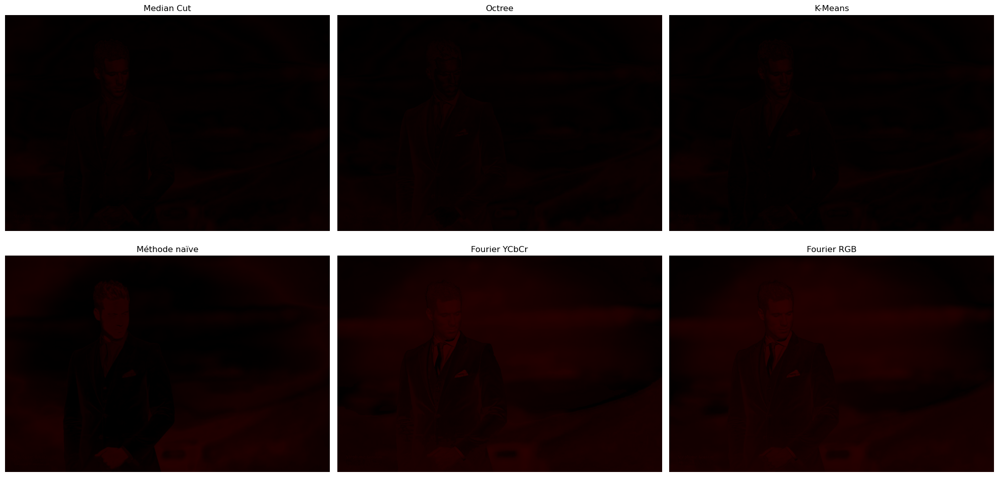

In [112]:
diff_homme_e2000_median_cut = difference(img_homme, img_homme_e2000_median_cut, choix_distance)
diff_homme_e2000_octree = difference(img_homme, img_homme_e2000_octree, choix_distance)
diff_homme_e2000_k_means = difference(img_homme, img_homme_e2000_k_means, choix_distance)

diff_homme_e2000_methode_naive = difference(img_homme, img_homme_e2000_methode_naive, choix_distance)
diff_homme_e2000_fourier_YCbCr = difference(img_homme, img_homme_e2000_fourier_YCbCr, choix_distance)
diff_homme_e2000_fourier_RGB = difference(img_homme, img_homme_e2000_fourier_RGB, choix_distance)

diff_img_homme_e2000 = [diff_homme_e2000_median_cut, diff_homme_e2000_octree, diff_homme_e2000_k_means,
          diff_homme_e2000_methode_naive, diff_homme_e2000_fourier_YCbCr, diff_homme_e2000_fourier_RGB]

titles = ["Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 3, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(diff_img_homme_e2000)):
    axs[i].imshow(diff_img_homme_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

In [113]:
score_synthese(img_homme, img_homme_e2000_median_cut, img_homme_e2000_octree, img_homme_e2000_k_means, img_homme_e2000_methode_naive, img_homme_e2000_fourier_YCbCr, img_homme_e2000_fourier_RGB, ["Median Cut", "Octree", "Kmeans", "Naive", "YCbCr", "RGB"], delta_e_2000)

------ Median Cut ------
erreur_totale : 9820182.63
erreur_moyenne : 5.76
pourcentage_erreur : 5.76
------ Octree ------
erreur_totale : 11654630.49
erreur_moyenne : 6.83
pourcentage_erreur : 6.83
------ Kmeans ------
erreur_totale : 9041595.39
erreur_moyenne : 5.3
pourcentage_erreur : 5.3
------ Naive ------
erreur_totale : 22086127.09
erreur_moyenne : 12.95
pourcentage_erreur : 12.95
------ YCbCr ------
erreur_totale : 35002663.13
erreur_moyenne : 20.52
pourcentage_erreur : 20.52
------ RGB ------
erreur_totale : 35845507.38
erreur_moyenne : 21.02
pourcentage_erreur : 21.02


Les valeurs des scores confirment que les méthodes naive, de Fourier YCbCr et de Fourier RGB ne proposent pas une image reconstruite fidèle à l'originale.

On remarque que le score de Median Cut est plus faible que celui d'Octree, contrastant avec les observations. Cela s'explique par une différence plus faible en moyenne mais en des zones de l'image qui sont plus importantes pour transmettre l'information (le visage notamment).

Enfin, on remarque bien que K-Means a une erreur plus faible que Octree comme nous avions pu l'observer.

## Flou Gaussien


Le flou gaussien est couramment utilisé pour réduire le bruit dans une image avant l'application d'autres traitements, comme la détection de contours (par exemple avec l’algorithme de Canny), la segmentation ou le seuillage.

On se propose donc d'appliquer ce flou gaussien avant d'appliquer à nouveau les algorithmes sur l'image de l'homme.

<b> Réalisation du flou gaussien</b>

On affiche le résultat avec le flou gaussien $3 \times 3$ et $7 \times 7$.

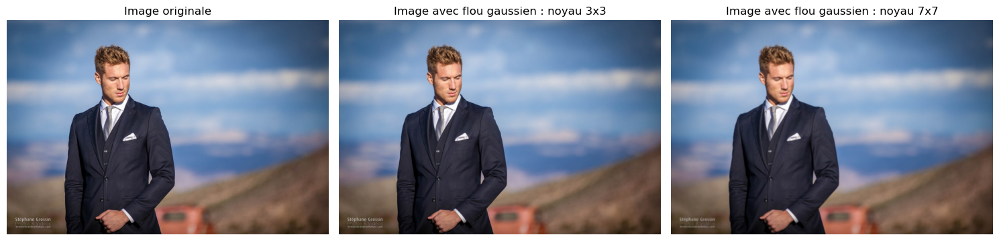

In [114]:
# On ouvre l'image de test
image_homme = Image.open("homme.jpg").convert("RGB")
# On applique le flou gaussien
image_homme_flou_gaussien = convolution(image_homme, gauss3)
image_homme_flou_gaussien_2 = convolution(image_homme, gauss7)

# Affichage
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(image_homme)
axs[0].set_title("Image originale")
axs[0].axis('off')

axs[1].imshow(image_homme_flou_gaussien)
axs[1].set_title("Image avec flou gaussien : noyau 3x3")
axs[1].axis('off')

axs[2].imshow(image_homme_flou_gaussien_2)
axs[2].set_title("Image avec flou gaussien : noyau 7x7")
axs[2].axis('off')

plt.tight_layout()
plt.show()

<b> Couleur</b>

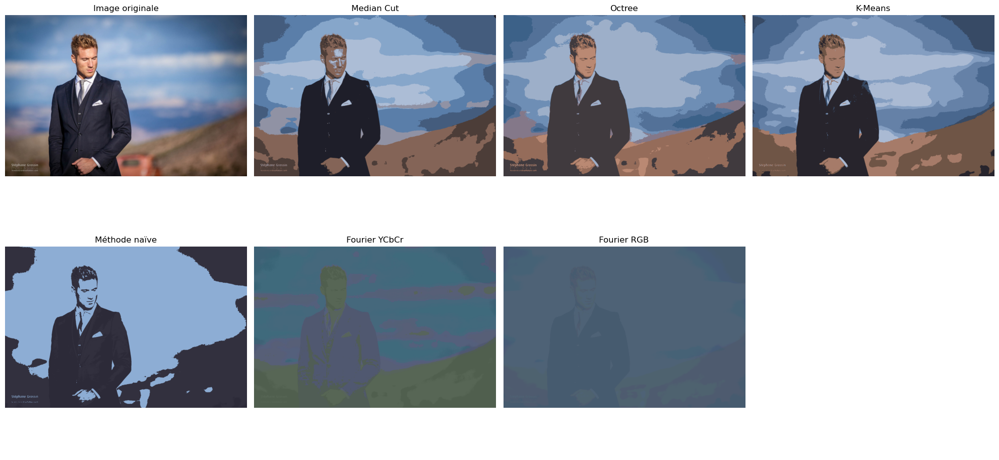

In [115]:
k=8
nb_iter=10
n=math.floor(math.log(k)/math.log(2))
choix_distance = delta_e_2000

image_homme_flou_gaussien_e2000_median_cut = recoloriage_MedianCut(image_homme_flou_gaussien, n, choix_distance)
image_homme_flou_gaussien_e2000_octree, pallette_octree = image_octree(image_homme_flou_gaussien, k, choix_distance)
image_homme_flou_gaussien_e2000_k_means = kmeans(image_homme_flou_gaussien, k, nb_iter, choix_distance)

image_homme_flou_gaussien_e2000_methode_naive, palette_naive = methode_naive(image_homme_flou_gaussien, choix_distance,k)
image_homme_flou_gaussien_e2000_fourier_YCbCr, palette_YCbCr = traitement_image_par_mode(image_homme_flou_gaussien, mode="YCbCr", k=k) 
image_homme_flou_gaussien_e2000_fourier_RGB, palette_RGB = traitement_image_par_mode(image_homme_flou_gaussien, mode="RGB", k=k) 

images_homme_flou_gaussien_e2000 = [image_homme_flou_gaussien.convert("RGB"), image_homme_flou_gaussien_e2000_median_cut, image_homme_flou_gaussien_e2000_octree, image_homme_flou_gaussien_e2000_k_means,
          image_homme_flou_gaussien_e2000_methode_naive, image_homme_flou_gaussien_e2000_fourier_YCbCr, image_homme_flou_gaussien_e2000_fourier_RGB]

titles = ["Image originale", "Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_homme_flou_gaussien_e2000)):
    axs[i].imshow(images_homme_flou_gaussien_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

On remarque des images similaires à celles réalisées avant l'application du flou gaussien.

Cependant, les erreurs au niveau du visage produites par l'algorithme Median Cut sont plus nombreuses et certaines sont apparues lors de l'application de la méthode K-Means.

Ainsi, si on souhaite une image réaliste (sans défaut majeur au visage par exemple), l'image produite par Octree est la plus fidèle.

<b> Différence </b>

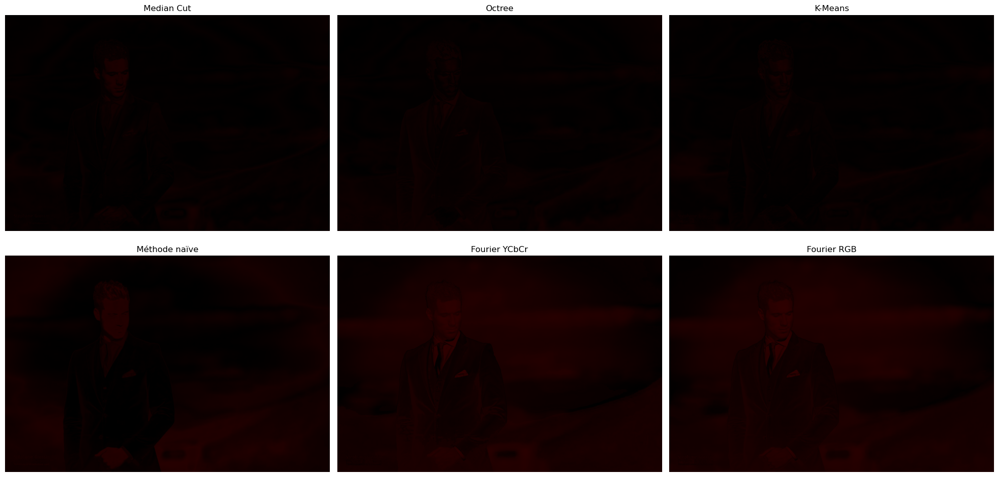

In [116]:
diff_homme_flou_gaussien_e2000_median_cut = difference(image_homme_flou_gaussien, image_homme_flou_gaussien_e2000_median_cut, choix_distance)
diff_homme_flou_gaussien_e2000_octree = difference(image_homme_flou_gaussien, image_homme_flou_gaussien_e2000_octree, choix_distance)
diff_homme_flou_gaussien_e2000_k_means = difference(image_homme_flou_gaussien, image_homme_flou_gaussien_e2000_k_means, choix_distance)

diff_homme_flou_gaussien_e2000_methode_naive = difference(image_homme_flou_gaussien, image_homme_flou_gaussien_e2000_methode_naive, choix_distance)
diff_homme_flou_gaussien_e2000_fourier_YCbCr = difference(image_homme_flou_gaussien, image_homme_flou_gaussien_e2000_fourier_YCbCr, choix_distance)
diff_homme_flou_gaussien_e2000_fourier_RGB = difference(image_homme_flou_gaussien, image_homme_flou_gaussien_e2000_fourier_RGB, choix_distance)

diff_img_homme_flou_gaussien_e2000 = [diff_homme_flou_gaussien_e2000_median_cut, diff_homme_flou_gaussien_e2000_octree, diff_homme_flou_gaussien_e2000_k_means,
          diff_homme_flou_gaussien_e2000_methode_naive, diff_homme_flou_gaussien_e2000_fourier_YCbCr, diff_homme_flou_gaussien_e2000_fourier_RGB]

titles = ["Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 3, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(diff_img_homme_flou_gaussien_e2000)):
    axs[i].imshow(diff_img_homme_flou_gaussien_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

In [117]:
score_synthese(image_homme, image_homme_flou_gaussien_e2000_median_cut, image_homme_flou_gaussien_e2000_octree, image_homme_flou_gaussien_e2000_k_means, image_homme_flou_gaussien_e2000_methode_naive, image_homme_flou_gaussien_e2000_fourier_YCbCr, image_homme_flou_gaussien_e2000_fourier_RGB, ["Median Cut", "Octree", "Kmeans", "Naive", "YCbCr", "RGB"], delta_e_2000)

------ Median Cut ------
erreur_totale : 9282781.73
erreur_moyenne : 5.44
pourcentage_erreur : 5.44
------ Octree ------
erreur_totale : 11636250.26
erreur_moyenne : 6.82
pourcentage_erreur : 6.82
------ Kmeans ------
erreur_totale : 9059031.14
erreur_moyenne : 5.31
pourcentage_erreur : 5.31
------ Naive ------
erreur_totale : 22413550.8
erreur_moyenne : 13.14
pourcentage_erreur : 13.14
------ YCbCr ------
erreur_totale : 35043002.94
erreur_moyenne : 20.55
pourcentage_erreur : 20.55
------ RGB ------
erreur_totale : 35718132.86
erreur_moyenne : 20.94
pourcentage_erreur : 20.94


On remarque que les scores sont légèrement plus faibles après l'application du flou gaussien (5.44 contre 5.76 pour le Median Cut, 5.14 contre 5.26 pour le Kmeans).

Le score d'Octree est cependant presque inchangé (6.82 au lieu de 6.83).

On applique maintenant nos algorithmes sur l'image issue du flou gaussien $7 \times 7$.

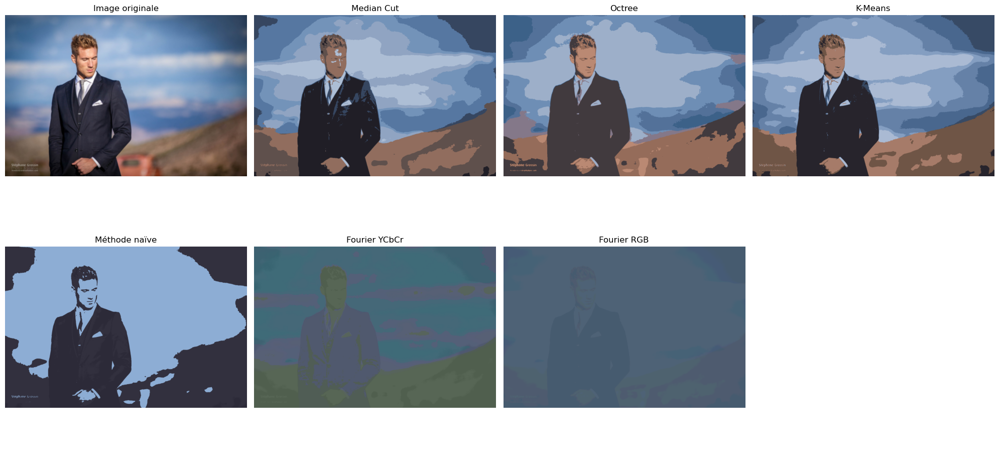

In [118]:
k=8
nb_iter=10
n=math.floor(math.log(k)/math.log(2))
choix_distance = delta_e_2000

image_homme_flou_gaussien_2_e2000_median_cut = recoloriage_MedianCut(image_homme_flou_gaussien_2, n, choix_distance)
image_homme_flou_gaussien_2_e2000_octree, pallette_octree = image_octree(image_homme_flou_gaussien_2, k, choix_distance)
image_homme_flou_gaussien_2_e2000_k_means = kmeans(image_homme_flou_gaussien_2, k, nb_iter, choix_distance)

image_homme_flou_gaussien_2_e2000_methode_naive, palette_naive = methode_naive(image_homme_flou_gaussien_2, choix_distance,k)
image_homme_flou_gaussien_2_e2000_fourier_YCbCr, palette_YCbCr = traitement_image_par_mode(image_homme_flou_gaussien_2, mode="YCbCr", k=k) 
image_homme_flou_gaussien_2_e2000_fourier_RGB, palette_RGB = traitement_image_par_mode(image_homme_flou_gaussien_2, mode="RGB", k=k) 

images_homme_flou_gaussien_2_e2000 = [image_homme_flou_gaussien_2.convert("RGB"), image_homme_flou_gaussien_2_e2000_median_cut, image_homme_flou_gaussien_2_e2000_octree, image_homme_flou_gaussien_e2000_k_means,
          image_homme_flou_gaussien_2_e2000_methode_naive, image_homme_flou_gaussien_2_e2000_fourier_YCbCr, image_homme_flou_gaussien_2_e2000_fourier_RGB]

titles = ["Image originale", "Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_homme_flou_gaussien_2_e2000)):
    axs[i].imshow(images_homme_flou_gaussien_2_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

Qualitativement, les résultats sont assez proches du premier flou gaussien $3 \times 3$ mais on observe une détérioriation de l'image produite avec l'algorithme Median Cut (la veste de costume devient transparente).

<b> Différence</b>

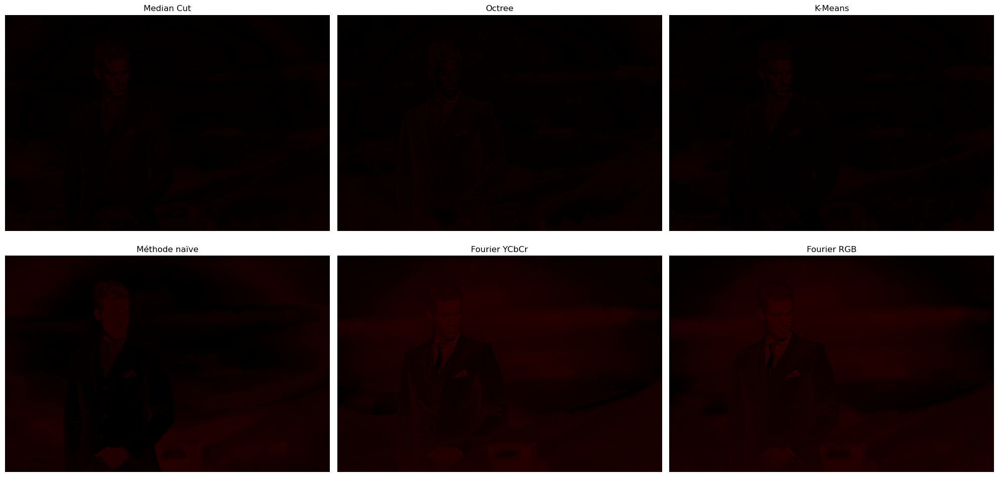

In [119]:
diff_homme_flou_gaussien_2_e2000_median_cut = difference(image_homme_flou_gaussien, image_homme_flou_gaussien_2_e2000_median_cut, choix_distance)
diff_homme_flou_gaussien_2_e2000_octree = difference(image_homme_flou_gaussien, image_homme_flou_gaussien_2_e2000_octree, choix_distance)
diff_homme_flou_gaussien_2_e2000_k_means = difference(image_homme_flou_gaussien, image_homme_flou_gaussien_2_e2000_k_means, choix_distance)

diff_homme_flou_gaussien_2_e2000_methode_naive = difference(image_homme_flou_gaussien, image_homme_flou_gaussien_2_e2000_methode_naive, choix_distance)
diff_homme_flou_gaussien_2_e2000_fourier_YCbCr = difference(image_homme_flou_gaussien, image_homme_flou_gaussien_2_e2000_fourier_YCbCr, choix_distance)
diff_homme_flou_gaussien_2_e2000_fourier_RGB = difference(image_homme_flou_gaussien, image_homme_flou_gaussien_2_e2000_fourier_RGB, choix_distance)

diff_img_homme_flou_gaussien_2_e2000 = [diff_homme_flou_gaussien_2_e2000_median_cut, diff_homme_flou_gaussien_2_e2000_octree, diff_homme_flou_gaussien_2_e2000_k_means,
          diff_homme_flou_gaussien_2_e2000_methode_naive, diff_homme_flou_gaussien_2_e2000_fourier_YCbCr, diff_homme_flou_gaussien_2_e2000_fourier_RGB]

titles = ["Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier RGB"]


fig, axs = plt.subplots(2, 3, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(diff_img_homme_flou_gaussien_2_e2000)):
    axs[i].imshow(diff_img_homme_flou_gaussien_2_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

In [120]:
score_synthese(image_homme, image_homme_flou_gaussien_2_e2000_median_cut, image_homme_flou_gaussien_2_e2000_octree, image_homme_flou_gaussien_2_e2000_k_means, image_homme_flou_gaussien_2_e2000_methode_naive, image_homme_flou_gaussien_2_e2000_fourier_YCbCr, image_homme_flou_gaussien_2_e2000_fourier_RGB, ["Median Cut", "Octree", "Kmeans", "Naive", "YCbCr", "RGB"], delta_e_2000)

------ Median Cut ------
erreur_totale : 9906948.99
erreur_moyenne : 5.81
pourcentage_erreur : 5.81
------ Octree ------
erreur_totale : 11712885.8
erreur_moyenne : 6.87
pourcentage_erreur : 6.87
------ Kmeans ------
erreur_totale : 9057647.48
erreur_moyenne : 5.31
pourcentage_erreur : 5.31
------ Naive ------
erreur_totale : 22451962.69
erreur_moyenne : 13.16
pourcentage_erreur : 13.16
------ YCbCr ------
erreur_totale : 36051489.55
erreur_moyenne : 21.14
pourcentage_erreur : 21.14
------ RGB ------
erreur_totale : 35718034.81
erreur_moyenne : 20.94
pourcentage_erreur : 20.94


La dégradation observée pour l'algorithme Median Cut est retrouvée dans le score qui passe de $5.44$ à $5.81$.

En tendance, les scores d'erreur sont plus importants que ceux trouvés avec le flou gaussien $3 \times 3$. Cela provient du floutage plus important que précédemment, qui augmente naturellement l'erreur.

## Filtre de Sobel

Le filtre de Sobel permet de détecter les contours d'une image. Que deviennent les résultats de nos algorithmes appliqués aux contours d'une image ? Cette réponse nous permettra de déterminer les algorithmes les plus adaptés aux images avec beaucoup ou peu de contours.

<b> Application du filtre</b>

On commence par appliquer notre filtre à l'image d'architecture, présentant de nombreux contours.

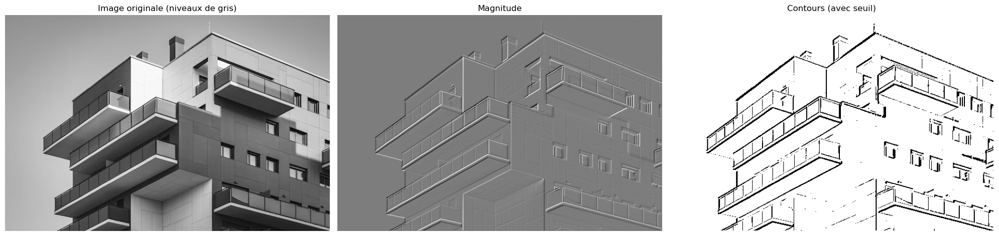

In [121]:
img_sobel_architecture = Image.open("architecture.png")
gx_sobel_architecture = convolution_sobel(img_sobel_architecture, sobelx3)
gy_sobel_architecture = convolution_sobel(img_sobel_architecture, sobely3)
mag_sobel_architecture = magnitude_gradient(gx_sobel_architecture, gy_sobel_architecture)
mag_sobel_architecture_thresh = seuillage(mag_sobel_architecture, seuil=142) # Attention à ne pas choisir un seuil trop élevé ni trop faible


fig, axs = plt.subplots(1, 3, figsize=(20, 5))

images_sobel_architecture = [img_sobel_architecture.convert("L"), mag_sobel_architecture, mag_sobel_architecture_thresh]
titles_sobel_architecture = ["Image originale (niveaux de gris)", "Magnitude", "Contours (avec seuil)"]

for ax, im, title in zip(axs, images_sobel_architecture, titles_sobel_architecture):
    ax.imshow(im, cmap='gray')
    ax.set_title(title)
    ax.axis("off")

plt.tight_layout()
plt.show()

<b> Couleur</b>

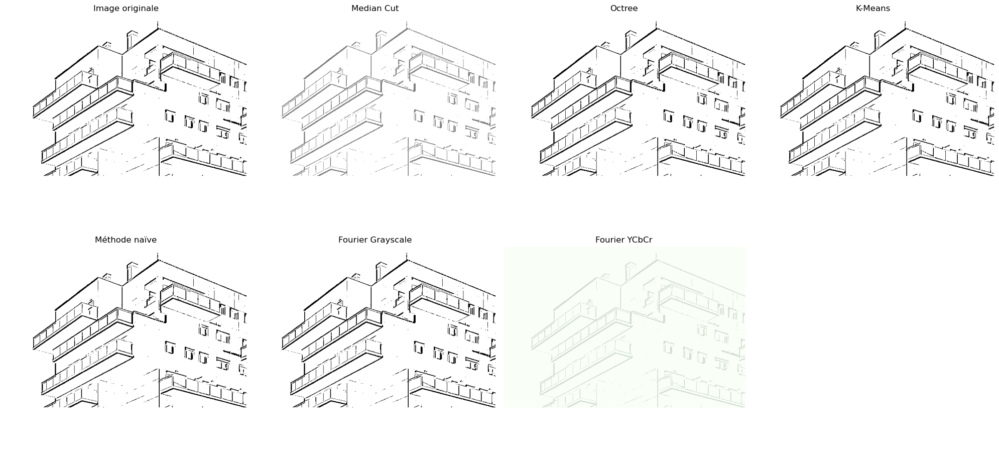

In [122]:
k=8
nb_iter=10
n=math.floor(math.log(k)/math.log(2))
choix_distance = delta_e_2000

img_architecture_sobel_e2000_median_cut = recoloriage_MedianCut(mag_sobel_architecture_thresh.convert("RGB"), n, choix_distance)
img_architecture_sobel_e2000_octree, pallette_octree = image_octree(mag_sobel_architecture_thresh.convert("RGB"), k, choix_distance)
img_architecture_sobel_e2000_k_means = kmeans(mag_sobel_architecture_thresh.convert("RGB"), k, nb_iter, choix_distance)

img_architecture_sobel_e2000_methode_naive, palette_naive = methode_naive(mag_sobel_architecture_thresh.convert("RGB"), choix_distance,k)
img_architecture_sobel_e2000_fourier_grayscale, palette_YCbCr = traitement_image_par_mode(mag_sobel_architecture_thresh, mode="grayscale", k=k) 
img_architecture_sobel_e2000_fourier_YCbCr, palette_RGB = traitement_image_par_mode(mag_sobel_architecture_thresh.convert("RGB"), mode="YCbCr", k=k) 

images_architecture_sobel_e2000 = [mag_sobel_architecture_thresh, img_architecture_sobel_e2000_median_cut, img_architecture_sobel_e2000_octree, img_architecture_sobel_e2000_k_means,
          img_architecture_sobel_e2000_methode_naive, img_architecture_sobel_e2000_fourier_grayscale, img_architecture_sobel_e2000_fourier_YCbCr]

titles = ["Image originale", "Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier Grayscale", "Fourier YCbCr"]


fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(images_architecture_sobel_e2000)):
    axs[i].imshow(images_architecture_sobel_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

Qualitativement, on ne constate aucune différence entre les contours de l'image originale et les images produites avec les algorithmes Octree, K-Means, Méthode naive et Fourier Grayscale alors que l'image proposée par l'algorithme Median Cut est moins contrastée et que celle avec Fourier YCbCr est encore plus terne.

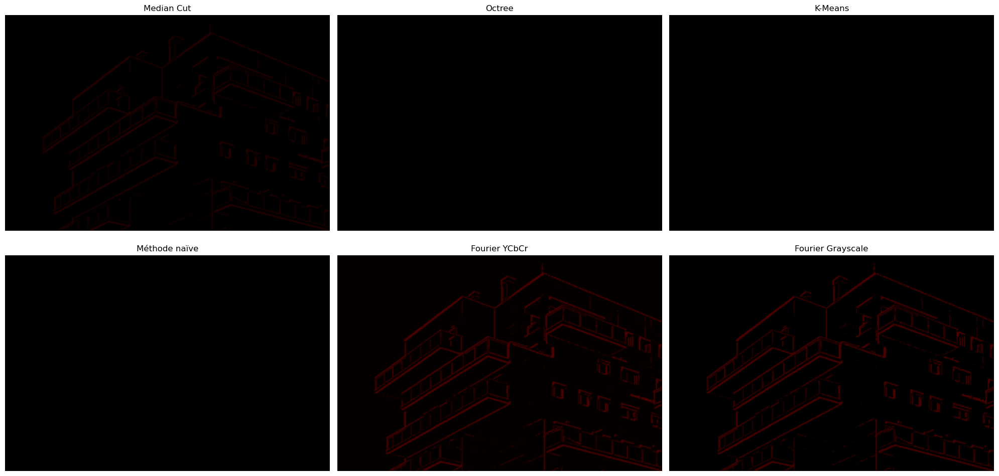

In [123]:
diff_architecture_sobel_e2000_median_cut = difference(mag_sobel_architecture_thresh.convert("RGB"), img_architecture_sobel_e2000_median_cut, choix_distance)
diff_architecture_sobel_e2000_octree = difference(mag_sobel_architecture_thresh.convert("RGB"), img_architecture_sobel_e2000_octree, choix_distance)
diff_architecture_sobel_e2000_k_means = difference(mag_sobel_architecture_thresh.convert("RGB"), img_architecture_sobel_e2000_k_means, choix_distance)

diff_architecture_sobel_e2000_methode_naive = difference(mag_sobel_architecture_thresh.convert("RGB"), img_architecture_sobel_e2000_methode_naive, choix_distance)
diff_architecture_sobel_e2000_fourier_YCbCr = difference(mag_sobel_architecture_thresh.convert("RGB"), img_architecture_sobel_e2000_fourier_YCbCr, choix_distance)
diff_architecture_sobel_e2000_fourier_grayscale = difference(mag_sobel_architecture_thresh.convert("RGB"), img_architecture_sobel_e2000_fourier_grayscale.convert("RGB"), choix_distance)

diff_architecture_sobel_e2000 = [diff_architecture_sobel_e2000_median_cut, diff_architecture_sobel_e2000_octree, diff_architecture_sobel_e2000_k_means,
          diff_architecture_sobel_e2000_methode_naive, diff_architecture_sobel_e2000_fourier_YCbCr, diff_architecture_sobel_e2000_fourier_grayscale]

titles = ["Median Cut", "Octree", "K-Means",
          "Méthode naïve", "Fourier YCbCr", "Fourier Grayscale"]


fig, axs = plt.subplots(2, 3, figsize=(20, 10)) 


axs = axs.flatten()


for i in range(len(diff_architecture_sobel_e2000)):
    axs[i].imshow(diff_architecture_sobel_e2000[i], cmap='gray')
    axs[i].set_title(titles[i])
    axs[i].axis('off')

axs[-1].axis('off')

plt.tight_layout()
plt.show()

In [124]:
score_synthese(mag_sobel_architecture_thresh.convert("RGB"), img_architecture_sobel_e2000_median_cut.convert("RGB"), img_architecture_sobel_e2000_octree.convert("RGB"), img_architecture_sobel_e2000_k_means.convert("RGB"), img_architecture_sobel_e2000_methode_naive.convert("RGB"), img_architecture_sobel_e2000_fourier_grayscale.convert("RGB"), img_architecture_sobel_e2000_fourier_YCbCr.convert("RGB"), ["Median Cut", "Octree", "Kmeans", "Naive", "Fourier Grayscale", "YCbCr"], delta_e_2000)

------ Median Cut ------
erreur_totale : 643449.25
erreur_moyenne : 2.46
pourcentage_erreur : 2.46
------ Octree ------
erreur_totale : 0.0
erreur_moyenne : 0.0
pourcentage_erreur : 0.0
------ Kmeans ------
erreur_totale : 0.0
erreur_moyenne : 0.0
pourcentage_erreur : 0.0
------ Naive ------
erreur_totale : 0.0
erreur_moyenne : 0.0
pourcentage_erreur : 0.0
------ Fourier Grayscale ------
erreur_totale : 1322827.04
erreur_moyenne : 5.07
pourcentage_erreur : 5.07
------ YCbCr ------
erreur_totale : 2624496.34
erreur_moyenne : 10.05
pourcentage_erreur : 10.05


Les scores corroborent nos observations avec des erreurs nulles pour les algorithmes Octree, K-Meanset naive. Cependant, on remarque que l'erreur plus faible pour Median Cut que pour Fourier Grayscale contraste avec notre critère qualitatif. L'erreur vient en effet du fond et non des contours.

Enfin, l'erreur de Fourier YCbCr est la plus importante, comme illustré plus haut.

## Synthèse finale

In [125]:
import pandas as pd
from IPython.display import display

# Liste mise à jour des images
images = [
    "Portrait",
    "Nature/paysage",
    "Palette restreinte (motif répétitif, dessin simplifié)",
    "Couleurs Vives",
    "Couleurs ternes",
    "Texture fine",
    "Architecture",
    "Architecture avec Filtre Sobel + contours",
    "Homme",
    "Homme avec Flou gaussien"
]

# Colonnes des méthodes
columns = ["K-Means", "Median Cut", "Octree", "Méthode Naive", "Fourier YCbCr", "Fourier RGB", "Fourier Grayscale"]

# Création du MultiIndex
index_tuples = []
for img in images:
    index_tuples.append((img, "Description"))
    index_tuples.append((img, "Erreur moyenne par pixel"))

index = pd.MultiIndex.from_tuples(index_tuples, names=["Image", "Critère"])

# Génération de données factices réalistes
data = {
    "K-Means": [
        "Ombres et couleurs respectées", "4.6",
        "Bon compromis entre respect des couleurs et des formes", "7.23",
        "Respect des différentes tonalités de couleurs et des formes", "4.92 ; 1.73",
        "Fidèle et légère perte de contraste", "38.52",
        "Très fidèle à l'image originale", "4.35",
        "Fidèle", "0.81",
        "Très fidèle", "4.36",
        "Très fidèle", "0.0",
        "Très fidèle", "5.26",
        "Fidèle avec quelques défauts", "5.14"
    ],
    "Median Cut": [
        "Ombres et couleurs respectées", "5.07",
        "Bon compromis entre respect des couleurs et des formes", "8.11",
        "Respect des différentes tonalités de couleurs et des formes", "5.24 ; 2.72",
        "Fidèle et légère perte de contraste", "43.8",
        "Très fidèle", "4.27",
        "Fidèle", "0.84",
        "Très fidèle, bonne nuance de couleurs", "4.51",
        "Fidèle mais moins de contraste", "2.46",
        "Fidèle avec plusieurs défauts", "5.76",
        "Fidèle avec de nombreux défauts", "5.44"
    ],
    "Octree": [
        "Manque de détails", "6.5",
        "Dégradés de couleurs respectés au détriment des formes, ", "9.92",
        "Uniformisation des couleurs de l'arrière-plan", "7.38 ; 3.88",
        "Très fidèle avec quelques déauts", "49.15",
        "Fidèle mais moins de détails en arrière-plan", "6.76",
        "Précision dans les détails extraordinaire", "0.95",
        "Palette terne mais image fidèle", "7.15",
        "Très fidèle", "0.0",
        "Trsè fidèle mais forme floue", "6.83",
        "Fidèle mais forme lisse", "6.82"
    ],
    "Méthode Naive": [
        "Couleurs non fidèles", "26.69",
        "Image non fidèle", "15.61",
        "Compromis formes/couleurs", "8.1 ; 1.96",
        "Peu fidèle, palette terne", "108.88",
        "Image de type argentique", "10.92",
        "Uniformise l'image", "1.93",
        "Non fidèle, non respect de la forme générale", "21.14",
        "Très fidèle", "0.0",
        "Style différent mais fidèle", "12.95",
        "Style différent mais fidèle", "13.14"
    ],
    "Fourier YCbCr": [
        "Couleurs non fidèles", "29.19",
        "Très bonne restitution des formes générales mais ajout de nouvelles couleurs", "20.78",
        "Image de couleur quasi-uniforme / mauvaise définition des contours", "15.68 ; 13.4",
        "Image floue, non fidèle", "123.75",
        "Couleurs non fidèles", "18.97",
        "Uniformise l'image", "6.66",
        "Forme restituée mais palette terne", "19.32",
        "Image terne", "10.05",
        "Image floue, non fidèle", "20.52",
        "Flou, non fidèle", "20.55"
    ],
    "Fourier RGB": [
        "Couleurs non fidèles", "28.64",
        "Forme générale respectée mais couleurs ternes", "23.28",
        "Image de couleur quasi-uniforme / mauvaise définition des contours", "18.93 ; 16.58",
        "Img fidèle mais plus fade", "88.4",
        "Couleurs non fidèles", "18.0",
        "Uniformise l'image", "2.51",
        "Forme restituée mais palette terne", "17.95",
        "", "",
        "Image très floue, non fidèle", "21.02",
        "Très flou, non fidèle", "20.94"
    ],
    "Fourier Grayscale": [
        "", "",
        "", "",
        "", "",
        "", "",
        "", "",
        "", "",
        "", "",
        "Très fidèle", "5.07",
        "", "",
        "", ""
    ]
}

df = pd.DataFrame(data, index=index)

# Indices des lignes à séparer
separator_rows = list(range(0, len(df), 2))

# Style avec trait horizontal visible sur toute la ligne
def style_full_separators(styler):
    styles = [
        {
            "selector": f"tr:nth-child({i + 1})",  # +2 pour ignorer l'en-tête
            "props": [("border-top", "2px solid black")]
        }
        for i in separator_rows
    ]
    return styler.set_table_styles(styles)

def highlight_custom(x):
    styles = pd.DataFrame('', index=x.index, columns=x.columns)
    # Exemple de surlignage :
    styles.loc[("Portrait", "Erreur moyenne par pixel"), "K-Means"] = 'background-color: lightskyblue'
    styles.loc[("Portrait", "Description"), "K-Means"] = 'background-color: lime'
    styles.loc[("Portrait", "Description"), "Median Cut"] = 'background-color: lime'
    styles.loc[("Portrait", "Erreur moyenne par pixel"), "Fourier YCbCr"] = 'background-color: lightcoral'
    styles.loc[("Portrait", "Erreur moyenne par pixel"), "Fourier RGB"] = 'background-color: lightcoral'
    styles.loc[("Portrait", "Erreur moyenne par pixel"), "Méthode Naive"] = 'background-color: lightcoral'

    styles.loc[("Nature/paysage", "Erreur moyenne par pixel"), "K-Means"] = 'background-color: lightskyblue'
    styles.loc[("Nature/paysage", "Erreur moyenne par pixel"), "Fourier YCbCr"] = 'background-color: lightcoral'
    styles.loc[("Nature/paysage", "Erreur moyenne par pixel"), "Fourier RGB"] = 'background-color: lightcoral'
    styles.loc[("Nature/paysage", "Description"), "K-Means"] = 'background-color: lime'
    styles.loc[("Nature/paysage", "Description"), "Median Cut"] = 'background-color: lime'

    styles.loc[("Palette restreinte (motif répétitif, dessin simplifié)", "Erreur moyenne par pixel"), "K-Means"] = 'background-color: lightskyblue'
    styles.loc[("Palette restreinte (motif répétitif, dessin simplifié)", "Erreur moyenne par pixel"), "Median Cut"] = 'background-color: lightskyblue'
    styles.loc[("Palette restreinte (motif répétitif, dessin simplifié)", "Erreur moyenne par pixel"), "Fourier YCbCr"] = 'background-color: lightcoral'
    styles.loc[("Palette restreinte (motif répétitif, dessin simplifié)", "Erreur moyenne par pixel"), "Fourier RGB"] = 'background-color: lightcoral'
    styles.loc[("Palette restreinte (motif répétitif, dessin simplifié)", "Description"), "K-Means"] = 'background-color: lime'
    styles.loc[("Palette restreinte (motif répétitif, dessin simplifié)", "Description"), "Median Cut"] = 'background-color: lime'
    styles.loc[("Palette restreinte (motif répétitif, dessin simplifié)", "Description"), "Méthode Naive"] = 'background-color: lime'

    styles.loc[("Couleurs Vives", "Erreur moyenne par pixel"), "K-Means"] = 'background-color: lightskyblue'
    styles.loc[("Couleurs Vives", "Erreur moyenne par pixel"), "Fourier YCbCr"] = 'background-color: lightcoral'
    styles.loc[("Couleurs Vives", "Description"), "K-Means"] = 'background-color: lime'
    styles.loc[("Couleurs Vives", "Description"), "Median Cut"] = 'background-color: lime'
    styles.loc[("Couleurs Vives", "Description"), "Octree"] = 'background-color: lime'

    styles.loc[("Couleurs ternes", "Erreur moyenne par pixel"), "Median Cut"] = 'background-color: lightskyblue'
    styles.loc[("Couleurs ternes", "Erreur moyenne par pixel"), "Fourier YCbCr"] = 'background-color: lightcoral'
    styles.loc[("Couleurs ternes", "Erreur moyenne par pixel"), "Fourier RGB"] = 'background-color: lightcoral'
    styles.loc[("Couleurs ternes", "Description"), "K-Means"] = 'background-color: lime'
    styles.loc[("Couleurs ternes", "Description"), "Median Cut"] = 'background-color: lime'
    styles.loc[("Couleurs ternes", "Description"), "Méthode Naive"] = 'background-color: lime'

    styles.loc[("Texture fine", "Erreur moyenne par pixel"), "Median Cut"] = 'background-color: lightskyblue'
    styles.loc[("Texture fine", "Erreur moyenne par pixel"), "K-Means"] = 'background-color: lightskyblue'
    styles.loc[("Texture fine", "Erreur moyenne par pixel"), "Octree"] = 'background-color: lightskyblue'
    styles.loc[("Texture fine", "Erreur moyenne par pixel"), "Méthode Naive"] = 'background-color: cyan'
    styles.loc[("Texture fine", "Erreur moyenne par pixel"), "Fourier YCbCr"] = 'background-color: lightcoral'
    styles.loc[("Texture fine", "Description"), "K-Means"] = 'background-color: lime'
    styles.loc[("Texture fine", "Description"), "Median Cut"] = 'background-color: lime'
    styles.loc[("Texture fine", "Description"), "Octree"] = 'background-color: lime'

    styles.loc[("Architecture", "Erreur moyenne par pixel"), "Median Cut"] = 'background-color: lightskyblue'
    styles.loc[("Architecture", "Erreur moyenne par pixel"), "K-Means"] = 'background-color: lightskyblue'
    styles.loc[("Architecture", "Erreur moyenne par pixel"), "Méthode Naive"] = 'background-color: lightcoral'
    styles.loc[("Architecture", "Description"), "K-Means"] = 'background-color: lime'
    styles.loc[("Architecture", "Description"), "Median Cut"] = 'background-color: lime'

    styles.loc[("Architecture avec Filtre Sobel + contours", "Erreur moyenne par pixel"), "Octree"] = 'background-color: lightskyblue'
    styles.loc[("Architecture avec Filtre Sobel + contours", "Erreur moyenne par pixel"), "K-Means"] = 'background-color: lightskyblue'
    styles.loc[("Architecture avec Filtre Sobel + contours", "Erreur moyenne par pixel"), "Méthode Naive"] = 'background-color: lightskyblue'
    styles.loc[("Architecture avec Filtre Sobel + contours", "Erreur moyenne par pixel"), "Fourier YCbCr"] = 'background-color: lightcoral'
    styles.loc[("Architecture avec Filtre Sobel + contours", "Description"), "Fourier Grayscale"] = 'background-color: lime'
    styles.loc[("Architecture avec Filtre Sobel + contours", "Description"), "Octree"] = 'background-color: lime'
    styles.loc[("Architecture avec Filtre Sobel + contours", "Description"), "K-Means"] = 'background-color: lime'
    styles.loc[("Architecture avec Filtre Sobel + contours", "Description"), "Méthode Naive"] = 'background-color: lime'

    styles.loc[("Homme", "Erreur moyenne par pixel"), "Octree"] = 'background-color: lightskyblue'
    styles.loc[("Homme", "Erreur moyenne par pixel"), "K-Means"] = 'background-color: lightskyblue'
    styles.loc[("Homme", "Erreur moyenne par pixel"), "Median Cut"] = 'background-color: lightskyblue'
    styles.loc[("Homme", "Erreur moyenne par pixel"), "Fourier YCbCr"] = 'background-color: lightcoral'
    styles.loc[("Homme", "Erreur moyenne par pixel"), "Fourier RGB"] = 'background-color: lightcoral'
    styles.loc[("Homme", "Description"), "Octree"] = 'background-color: lime'
    styles.loc[("Homme", "Description"), "K-Means"] = 'background-color: lime'
    styles.loc[("Homme", "Description"), "Méthode Naive"] = 'background-color: lime'

    styles.loc[("Homme avec Flou gaussien", "Erreur moyenne par pixel"), "Octree"] = 'background-color: lightskyblue'
    styles.loc[("Homme avec Flou gaussien", "Erreur moyenne par pixel"), "K-Means"] = 'background-color: lightskyblue'
    styles.loc[("Homme avec Flou gaussien", "Erreur moyenne par pixel"), "Median Cut"] = 'background-color: lightskyblue'
    styles.loc[("Homme avec Flou gaussien", "Erreur moyenne par pixel"), "Fourier YCbCr"] = 'background-color: lightcoral'
    styles.loc[("Homme avec Flou gaussien", "Erreur moyenne par pixel"), "Fourier RGB"] = 'background-color: lightcoral'
    styles.loc[("Homme avec Flou gaussien", "Description"), "Octree"] = 'background-color: lime'
    styles.loc[("Homme avec Flou gaussien", "Description"), "Méthode Naive"] = 'background-color: lime'
    return styles

# Appliquer le style
styled_df = df.style.apply(highlight_custom, axis=None).pipe(style_full_separators)
display(styled_df)

Le tableau précédent récapitule les résultats observés pour chaque image par tous les algorithmes. Le bleu permet de mettre en évidence les algorithmes optimaux en terme de quantité d'erreur pour chaque type d'images à traiter (et en rouge les moins bons). En vert, on indique les algorithmes qui présentent qualitativement les meilleurs images recoloriées.

L'erreur moyenne par pixel nous permet de conforter nos observations visuelles mais ce n'est pas non plus un critère nécessaire dans le sens où une image peut être acceptable même si l'erreur est élevée. C'est davantage une indication, qui montre par ce travail les limites des approches déterministes. 

Notons tout de même qu'en dehors des résultats qualitatifs et quantitatifs (erreurs) que les algorithmes nous donnent, il est également plus que nécessaire de tenir compte du temps d'exécution et de la complexité spatiale. Par exemple, Octree étant très long à s'éxecuter, il n'est pas intéressant de l'utiliser bien qu'il permette d'obtenir dans certains cas de meilleurs résultats que les autres algorithmes. Cependant, la différence n'étant pas énorme, K-Means se verra plus adapté pour le remplacer.

Voyons alors s'il est possible d'optimiser certains algorithmes.

# Optimisation

L’optimisation des algorithmes en traitement d’images est essentielle pour améliorer leur rapidité, leur efficacité et leur précision. Elle consiste à réduire le temps de calcul et la mémoire utilisée, tout en conservant une bonne qualité de résultat. Cela permet de traiter des images plus grandes, en temps réel et elle peut passer par de meilleurs choix d’algorithmes ou l’utilisation de structures de données adaptées. C'est sur ce second point que nous allons nous focaliser dans cette partie.

Notre synthèse comparative nous a permis de retenir deux algorithmes qui donnent globalement de bons résultats, voire exceptionnels dans certains cas : Median Cut et K-Means.

## K-Means
Dans cette version optimisée de l’algorithme K-means, plusieurs améliorations ont été apportées afin de réduire la complexité en temps et en mémoire. D’abord, les centroïdes sont initialisés sans redondance grâce à random.sample. Ensuite, le processus d’affectation des pixels est accéléré en évitant les appels coûteux à min() combinés à index(). Le recalcul des centroïdes est conservé mais clarifié. Enfin, une table de correspondance (cache) permet de ne pas recalculer inutilement les distances lorsqu'on recolorie l'image finale.

NB : cette amélioration a été le fruit d'un travail de recherche sur le Web.

In [126]:
# Amélioration : on évite les doublons et accélère l'initialisation avec sample (plus rapide que plusieurs choice)
def initialisation_centroide(liste_pixels, k):
    return random.sample(liste_pixels, k)

# Amélioration : évite l'utilisation coûteuse de min(distances) + index()
def assigner_cluster(liste_pixels, centroids, choix_distance=distance_euclid):
    clusters = [[] for _ in centroids]
    for pixel in liste_pixels:
        min_dist = float('inf')
        idx_min = 0
        for i, centroid in enumerate(centroids):
            d = choix_distance(pixel, centroid)
            if d < min_dist:
                min_dist = d
                idx_min = i
        clusters[idx_min].append(pixel)
    return clusters

# Recalcule les centroïdes à partir des clusters
# Amélioration : même logique, mais plus explicite et robuste
def recalcule_centroids(clusters):
    centroids = []
    for cluster in clusters:
        if cluster:
            r = sum(p[0] for p in cluster) // len(cluster)
            g = sum(p[1] for p in cluster) // len(cluster)
            b = sum(p[2] for p in cluster) // len(cluster)
            centroids.append((r, g, b))
        else:
            # Si un cluster est vide, on génère un centroïde aléatoire
            centroids.append((random.randint(0,255), random.randint(0,255), random.randint(0,255)))
    return centroids

def kmeans(image, k, max_iter=10, choix_distance=distance_euclid):
    W, H = image.size
    pixels = image.load()

    # On transforme l'image en liste plate de pixels
    liste_pixels = [pixels[x, y] for y in range(H) for x in range(W)]

    # Initialisation aléatoire des centroïdes
    centroids = initialisation_centroide(liste_pixels, k)

    for _ in range(max_iter):
        # Affectation des pixels aux centroïdes
        clusters = assigner_cluster(liste_pixels, centroids, choix_distance)

        # Recalcul des centroïdes à partir des clusters
        new_centroids = recalcule_centroids(clusters)

        # Si les centroïdes ne changent plus, on arrête l'algorithme
        if new_centroids == centroids:
            break

        centroids = new_centroids

    # Création d'une nouvelle image recolorisée
    new_image = Image.new("RGB", (W, H))
    new_pixels = new_image.load()

    # Amélioration : cache pour éviter de recalculer la distance pour des pixels identiques
    cache = {}

    for y in range(H):
        for x in range(W):
            pixel = pixels[x, y]
            if pixel in cache:
                couleur = cache[pixel]
            else:
                min_dist = float('inf')
                idx_min = 0
                for i, centroid in enumerate(centroids):
                    d = choix_distance(pixel, centroid)
                    if d < min_dist:
                        min_dist = d
                        idx_min = i
                couleur = centroids[idx_min]
                cache[pixel] = couleur
            new_pixels[x, y] = couleur

    return new_image

Dans un second temps, une version de cet algorithme permettant un choix optimal du k a été envisagée. Elle nous donnait bien souvent un nombre k de 2 ou 3, bien plus faible que celui qui a été implenté tout au long de ce travail (k=8) alors même que l'image finale nécessitait au minimum k = 8 couleurs dans notre palette pour être un mimimun compatible avec l'image originale.

Cette nouvelle version n'ayant pas été aboutie, elle ne figure pas dans ce travail.

## Median Cut

Dans cette version optimisée de l’algorithme Median Cut, plusieurs améliorations ont été apportées. Les calculs redondants de minimum et maximum ont été évités en regroupant les pixels par composantes dès le départ. Le tri est optimisé en utilisant une fonction de tri en place. On ajoute aussi une vérification de sécurité pour éviter toute division par zéro.

In [127]:
# Fonction récursive pour le découpage des pixels en utilisant Median Cut
def _median_cut_recursive(pixels, profondeur):
    # Cas de base : on renvoie la couleur moyenne du groupe
    if profondeur == 0 or len(pixels) == 0:
        if len(pixels) == 0:
            return [(0, 0, 0)]  # Sécurité si la liste est vide
        r = sum(p[0] for p in pixels) // len(pixels)
        g = sum(p[1] for p in pixels) // len(pixels)
        b = sum(p[2] for p in pixels) // len(pixels)
        return [(r, g, b)]

    # Calcul des étendues (amplitudes) de chaque canal (R, G, B)
    min_r = min(p[0] for p in pixels)
    max_r = max(p[0] for p in pixels)
    min_g = min(p[1] for p in pixels)
    max_g = max(p[1] for p in pixels)
    min_b = min(p[2] for p in pixels)
    max_b = max(p[2] for p in pixels)

    # Déterminer la composante avec la plus grande étendue
    ranges = [(max_r - min_r, 0), (max_g - min_g, 1), (max_b - min_b, 2)]
    _, channel = max(ranges)

    # Tri des pixels selon la composante choisie
    pixels.sort(key=lambda x: x[channel])

    # Découpage à la médiane
    median = len(pixels) // 2

    # Appels récursifs pour les deux moitiés
    return (
        _median_cut_recursive(pixels[:median], profondeur - 1)
        + _median_cut_recursive(pixels[median:], profondeur - 1)
    )

# Fonction principale
def median_cut(image, profondeur):
    px = image.load()
    W, H = image.size

    # Extraction des pixels dans une liste plate
    pixels = [px[x, y] for y in range(H) for x in range(W)]

    # Appel de la récursion Median Cut
    return _median_cut_recursive(pixels, profondeur)

Les changements pour les deux algorithmes étant minimes, ils ne seront pas retestés, le fichier étant déjà très lourd...

# Conclusion

Ce travail a permis d’explorer en profondeur plusieurs approches fondamentales et avancées du traitement d’images. Une méthode naïve de réduction de couleurs a d'abord été implémentée, avant de concevoir trois algorithmes plus robustes : K-means, Median Cut et Octree, chacun offrant un compromis différent entre qualité de la quantification, complexité algorithmique et performances.

Pour évaluer la fidélité perceptuelle de ces méthodes, nous avons intégré trois distances de comparaison (euclidienne RGB, $\Delta E 76$ et $\Delta E 200$) révélant que les métriques perceptuelles ($\Delta E$) sont bien plus pertinentes pour juger la qualité visuelle perçue que la simple distance RGB.

Parallèlement, nous avons développé et appliqué divers outils de prétraitement et d’analyse fréquentielle, notamment les transformées de Fourier en RGB, YCbCr et niveau de gris, mettant en lumière la richesse spectrale des images et la pertinence du passage à certains espaces colorimétriques pour la compression ou la détection de motifs. Les effets de flous gaussiens (3×3 et 7×7) ont permis de lisser efficacement les images, tandis que les filtres de Sobel et un algorithme dédié à l’extraction de contours ont mis en évidence les structures saillantes de manière efficace.

L’ensemble de ces expérimentations souligne qu’il n’existe pas de méthode universelle optimale : les performances dépendent étroitement du type d’image, des objectifs (compression, amélioration visuelle,...), et du critère de qualité choisi. Ce projet a donc non seulement permis de maîtriser des outils algorithmiques variés, mais aussi de développer une réflexion critique sur l’évaluation visuelle, la complexité et les limites des approches déterministes comme le calcul des erreurs.